In [1]:
import os
import pathlib
import time
import re
import pickle
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
print(tf.__version__)

# plotting style options
font = {'size': 18}
matplotlib.rc('font', **font)
sns.set_theme()
sns.set(font_scale = 1.2)
%matplotlib inline 

2.7.0


# Contents

The notebook is structured as follows:
1. Introduction 
- 1.1. Problem statement
- 1.2. Proposed solution
2. Exploration of the dataset
- 2.1. Correlations
- 2.2. Time series plots
- 2.3. Histograms 
3. Pre-processing
- 3.1. Addition of higher-order derivatives of input features (velocity, acceleration, jerk, snap, crackle, pop)  
- 3.2. Scaling of input features and outputs
- 3.3. Preparing input features for RNN training 
- 3.4. Splitting of data into train/validation/test sets
4. Modeling
- 4.1. Linear regression
- 4.2. DNN regression
- 4.3. RNN regression
5. Evaluation
- 5.1. Loss on test sets
- 5.2. Prediction error
- 5.3. Time series plots of prediction vs. ground truth
6. Summary and prospects

# 1. Introduction

## 1.1. Problem statement
- Two opposing robots, R1 and R2, apply pressure onto a metal sheet to deform it. 
- Each robot can move in $x, y, z$, and (roll, pitch, yaw) $a, b, c$.
- R1 (the "forming robot") pushes into the sheet ($z$) while moving along a path in $x$/$y$-plane, parallel to the sheet metal surface.
- R2 (the opposing "support robot") pushes into the sheet from the other side. 
- Both robots experience forces at the tool-tip in $x, y,$ and $z$ directions. 
- Positions, angles, and tool-tip forces are captured for each robot. 

**Deliverables**:
 - Develop a model to predict forces experienced by tool-tips for any path traveled by the robot arms
 - Provide a Jupyter notebook that includes all the steps 

## 1.2. Proposed solution

The problem is to find a function $G$ to predict tool-tip forces from position coordinates: 
$$
\vec{f} = G(x,y,z,a,b,c)
$$
Models like these could be solved using a parametrized dynamical model with Lagrange or Newton-Euler methods assuming rigid body motion. However, instead of doing that, I'm going to **approximate $G$ with a neural network**. 

Here are a few sources I looked at for inspiration:
- http://www.scholarpedia.org/article/Robot_dynamics
- https://ethz.ch/content/dam/ethz/special-interest/mavt/robotics-n-intelligent-systems/rsl-dam/documents/RobotDynamics2016/6-dynamics.pdf
- https://towardsdatascience.com/approximating-dynamic-models-of-industrial-robots-with-neural-networks-2474d1a2eecd
- https://www.nature.com/articles/s41598-021-97003-1.pdf
- https://www.tensorflow.org/tutorials/keras/regression
- https://www.tensorflow.org/guide/keras/rnn


# 2. Exploration of the dataset

Before training a model, it is always good to look at the data. Let's have a look at time series plots, histograms, and correlations.

### Import the datasets into pd.DataFrame

In [124]:
workdir = pathlib.Path("./")


# create a timestamp for tagging saved models
timestamp = time.strftime("%Y%m%d_%H%M")

# output directory for saved models, plots, etc.
output_dir = workdir / 'olsson_solution_{}'.format(timestamp)
output_dir.mkdir(parents=True, exist_ok=True)

dataset_filenames = ["Test1", "Test2", "Test4"]

# list of dataframes
datasets = list()
print("loading datasets:")
for filename in dataset_filenames:
    print("-", workdir / str(filename+'.csv'))
    datasets.append(pd.read_csv(workdir / str(filename+'.csv')))

loading datasets:
- Test1.csv
- Test2.csv
- Test4.csv


### Look at a summary of what's in the dataframe

In [3]:
print("First five entries: \n", datasets[0].head(5).T)

First five entries: 
                     0             1             2             3             4
t        1.636580e+09  1.636580e+09  1.636580e+09  1.636580e+09  1.636580e+09
a_enc_1 -4.951100e+00 -4.951100e+00 -4.951100e+00 -4.951100e+00 -4.951100e+00
b_enc_1  1.830000e-02  1.830000e-02  1.830000e-02  1.830000e-02  1.830000e-02
c_enc_1 -7.190000e-02 -7.190000e-02 -7.190000e-02 -7.190000e-02 -7.190000e-02
x_enc_1  2.136337e+02  2.136337e+02  2.136337e+02  2.136337e+02  2.136337e+02
y_enc_1  3.241015e+02  3.241015e+02  3.241015e+02  3.241015e+02  3.241015e+02
z_enc_1  8.953528e+02  8.953528e+02  8.953528e+02  8.953528e+02  8.953528e+02
a_enc_2 -1.549772e+02 -1.549772e+02 -1.549772e+02 -1.549772e+02 -1.549772e+02
b_enc_2  2.023000e-01  2.024000e-01  2.024000e-01  2.024000e-01  2.024000e-01
c_enc_2 -1.798798e+02 -1.798798e+02 -1.798798e+02 -1.798798e+02 -1.798798e+02
x_enc_2  2.232210e+01  2.232040e+01  2.232040e+01  2.232040e+01  2.232040e+01
y_enc_2  7.831761e+02  7.831754e+02  7.831

In [4]:
print("\ndescribe():\n", datasets[0].describe().T[['count', 'mean', 'std', 'min', 'max']])


describe():
            count          mean          std           min           max
t        20091.0  1.636590e+09  5800.523780  1.636580e+09  1.636600e+09
a_enc_1  20091.0 -8.924334e+01     7.811876 -9.001034e+01 -4.951004e+00
b_enc_1  20091.0  8.760533e-04     0.002961 -1.604445e-02  2.338158e-02
c_enc_1  20091.0  1.884124e-03     0.007390 -7.199558e-02  2.159353e-02
x_enc_1  20091.0  4.578387e+02   197.669145  8.937531e+01  8.306894e+02
y_enc_1  20091.0  1.965825e+02   103.805836 -1.773652e+00  3.672685e+02
z_enc_1  20091.0 -6.500421e+01   100.980291 -1.767849e+02  8.953528e+02
a_enc_2  20091.0  8.804365e+01    22.349876 -1.783886e+02  1.789519e+02
b_enc_2  20091.0  1.449096e-03     0.029150 -2.199676e+00  1.164570e+00
c_enc_2  20091.0 -4.858466e+01   173.319815 -1.800000e+02  1.800000e+02
x_enc_2  20091.0  4.560382e+02   202.637762  2.231891e+01  8.318730e+02
y_enc_2  20091.0  1.995663e+02   120.025141 -3.800164e+00  7.831773e+02
z_enc_2  20091.0 -7.605120e+01    81.255998 -7.725

### Make separate lists of input features (position coordinates and euler angles) and outputs (forces)

In [5]:
#features = [k for k in datasets[0].keys() if not re.search('^f', k) and 't' not in k]
#outputs = [k for k in datasets[0].keys() if re.search('^f', k)]

features_1 = [i+'_enc_1' for i in 'xyzabc']
features_2 = [i+'_enc_2' for i in 'xyzabc']
outputs_1 = ['fx_1', 'fy_1', 'fz_1']
outputs_2 = ['fx_2', 'fy_2', 'fz_2']
features = features_1 + features_2
outputs = outputs_1 + outputs_2

print('features:', features)
print('outputs:', outputs)

features: ['x_enc_1', 'y_enc_1', 'z_enc_1', 'a_enc_1', 'b_enc_1', 'c_enc_1', 'x_enc_2', 'y_enc_2', 'z_enc_2', 'a_enc_2', 'b_enc_2', 'c_enc_2']
outputs: ['fx_1', 'fy_1', 'fz_1', 'fx_2', 'fy_2', 'fz_2']


## 2.1. Correlations

### First look at correlations for R1 and R2 separately, for simplicity


seaborn.pairplot can be helpful to get an idea of correlations

<Figure size 1440x1440 with 0 Axes>

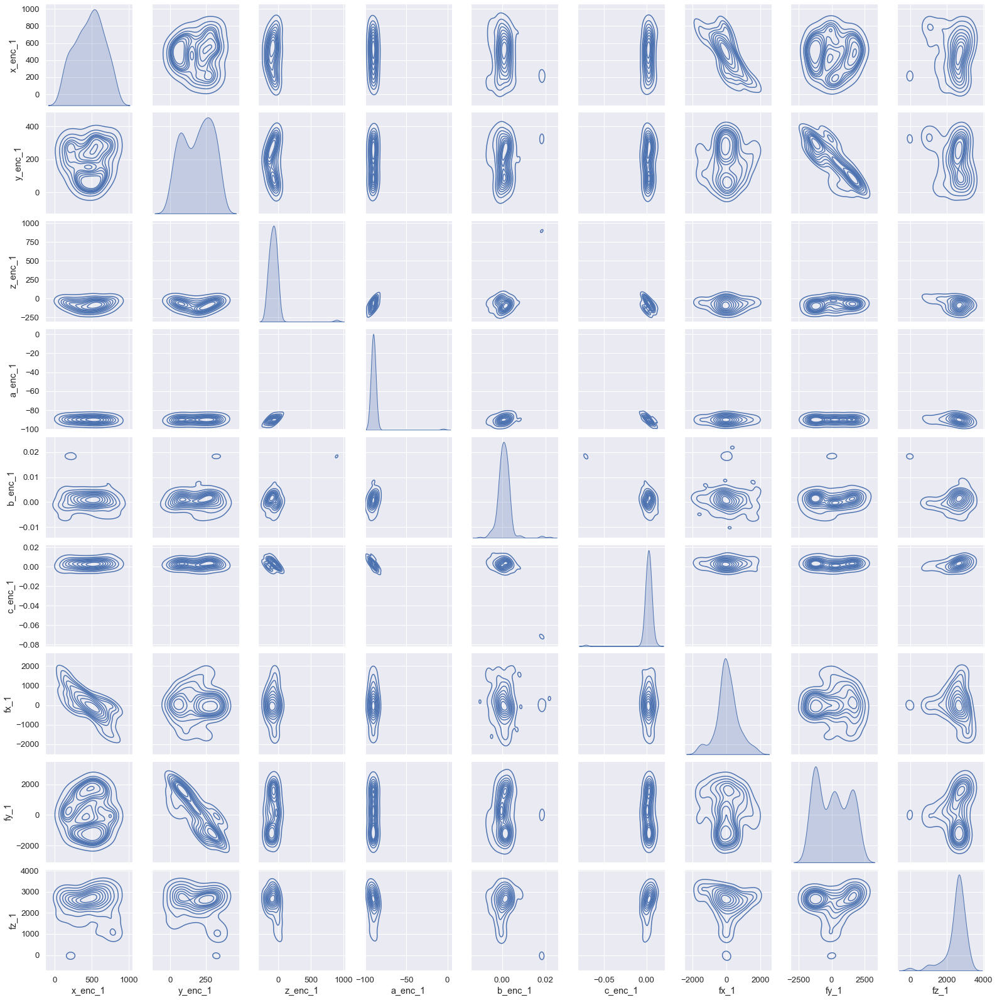

<Figure size 1440x1440 with 0 Axes>

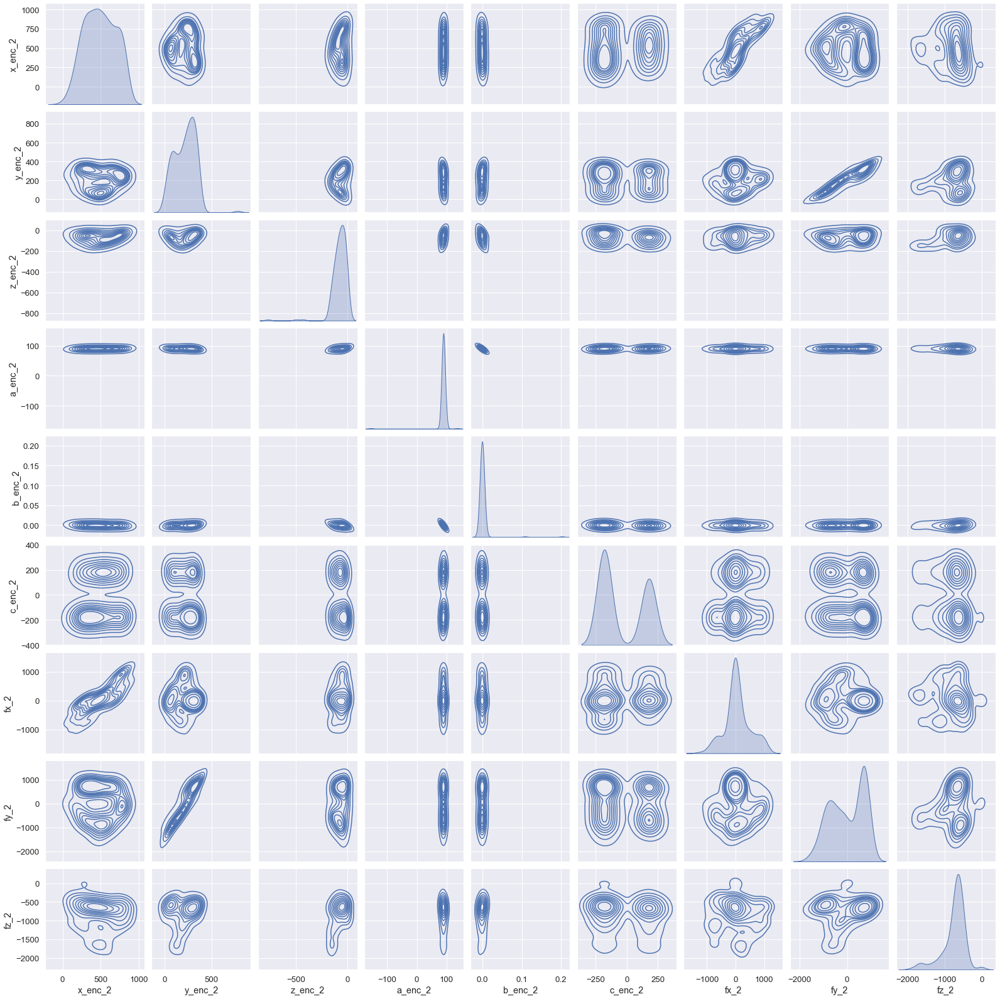

In [6]:
# pair plots (slow...)
labels = [features_1+outputs_1, features_2+outputs_2]
for robot_idx in range(2):
    fig = plt.figure(figsize=(20, 20))
    sns.pairplot(datasets[0].sample(200)[labels[robot_idx]], kind='kde')
    plt.savefig(output_dir/'pairplot_robot{}.pdf'.format(robot_idx+1))

#### Plot correlation matrices

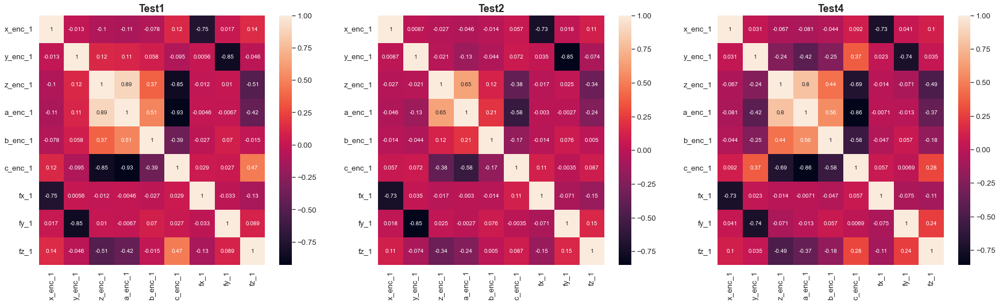

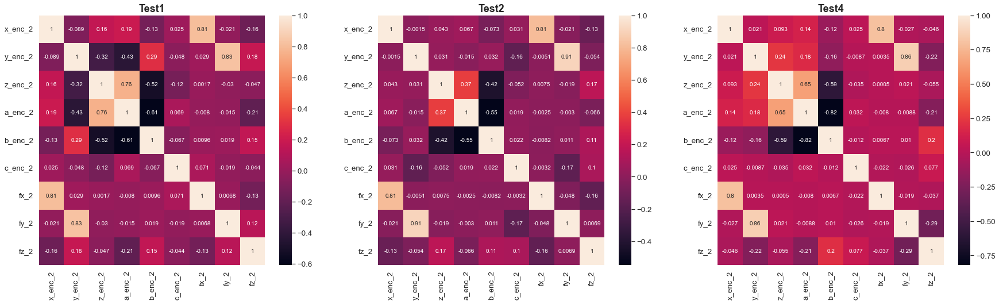

In [7]:
sns.set_style("whitegrid")
labels = [features_1+outputs_1, features_2+outputs_2]
for robot_idx in range(2):
    fig = plt.figure(figsize=(10*len(datasets), 8))
    for i,df in enumerate(datasets):
        corr = df[labels[robot_idx]].corr()
        ax = fig.add_subplot(1, len(datasets), i+1)
        ax.set_title(dataset_filenames[i], weight='bold').set_fontsize('18')
        sns.heatmap(corr, annot=True)
    plt.savefig(output_dir/'corr_robot{}.pdf'.format(robot_idx+1))

**Observations:**
- Forces $f_x$ and $f_y$ are strongly correlated with positions $x$ and $y$ respectively and relatively weakly related to anything else. 
- $f_z$ is mainly correlated to $z$, but also quite strongly correlated with $a$ (roll) and $c$ (yaw), especially for R1.


### Now let's look at correlations between R1 and R2

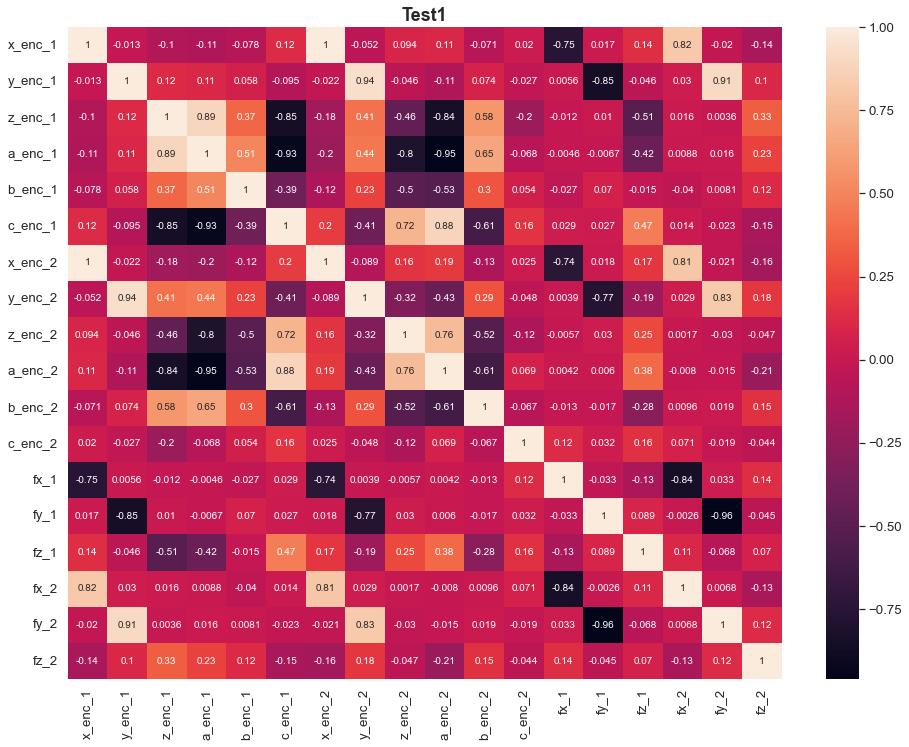

In [8]:
dataset_idx = 0 # Test1
labels = features_1+features_2+outputs_1+outputs_2
fig = plt.figure(figsize=(16, 12))
corr = datasets[dataset_idx][labels].corr()
ax = fig.add_subplot(111)
ax.set_title(dataset_filenames[dataset_idx], weight='bold').set_fontsize('18')
sns.set_style("whitegrid")
sns.heatmap(corr, annot=True)
plt.savefig(output_dir/'corr_{}_both_robots.pdf'.format(dataset_filenames[dataset_idx]))

**Observations:**
- Strong correlations between $x_1$, $x_2$, $f_{x_1}$, and $f_{x_2}$ and between $y_1$, $y_2$, $f_{y_1}$, and $f_{y_2}$ which seems reasonable given the motion of the two robots.
- Relatively weak correlation between $f_{z_1}$ and $f_{z_2}$. Forces in $z$ have quite strong correlation to $a,b$, and $c$.


## 2.2. Time series plots


#### Plot varables in dataset to see what things look like

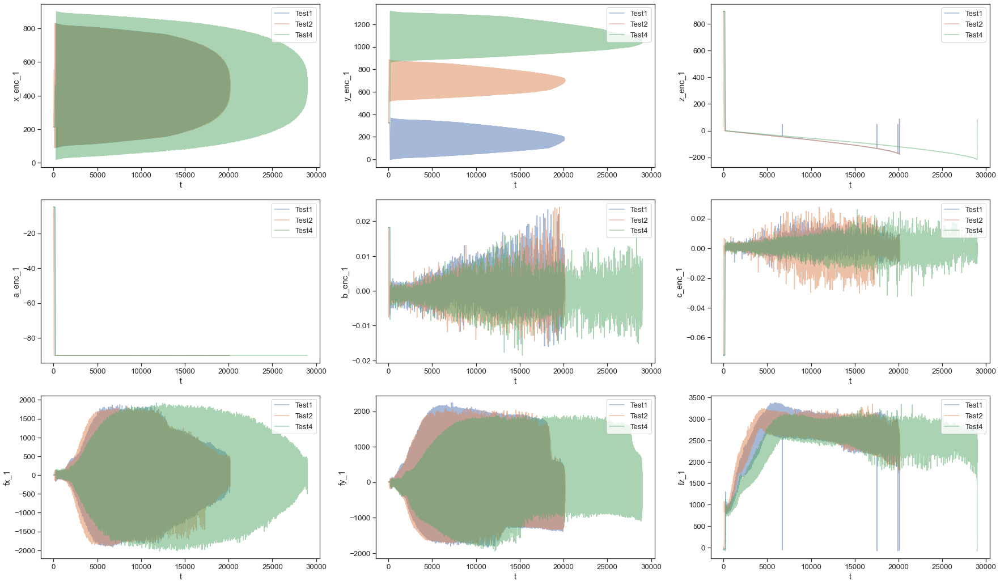

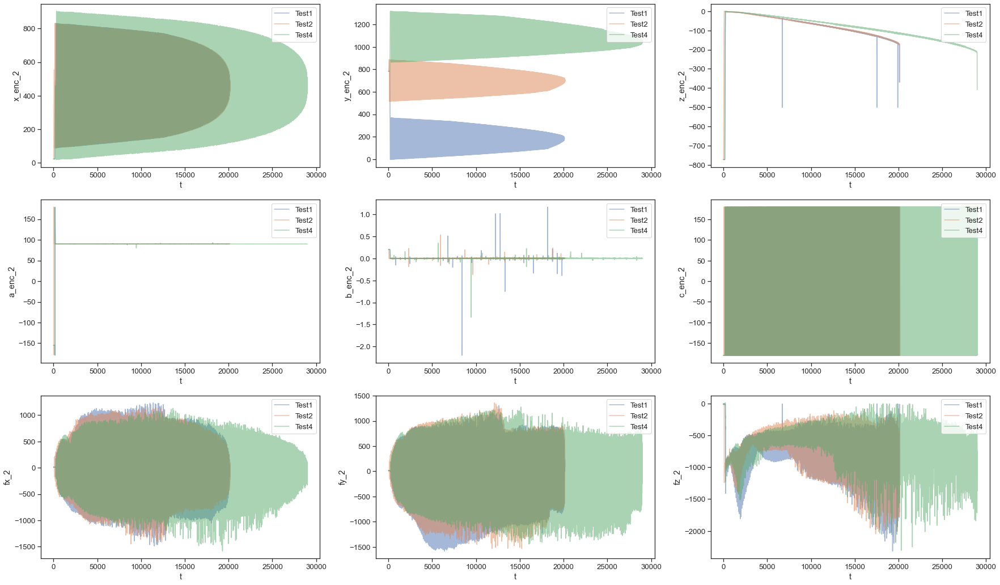

In [9]:
sns.set_style("ticks")
variables_to_plot = [i+'_enc' for i in 'xyzabc'] + ['fx', 'fy', 'fz']
for robot_idx in range(2):
    fig = plt.figure(figsize=(30,18))
    for i,k in enumerate(variables_to_plot):
        k += '_{}'.format(robot_idx+1)
        ax = fig.add_subplot(3,3, i+1)
        for j in range(len(datasets)):
            # shift 't' to start at 0 for each dataset
            ax.plot(datasets[j]['t']-min(datasets[j]['t']), datasets[j][k], label=dataset_filenames[j], alpha=0.5)
        ax.set_xlabel('t', y=0.5)
        ax.set_ylabel(k, y=0.5)
        ax.legend(loc=1)
    fig.savefig(output_dir/'1d_plot_variables_vs_time_robot{}.pdf'.format(robot_idx+1))

## 2.3. Histograms 

#### Make histograms of varables in dataset

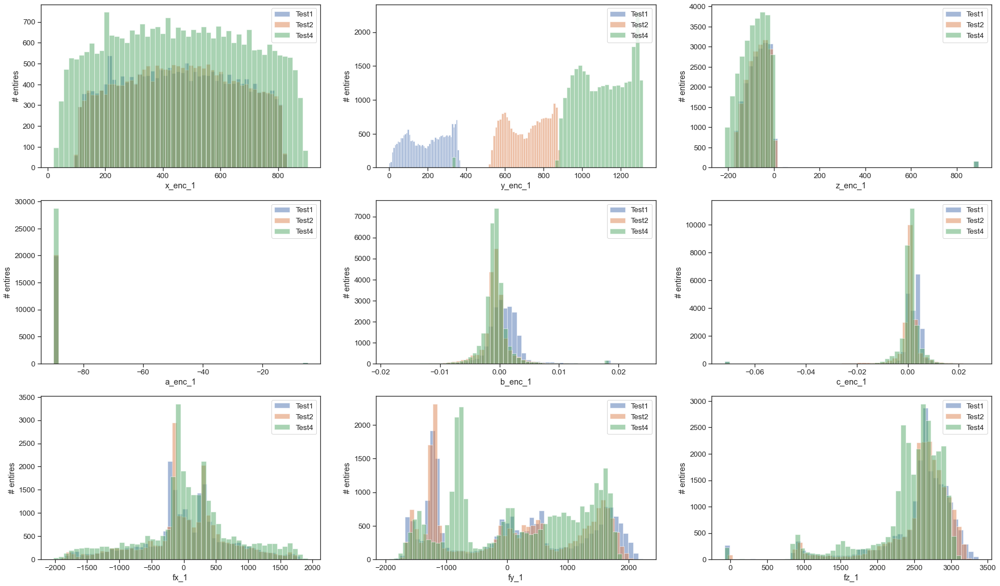

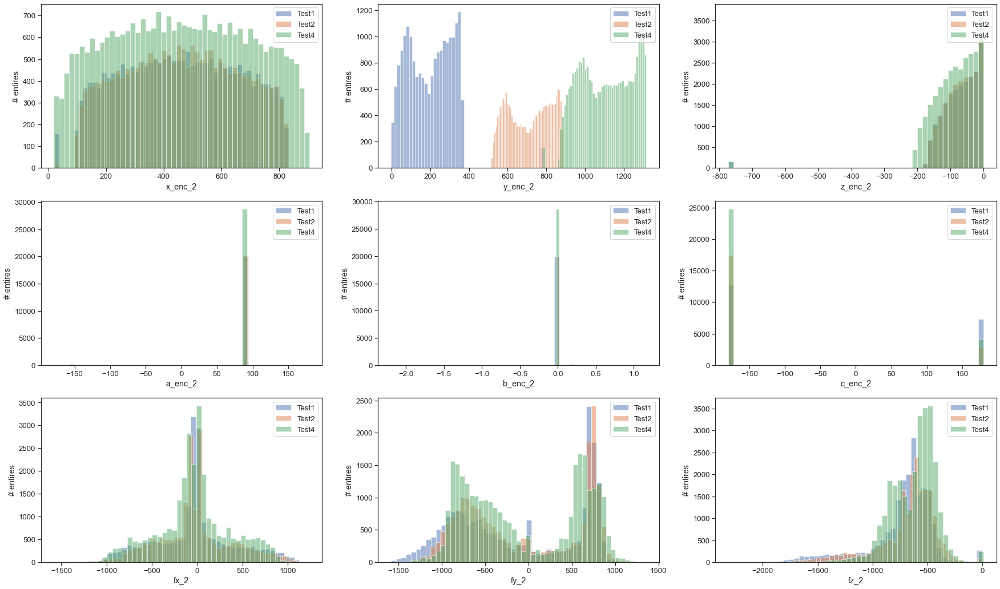

In [10]:
sns.set_style("ticks")
variables_to_plot = [i+'_enc' for i in 'xyzabc'] + ['fx', 'fy', 'fz']
for robot_idx in range(2):
    fig = plt.figure(figsize=(30,18))
    for i,k in enumerate(variables_to_plot):
        k += '_{}'.format(robot_idx+1)
        ax = fig.add_subplot(3,3, i+1)
        for j in range(len(datasets)):
            ax.hist(datasets[j][k], label=dataset_filenames[j], bins=50, alpha=0.5)
        ax.set_xlabel(k, y=0.5)
        ax.set_ylabel('# entires', y=0.5)
        ax.legend(loc=1)
    fig.savefig(output_dir/'1d_hist_variables_vs_time_robot{}.pdf'.format(robot_idx+1))

# 3. Pre-processing

## 3.1. Addition of higher-order derivatives of input features

I noticed that the models could more accurately predict forces from motion in datasets not seen during training when adding higher-order derivatives of the position coordinates as input features.

First (velocity) and second (acceleration) order derivatives had a notable effect on the performance (more about that in section 4). I also tried to include up to 6th order derivatives (3rd=jerk, 4th=snap, 5th=crackle, 6th=pop) [1]. These had a smaller impact but did help in some cases.

[1] https://en.wikipedia.org/wiki/Fourth,_fifth,_and_sixth_derivatives_of_position

In [11]:
# differentiate variables in dataframe
def add_gradients(df, keys_to_diff, nth_order=1):
    for k in keys_to_diff:
        df['d'+str(nth_order)+'_'+re.sub('d\d_','', k)] = np.gradient(df[k])

In [12]:
# add derivatives of position and euler angles:
# 1=velocity, 2=acceleration, 3=jerk, 4=snap, 5=crackle, 6=pop
nth_order = 6
features_to_diff = features
for n in range(1, nth_order+1):
    for df in datasets:
        add_gradients(df, features_to_diff, n)
    features_to_diff = [k for k in datasets[0].keys() if re.search('^d{:d}'.format(n), k)]

#### Create feature lists

In [13]:
# x-axis only
features_x1 = ['x_enc_1'] + ["d{:d}_x_enc_1".format(i) for i in range(1,7)]
features_x2 = ['x_enc_2'] + ["d{:d}_x_enc_2".format(i) for i in range(1,7)]
outputs_x1 = ['fx_1']
outputs_x2 = ['fx_2']

In [14]:
def generate_feature_list(arm_idx, nth_order=6):
    features = []
    for i in 'xyzabc':
        features.append('{}_enc_{}'.format(i, arm_idx))
    for i in 'xyzabc':
        for j in range(1,nth_order+1):
            features.append('d{}_{}_enc_{}'.format(j, i, arm_idx))
    return features

In [15]:
# up to 6th order derivatives (velocity, acceleration, jerk, snap, crackle, pop)
features_1_nth = generate_feature_list(1, nth_order)
features_2_nth = generate_feature_list(2, nth_order)

# up to 2nd order derivatives (velocity, acceleration)
features_1_2nd = generate_feature_list(1, 2)
features_2_2nd = generate_feature_list(2, 2)

outputs_1 = ['fx_1', 'fy_1', 'fz_1']
outputs_2 = ['fx_2', 'fy_2', 'fz_2']

### Correlations to higher order derivatives

#### $x$-axis only

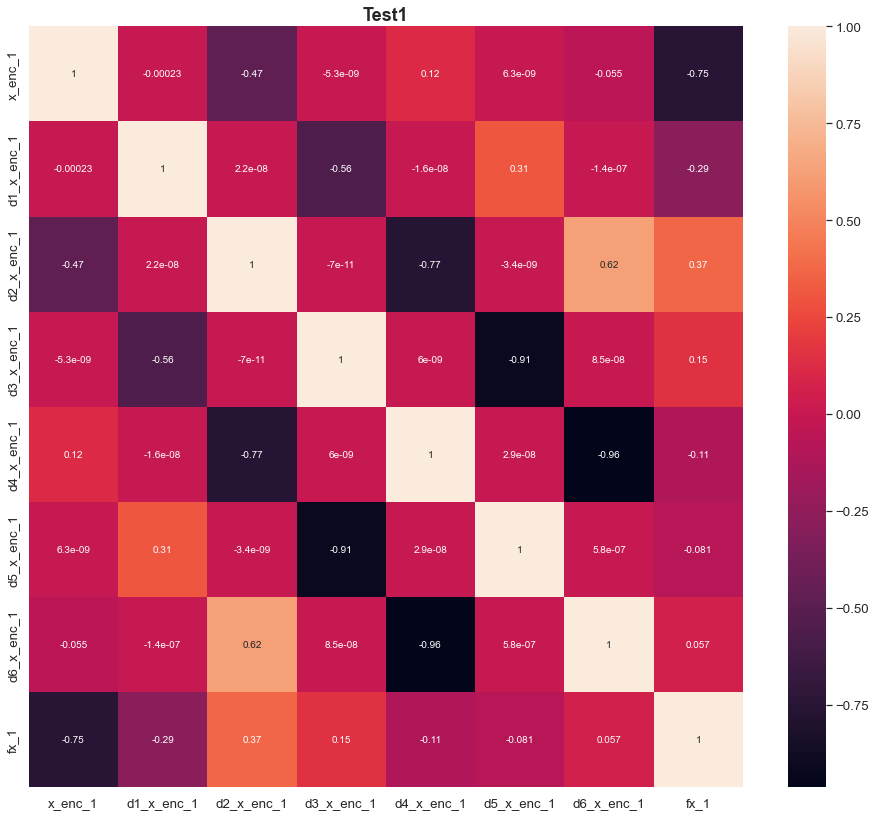

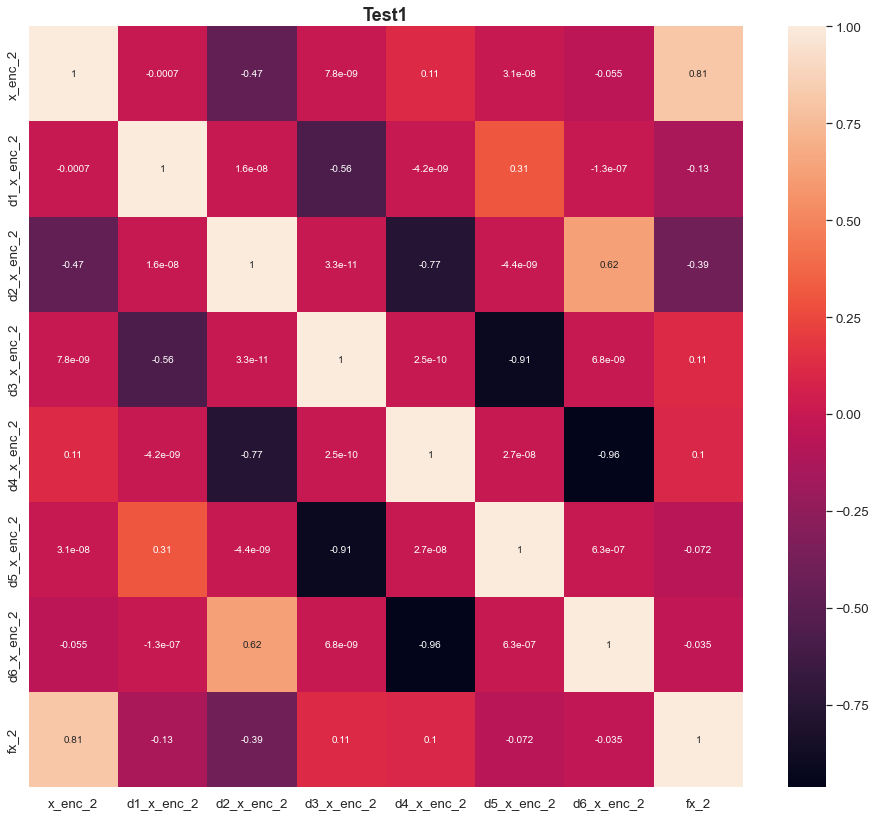

In [16]:
idx = 0 # Test1
labels = [features_x1+outputs_x1, features_x2+outputs_x2]
sns.set_style("whitegrid")
for robot_idx in range(2):
    fig = plt.figure(figsize=(16, 14))
    corr = datasets[idx][labels[robot_idx]].corr()
    ax = fig.add_subplot(111)
    ax.set_title(dataset_filenames[idx], weight='bold').set_fontsize('18')
    sns.heatmap(corr, annot=True)
    plt.savefig(output_dir/'corr_derivatives_x_robot{}.pdf'.format(robot_idx+1))

#### All coordinates

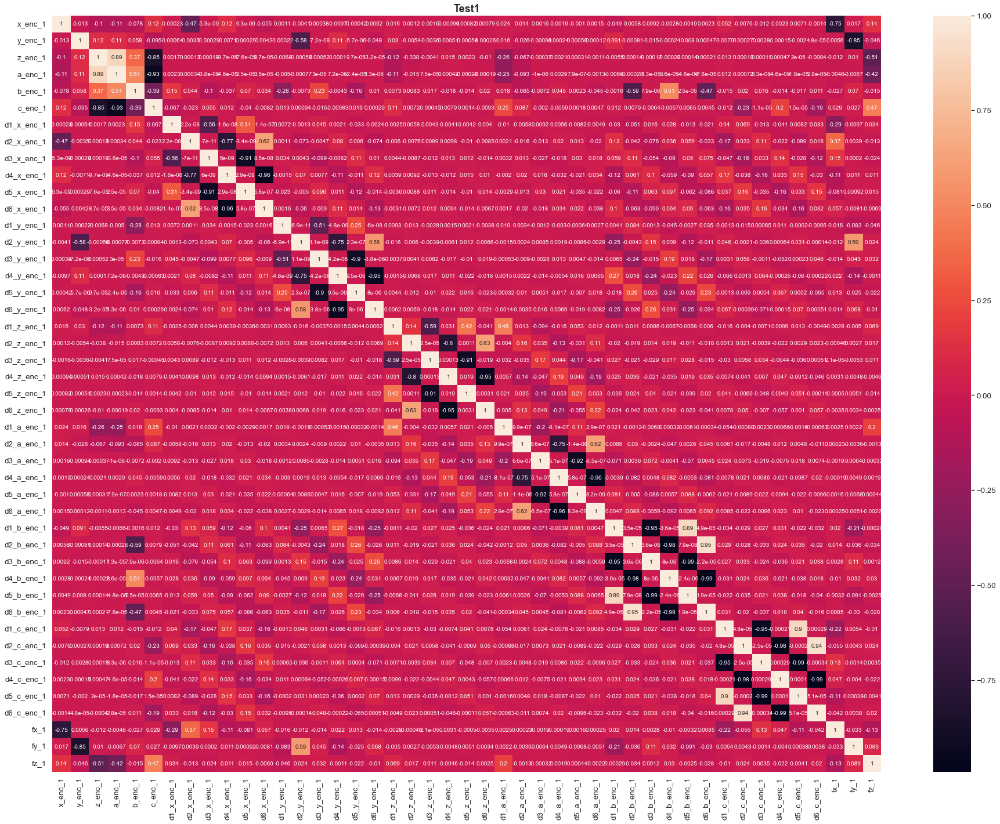

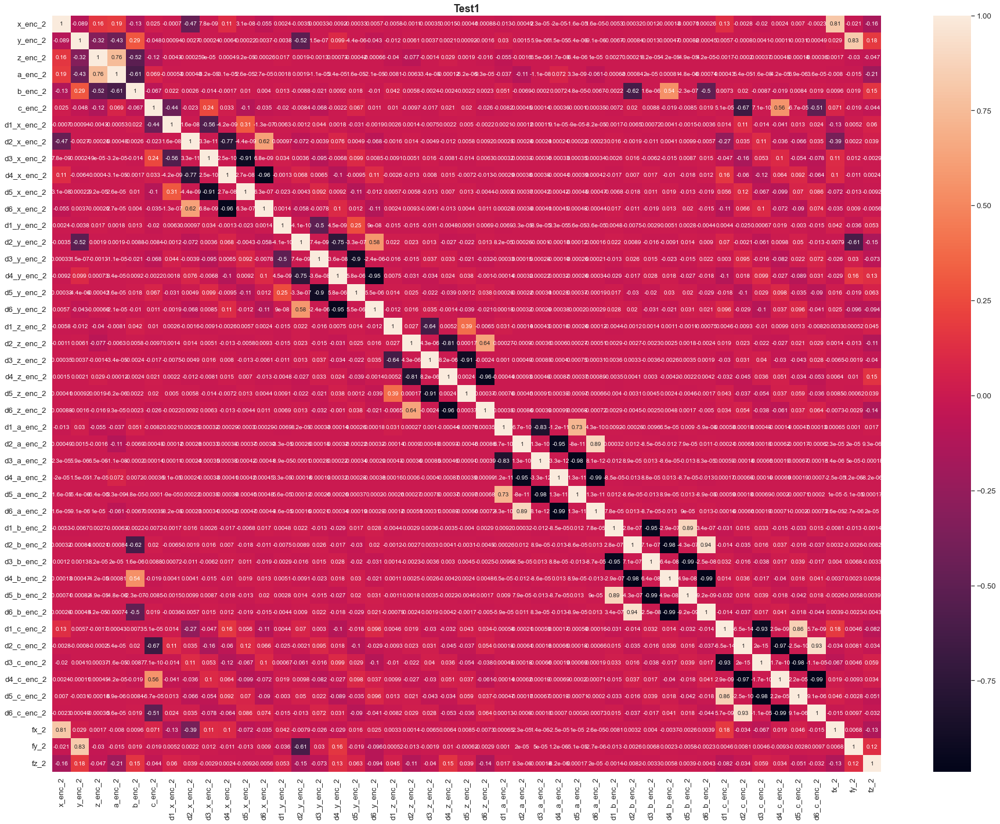

In [17]:
idx = 0 # Test1
labels = [features_1_nth+outputs_1, features_2_nth+outputs_2]
sns.set_style("whitegrid")
for robot_idx in range(2):
    fig = plt.figure(figsize=(32, 24))
    corr = datasets[idx][labels[robot_idx]].corr()
    ax = fig.add_subplot(111)
    ax.set_title(dataset_filenames[idx], weight='bold').set_fontsize('18')
    sns.heatmap(corr, annot=True)
    plt.savefig(output_dir/'corr_derivatives_all_robot{}.pdf'.format(robot_idx+1))

## 3.2. Scaling of input features and outputs

### Specify which datasets to use
Hold out 'Test2' for testing of model trained on data from 'Test1' and 'Test4'.

In [18]:
df1 = datasets[0] # Test1
df2 = datasets[1] # Test2
df4 = datasets[2] # Test4
df = df1.copy()
#df = df.append(datasets[1])
df = df.append(datasets[2])

#### Split dataframe into X (features) and Y (outputs)

In [19]:
features_nth = features_1_nth + features_2_nth
features_2nd = features_1_2nd + features_2_2nd
X = df[features_nth].to_numpy()
Y = df[outputs].to_numpy()
print(X.shape, Y.shape)

(49078, 84) (49078, 6)


#### Feature scaling
Both MinMaxScaler and StandardScaler were tried, the former gave slightly more robust performance.

In [20]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
#scaler_x = StandardScaler()
#scaler_y = StandardScaler()
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()
X_normed = scaler_x.fit_transform(X)
Y_normed = scaler_y.fit_transform(Y)

In [21]:
# sanity check
print(X[0:5,0])
print(X_normed[0:5,0])
print(scaler_x.inverse_transform(X_normed)[0:4,0])

[213.6337 213.6337 213.6337 213.6337 213.6337]
[0.21954808 0.21954808 0.21954808 0.21954808 0.21954808]
[213.6337 213.6337 213.6337 213.6337]


## 3.3. Preparing input features for RNN training

Including multiple time steps of the input features and training an RNN to predict forces improved the performance over using a DNN. After some experimentation, I concluded that about 20 timesteps worked pretty well.

In [22]:
def split_sequences(X, Y, n_steps):
    X_seq, Y_seq = list(), list()
    for i in range(len(X)):
        end_i = i + n_steps
        if end_i > len(X):
            break
        Xi, yi = X[i:end_i, :], Y[end_i-1, :]
        X_seq.append(Xi)
        Y_seq.append(yi)
    return (np.array(X_seq), np.array(Y_seq))

In [23]:
# prepare sequences for RNN with 20 time steps
n_steps = 20
X_seq, Y_seq = split_sequences(X_normed, Y_normed, n_steps)
print(X_seq.shape, Y_seq.shape)

(49059, 20, 84) (49059, 6)


## 3.4. Splitting of data into train/validation/test sets


In [24]:
from sklearn.model_selection import train_test_split
# if False: keep last events for testing
shuffle = True
# 70-10-20 train-validation-test split
train_frac = 0.7
val_frac = 0.1

# for dnn
X_train, X_val_test, Y_train, Y_val_test = train_test_split(X_normed, Y_normed, train_size = train_frac, shuffle=shuffle)
X_val, X_test, Y_val, Y_test = train_test_split(X_val_test, Y_val_test, test_size = 1.0-val_frac/(1.0-train_frac), shuffle=False)

print(X_train.shape, Y_train.shape)
print(X_val.shape, Y_val.shape)
print(X_test.shape, Y_test.shape)

# for rnn
X_seq_train, X_seq_val_test, Y_seq_train, Y_seq_val_test = train_test_split(X_seq, Y_seq, train_size = train_frac, shuffle=shuffle)
X_seq_val, X_seq_test, Y_seq_val, Y_seq_test = train_test_split(X_seq_val_test, Y_seq_val_test, test_size = 1.0-val_frac/(1.0-train_frac), shuffle=False)

print(X_seq_train.shape, Y_seq_train.shape)
print(X_seq_val.shape, Y_seq_val.shape)
print(X_seq_test.shape, Y_seq_test.shape)

(34354, 84) (34354, 6)
(4907, 84) (4907, 6)
(9817, 84) (9817, 6)
(34341, 20, 84) (34341, 6)
(4905, 20, 84) (4905, 6)
(9813, 20, 84) (9813, 6)


#### Create train/val/test sets with 12 (positions and angles) and 36 input features (positions, angles, and up to 2nd order derivatives)

In [25]:
# sanity check
print(features)
print(features_2nd)
print(outputs)

['x_enc_1', 'y_enc_1', 'z_enc_1', 'a_enc_1', 'b_enc_1', 'c_enc_1', 'x_enc_2', 'y_enc_2', 'z_enc_2', 'a_enc_2', 'b_enc_2', 'c_enc_2']
['x_enc_1', 'y_enc_1', 'z_enc_1', 'a_enc_1', 'b_enc_1', 'c_enc_1', 'd1_x_enc_1', 'd2_x_enc_1', 'd1_y_enc_1', 'd2_y_enc_1', 'd1_z_enc_1', 'd2_z_enc_1', 'd1_a_enc_1', 'd2_a_enc_1', 'd1_b_enc_1', 'd2_b_enc_1', 'd1_c_enc_1', 'd2_c_enc_1', 'x_enc_2', 'y_enc_2', 'z_enc_2', 'a_enc_2', 'b_enc_2', 'c_enc_2', 'd1_x_enc_2', 'd2_x_enc_2', 'd1_y_enc_2', 'd2_y_enc_2', 'd1_z_enc_2', 'd2_z_enc_2', 'd1_a_enc_2', 'd2_a_enc_2', 'd1_b_enc_2', 'd2_b_enc_2', 'd1_c_enc_2', 'd2_c_enc_2']
['fx_1', 'fy_1', 'fz_1', 'fx_2', 'fy_2', 'fz_2']


In [26]:
# indices of 12 position input features
feature_idx = [df[features_nth].columns.get_loc(col) for col in features]
# indices of position, velocity, and acceleration input features
feature_idx_2nd = [df[features_nth].columns.get_loc(col) for col in features_2nd]
# indices of all features
feature_idx_nth = [df[features_nth].columns.get_loc(col) for col in features_nth]

In [27]:
# sanity check
print(df[features][4000:4001].to_numpy())
print(scaler_x.inverse_transform(X_normed)[:,feature_idx][4000:4001,:])

[[ 7.01138030e+02  9.05163185e+01 -2.66579203e+01 -8.99984769e+01
  -4.16576996e-04  2.06331677e-03  7.04664055e+02  8.46991898e+01
  -2.02531592e+01  8.99942266e+01 -2.56791472e-04 -1.79998530e+02]]
[[ 7.01138030e+02  9.05163185e+01 -2.66579203e+01 -8.99984769e+01
  -4.16576996e-04  2.06331677e-03  7.04664055e+02  8.46991898e+01
  -2.02531593e+01  8.99942266e+01 -2.56791472e-04 -1.79998530e+02]]


In [28]:
# select 12 input features: x,y,z,a,b,c for robots 1 and 2
X_train_12 = X_train[:,feature_idx]
X_val_12 = X_val[:,feature_idx]
X_test_12 = X_test[:,feature_idx]

X_seq_train_12 = X_seq_train[:,:,feature_idx]
X_seq_val_12 = X_seq_val[:,:,feature_idx]
X_seq_test_12 = X_seq_test[:,:,feature_idx]

# select 36 input features: x,y,z,a,b,c + 1st and 2nd order derivatives for robots 1 and 2
X_train_36 = X_train[:,feature_idx_2nd]
X_val_36 = X_val[:,feature_idx_2nd]
X_test_36 = X_test[:,feature_idx_2nd]

X_seq_train_36 = X_seq_train[:,:,feature_idx_2nd]
X_seq_val_36 = X_seq_val[:,:, feature_idx_2nd]
X_seq_test_36 = X_seq_test[:,:,feature_idx_2nd]

In [29]:

# sanity check
print(X_train_12.shape)
print(X_seq_train_12.shape)

print(X_train_36.shape)
print(X_seq_train_36.shape)

(34354, 12)
(34341, 20, 12)
(34354, 36)
(34341, 20, 36)


# 4. Modeling

Finally, we're getting to the exciting part of training some neural nets.

In [165]:
# function to plot loss, to be used several times below
def plot_loss(history, name, title=''):
    fig = plt.figure(figsize=(24,10))
    fig.suptitle(title)
    
    # full range
    ax = fig.add_subplot(121)
    ax.plot(history.history['loss'], label='loss')
    ax.plot(history.history['val_loss'], label='val_loss')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Error')
    ax.legend()
    ax.grid(True)
    
    # last 30 percent of epochs
    zoom_frac = 0.7
    nepochs = len(history.history['loss'])
    ax = fig.add_subplot(122)
    ax.plot(history.history['loss'], label='loss')
    ax.plot(history.history['val_loss'], label='val_loss')
    xmin = int(zoom_frac*nepochs)
    xmax = nepochs
    ax.set_xlim([xmin, xmax])
    ymin = 0.99*np.min(history.history['loss'][int(zoom_frac*nepochs):]
                      + history.history['val_loss'][int(zoom_frac*nepochs):])
    ymax = 1.01*np.max(history.history['loss'][int(zoom_frac*nepochs):] 
                      + history.history['val_loss'][int(zoom_frac*nepochs):])
    ax.set_ylim([ymin, ymax])
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Error')
    ax.legend()
    ax.grid(True)
    
    plt.savefig(output_dir/name)


In [142]:
# for comparing test results of different models
test_results = dict()

## 4.1. Linear Regression
Let's start with a simple linear regression.

### Predict $f_{x_1}$ from $x_1$

In [32]:
x1_train = X_train[:,0].reshape(len(X_train),1)
fx1_train = Y_train[:,0].reshape(len(Y_train),1)
x1_val = X_val[:,0].reshape(len(X_val),1)
fx1_val = Y_val[:,0].reshape(len(Y_val),1)
x1_test = X_test[:,0].reshape(len(X_test),1)
fx1_test = Y_test[:,0].reshape(len(Y_test),1)

In [33]:
linear_model_x1 = keras.experimental.LinearModel()
linear_model_x1.compile(optimizer='adam', loss='mean_squared_error')
history_linear_x1 = linear_model_x1.fit(
    x1_train, fx1_train, 
    validation_data=(x1_val, fx1_val),
    batch_size = 32,
    epochs=40)
with open(output_dir/'history_linear_x1.pickle', 'wb') as f:
    pickle.dump(history_linear_x1.history, f)


Epoch 1/40
1074/1074 [==============================] - 2s 932us/step - loss: 0.0849 - val_loss: 0.0388
Epoch 2/40
1074/1074 [==============================] - 1s 908us/step - loss: 0.0279 - val_loss: 0.0192
Epoch 3/40
1074/1074 [==============================] - 1s 897us/step - loss: 0.0166 - val_loss: 0.0152
Epoch 4/40
1074/1074 [==============================] - 1s 922us/step - loss: 0.0150 - val_loss: 0.0150
Epoch 5/40
1074/1074 [==============================] - 1s 844us/step - loss: 0.0149 - val_loss: 0.0150
Epoch 6/40
1074/1074 [==============================] - 1s 754us/step - loss: 0.0149 - val_loss: 0.0150
Epoch 7/40
1074/1074 [==============================] - 1s 771us/step - loss: 0.0149 - val_loss: 0.0150
Epoch 8/40
1074/1074 [==============================] - 1s 797us/step - loss: 0.0149 - val_loss: 0.0150
Epoch 9/40
1074/1074 [==============================] - 1s 860us/step - loss: 0.0149 - val_loss: 0.0150
Epoch 10/40
1074/1074 [==============================] - 1s 870u

#### Plot loss vs. epoch

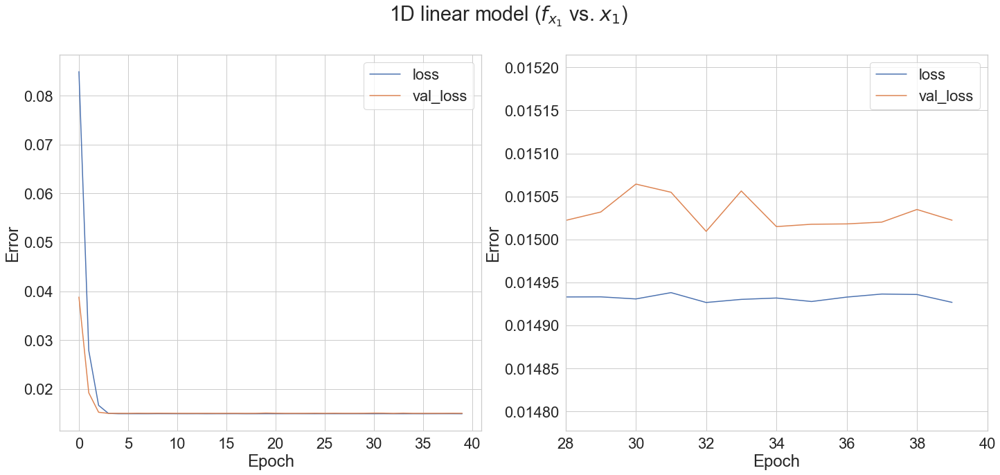

In [166]:
plot_loss(history_linear_x1, 'loss_linear_x1.pdf', '1D linear model ($f_{x_1}$ vs. $x_1$)')

In [35]:
# save model loss on test set for evaluation section below
test_results['linear_x1'] = linear_model_x1.evaluate(x1_test, fx1_test, verbose=0)

#### Plot predictions vs. true values

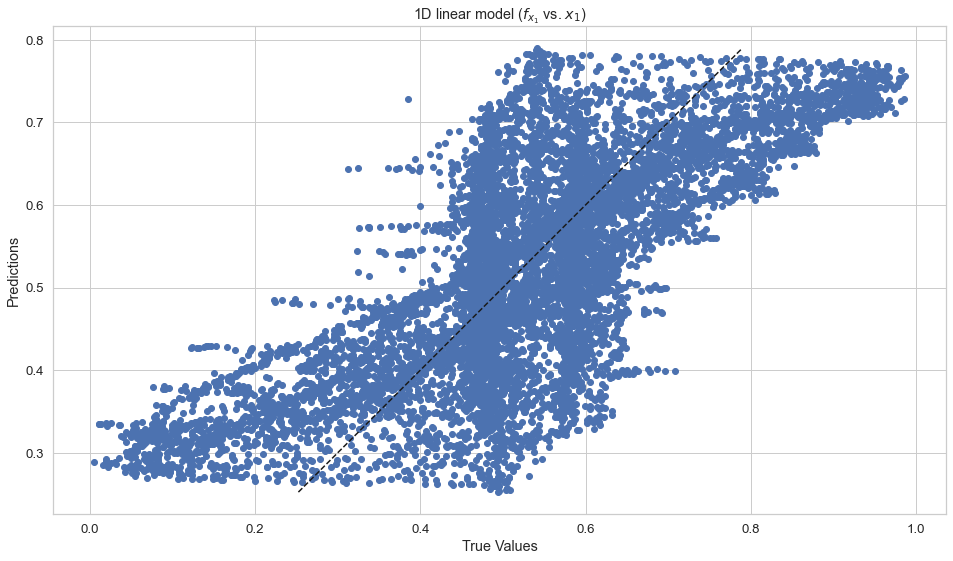

In [36]:
fx1_test_pred = linear_model_x1.predict(x1_test)
fig = plt.figure(figsize=(16,10))
ax = fig.add_subplot(111, aspect='equal')
ax.scatter(fx1_test, fx1_test_pred)
ax.plot([np.min(fx1_test_pred), np.max(fx1_test_pred)], [np.min(fx1_test_pred), np.max(fx1_test_pred)], linestyle='dashed', label='Predictions', color='k')
#ax.plot([0.2, 0.8], [0.2, 0.8], linestyle='dashed', label='Predictions', color='k')
ax.set_xlabel('True Values')
ax.set_ylabel('Predictions')
ax.set_title('1D linear model ($f_{x_1}$ vs. $x_1$)')
plt.savefig(output_dir/'pred_vs_true_linear_x1.pdf')

#### Plot $f_{x_1}$ vs. $x_1$ (scaled)

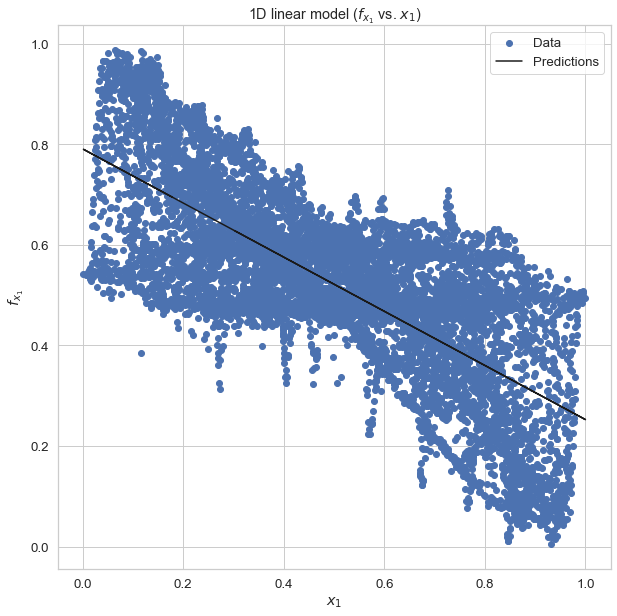

In [37]:
fig = plt.figure(figsize=(16,10))
ax = fig.add_subplot(111, aspect='equal')
ax.scatter(x1_test, fx1_test, label='Data')
ax.plot(x1_test, fx1_test_pred, label='Predictions', color='k')
ax.set_xlabel('$x_{1}$')
ax.set_ylabel('$f_{x{_1}}$')
ax.set_title('1D linear model ($f_{x_1}$ vs. $x_1$)')
ax.legend()
plt.savefig(output_dir/'linear_fx1_vs_x1.pdf')

### Predict all 6 forces from 12 input features

In [38]:
linear_model_12 = keras.experimental.LinearModel(units=6)
linear_model_12.compile(optimizer='adam', loss='mean_squared_error')
history_linear_12 = linear_model_12.fit(
    X_train_12, Y_train, 
    validation_data=(X_val_12, Y_val),
    batch_size = 32,
    epochs=200)
with open(output_dir/'history_linear_12.pickle', 'wb') as f:
    pickle.dump(history_linear_12.history, f)

Epoch 1/200
1074/1074 [==============================] - 1s 874us/step - loss: 0.0454 - val_loss: 0.0302
Epoch 2/200
1074/1074 [==============================] - 1s 792us/step - loss: 0.0295 - val_loss: 0.0295
Epoch 3/200
1074/1074 [==============================] - 1s 807us/step - loss: 0.0292 - val_loss: 0.0292
Epoch 4/200
1074/1074 [==============================] - 1s 863us/step - loss: 0.0290 - val_loss: 0.0290
Epoch 5/200
1074/1074 [==============================] - 1s 803us/step - loss: 0.0289 - val_loss: 0.0291
Epoch 6/200
1074/1074 [==============================] - 1s 822us/step - loss: 0.0289 - val_loss: 0.0290
Epoch 7/200
1074/1074 [==============================] - 1s 817us/step - loss: 0.0288 - val_loss: 0.0289
Epoch 8/200
1074/1074 [==============================] - 1s 842us/step - loss: 0.0288 - val_loss: 0.0290
Epoch 9/200
1074/1074 [==============================] - 1s 804us/step - loss: 0.0288 - val_loss: 0.0289
Epoch 10/200
1074/1074 [==============================]

1074/1074 [==============================] - 1s 761us/step - loss: 0.0280 - val_loss: 0.0282
Epoch 79/200
1074/1074 [==============================] - 1s 755us/step - loss: 0.0280 - val_loss: 0.0282
Epoch 80/200
1074/1074 [==============================] - 1s 791us/step - loss: 0.0280 - val_loss: 0.0281
Epoch 81/200
1074/1074 [==============================] - 1s 775us/step - loss: 0.0280 - val_loss: 0.0280
Epoch 82/200
1074/1074 [==============================] - 1s 798us/step - loss: 0.0280 - val_loss: 0.0281
Epoch 83/200
1074/1074 [==============================] - 1s 803us/step - loss: 0.0280 - val_loss: 0.0281
Epoch 84/200
1074/1074 [==============================] - 1s 812us/step - loss: 0.0280 - val_loss: 0.0280
Epoch 85/200
1074/1074 [==============================] - 1s 819us/step - loss: 0.0280 - val_loss: 0.0281
Epoch 86/200
1074/1074 [==============================] - 1s 823us/step - loss: 0.0279 - val_loss: 0.0281
Epoch 87/200
1074/1074 [==============================] - 1

Epoch 155/200
1074/1074 [==============================] - 1s 799us/step - loss: 0.0274 - val_loss: 0.0276
Epoch 156/200
1074/1074 [==============================] - 1s 792us/step - loss: 0.0274 - val_loss: 0.0276
Epoch 157/200
1074/1074 [==============================] - 1s 824us/step - loss: 0.0274 - val_loss: 0.0275
Epoch 158/200
1074/1074 [==============================] - 1s 800us/step - loss: 0.0274 - val_loss: 0.0276
Epoch 159/200
1074/1074 [==============================] - 1s 793us/step - loss: 0.0274 - val_loss: 0.0275
Epoch 160/200
1074/1074 [==============================] - 1s 800us/step - loss: 0.0274 - val_loss: 0.0276
Epoch 161/200
1074/1074 [==============================] - 1s 791us/step - loss: 0.0274 - val_loss: 0.0276
Epoch 162/200
1074/1074 [==============================] - 1s 820us/step - loss: 0.0274 - val_loss: 0.0274
Epoch 163/200
1074/1074 [==============================] - 1s 623us/step - loss: 0.0274 - val_loss: 0.0274
Epoch 164/200
1074/1074 [============

#### Plot loss vs. epoch

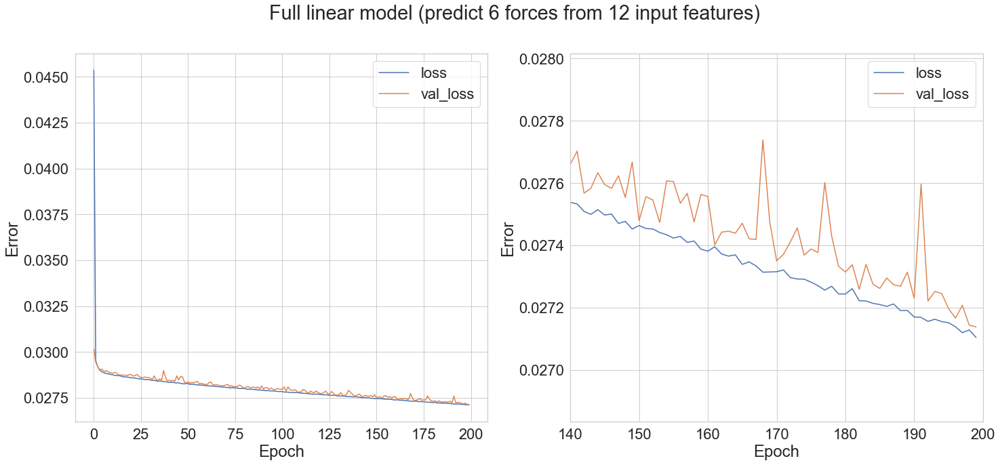

In [167]:
plot_loss(history_linear_12, 'loss_linear_12.pdf', 'Full linear model (predict 6 forces from 12 input features)')

In [40]:
# save model loss on test set for evaluation section below
test_results['linear_12'] = linear_model_12.evaluate(X_test_12, Y_test, verbose=0)

#### Plot predictions vs. true values

In [41]:
def plot_pred_vs_true(pred, true, name, titles=None):
    fig = plt.figure(figsize=(30,16))
    for i in range(len(pred.T)):
        ax = fig.add_subplot(2,3,i+1)
        ax.scatter(true.T[i], pred.T[i])
        ax.plot([np.min(pred), np.max(pred)],[np.min(pred), np.max(pred)], linestyle='dashed', linewidth=2, color='k')
        ax.set_xlabel('True Values')
        ax.set_ylabel('Predictions')
        if len(titles)>=len(pred.T):
            ax.set_title(titles[i])
    plt.savefig(output_dir/'pred_vs_true_{}.pdf'.format(name))

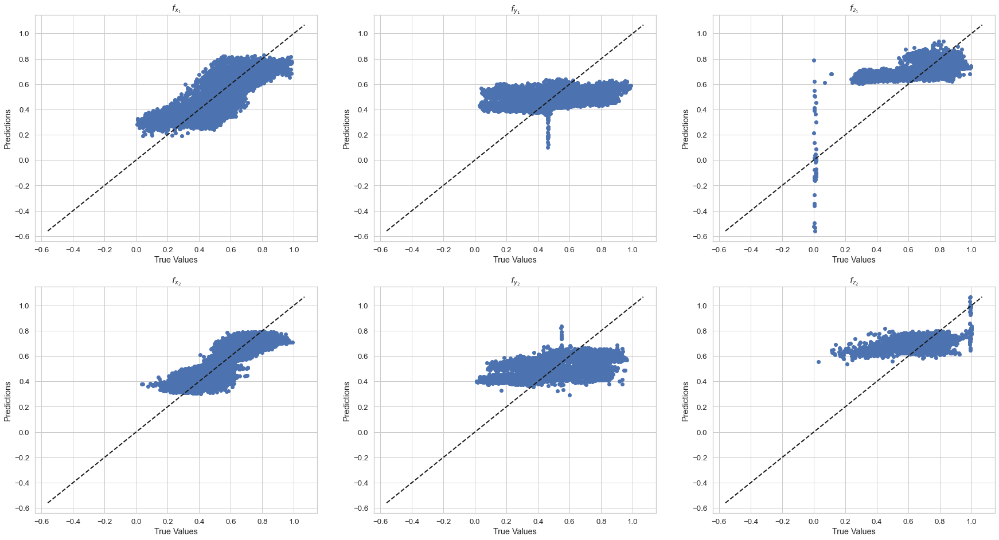

In [42]:
Y_test_pred_linear_12 = linear_model_12.predict(X_test_12)
plot_pred_vs_true(Y_test_pred_linear_12, Y_test, 'pred_vs_true_linear_12', titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

## 4.2. DNN regression

I experimented by varying the number of layers, dropout rate, learning rate, batch size, and adding batch normalization layers—the model below achieves pretty good performance.

In [43]:
# The Sequential model will do just fine here 
# (functional API is more flexible though) 

def setup_dnn_model(n_outputs):
  model = keras.Sequential([
      #layers.BatchNormalization(),
      layers.Dense(200, activation='relu'),
      layers.Dropout(0.05),
      layers.Dense(200, activation='relu'),
      layers.Dropout(0.05),
      layers.Dense(200, activation='relu'),
      layers.Dropout(0.05),
      layers.Dense(100, activation='relu'),
      layers.Dropout(0.05),
      layers.Dense(100, activation='relu'),
      layers.Dense(n_outputs)
  ])

  model.compile(loss='mean_squared_error',
                optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3, decay=5e-6))
  return model

In [44]:
# dnn config
dnn_tag = "dnn_200x3_100x2_05dropout"
dnn_epochs = 1000
dnn_batch_size = 32

### Predict all 6 forces from 12 input features

In [45]:
dnn_model_12 = setup_dnn_model(Y_train.shape[-1])
dnn_model_12_tag = "{}_12features".format(dnn_tag)

In [46]:
\%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'dnn_12_tmp.h5', monitor='val_loss', save_freq='epoch')

history_dnn_12 = dnn_model_12.fit(
    X_train_12, Y_train,
    validation_data=(X_val_12, Y_val),
    batch_size = dnn_batch_size,
    epochs=dnn_epochs,
    callbacks=[save_every_epoch]
    #callbacks=[early_stop, save_every_epoch]
    #verbose=0, 
    )
dnn_model_12.summary()
with open(output_dir/'history_dnn_12.pickle', 'wb') as f:
    pickle.dump(history_dnn_12.history, f)

Epoch 1/1000
1074/1074 [==============================] - 3s 2ms/step - loss: 0.0176 - val_loss: 0.0060
Epoch 2/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0062 - val_loss: 0.0035
Epoch 3/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0043 - val_loss: 0.0029
Epoch 4/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0037 - val_loss: 0.0024
Epoch 5/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0032 - val_loss: 0.0024
Epoch 6/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0031 - val_loss: 0.0023
Epoch 7/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0029 - val_loss: 0.0024
Epoch 8/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0029 - val_loss: 0.0022
Epoch 9/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0027 - val_loss: 0.0023
Epoch 10/1000
1074/1074 [==============================] - 2s 2m

1074/1074 [==============================] - 2s 2ms/step - loss: 0.0015 - val_loss: 0.0014
Epoch 80/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0015 - val_loss: 0.0015
Epoch 81/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 82/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 83/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 84/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0016 - val_loss: 0.0012
Epoch 85/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0014 - val_loss: 0.0012
Epoch 86/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0014 - val_loss: 0.0012
Epoch 87/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 88/1000
1074/1074 [==============================] - 2s 2ms/ste

1074/1074 [==============================] - 3s 2ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 157/1000
1074/1074 [==============================] - 3s 2ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 158/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 159/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0013 - val_loss: 0.0013
Epoch 160/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 161/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 162/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 163/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 164/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 165/1000
1074/1074 [==============================] - 2

1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 234/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 235/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 9.9076e-04
Epoch 236/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 237/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 238/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 239/1000
1074/1074 [==============================] - 3s 2ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 240/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 241/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 242/1000
1074/1074 [==============================]

Epoch 310/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 0.0012
Epoch 311/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 0.0011
Epoch 312/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 9.9203e-04
Epoch 313/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 9.5612e-04
Epoch 314/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.9206e-04 - val_loss: 0.0010
Epoch 315/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 9.9558e-04
Epoch 316/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.9827e-04 - val_loss: 9.8650e-04
Epoch 317/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 0.0011
Epoch 318/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.9265e-04 - val_loss: 9.6848e-04
Epoch 319/1000

1074/1074 [==============================] - 2s 2ms/step - loss: 9.4599e-04 - val_loss: 9.4847e-04
Epoch 384/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.7107e-04 - val_loss: 9.9437e-04
Epoch 385/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.2505e-04 - val_loss: 9.9356e-04
Epoch 386/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.4985e-04 - val_loss: 9.7205e-04
Epoch 387/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.7225e-04 - val_loss: 0.0013
Epoch 388/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.5568e-04 - val_loss: 9.6233e-04
Epoch 389/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.6892e-04 - val_loss: 0.0011
Epoch 390/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.6697e-04 - val_loss: 9.5910e-04
Epoch 391/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.4864e-04 - val_loss: 0.0011
E

Epoch 456/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.1538e-04 - val_loss: 9.4191e-04
Epoch 457/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.1732e-04 - val_loss: 9.3868e-04
Epoch 458/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.0557e-04 - val_loss: 9.4236e-04
Epoch 459/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.1887e-04 - val_loss: 0.0010
Epoch 460/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.0378e-04 - val_loss: 9.7286e-04
Epoch 461/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.1499e-04 - val_loss: 9.2364e-04
Epoch 462/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.0945e-04 - val_loss: 9.4203e-04
Epoch 463/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.3606e-04 - val_loss: 9.9412e-04
Epoch 464/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.2044e-04 -

1074/1074 [==============================] - 2s 2ms/step - loss: 8.8308e-04 - val_loss: 9.2634e-04
Epoch 529/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.9721e-04 - val_loss: 9.5456e-04
Epoch 530/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.8759e-04 - val_loss: 9.6341e-04
Epoch 531/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.7349e-04 - val_loss: 9.6490e-04
Epoch 532/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.7536e-04 - val_loss: 9.0468e-04
Epoch 533/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.8241e-04 - val_loss: 9.6784e-04
Epoch 534/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.7021e-04 - val_loss: 9.5393e-04
Epoch 535/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.7866e-04 - val_loss: 9.5905e-04
Epoch 536/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.8772e-04 - val_loss: 

1074/1074 [==============================] - 2s 2ms/step - loss: 8.6161e-04 - val_loss: 9.6359e-04
Epoch 601/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3957e-04 - val_loss: 9.3062e-04
Epoch 602/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.6248e-04 - val_loss: 9.8657e-04
Epoch 603/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.4416e-04 - val_loss: 9.0377e-04
Epoch 604/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.6230e-04 - val_loss: 9.5728e-04
Epoch 605/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.4533e-04 - val_loss: 0.0010
Epoch 606/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.5309e-04 - val_loss: 9.7953e-04
Epoch 607/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.4098e-04 - val_loss: 9.6571e-04
Epoch 608/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.4003e-04 - val_loss: 9.02

1074/1074 [==============================] - 2s 2ms/step - loss: 8.2566e-04 - val_loss: 9.5704e-04
Epoch 673/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3192e-04 - val_loss: 9.0574e-04
Epoch 674/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3046e-04 - val_loss: 9.4938e-04
Epoch 675/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3492e-04 - val_loss: 9.1061e-04
Epoch 676/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3549e-04 - val_loss: 9.3788e-04
Epoch 677/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.2824e-04 - val_loss: 9.6595e-04
Epoch 678/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.2910e-04 - val_loss: 0.0011
Epoch 679/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.2213e-04 - val_loss: 0.0010
Epoch 680/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3543e-04 - val_loss: 9.1837e-

1074/1074 [==============================] - 2s 2ms/step - loss: 8.0810e-04 - val_loss: 9.0302e-04
Epoch 745/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.0866e-04 - val_loss: 0.0010
Epoch 746/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.1162e-04 - val_loss: 9.5121e-04
Epoch 747/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.1711e-04 - val_loss: 9.1077e-04
Epoch 748/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.2400e-04 - val_loss: 9.0109e-04
Epoch 749/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.1023e-04 - val_loss: 9.0972e-04
Epoch 750/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.0398e-04 - val_loss: 9.1981e-04
Epoch 751/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.0512e-04 - val_loss: 9.8091e-04
Epoch 752/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.1333e-04 - val_loss: 8.86

1074/1074 [==============================] - 2s 2ms/step - loss: 7.9997e-04 - val_loss: 9.1202e-04
Epoch 817/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.9496e-04 - val_loss: 9.3320e-04
Epoch 818/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.0482e-04 - val_loss: 9.2190e-04
Epoch 819/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.0242e-04 - val_loss: 9.0498e-04
Epoch 820/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.8626e-04 - val_loss: 9.0223e-04
Epoch 821/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.8849e-04 - val_loss: 9.1764e-04
Epoch 822/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.8683e-04 - val_loss: 8.9930e-04
Epoch 823/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.9249e-04 - val_loss: 9.5918e-04
Epoch 824/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.9293e-04 - val_loss: 

1074/1074 [==============================] - 2s 2ms/step - loss: 7.8767e-04 - val_loss: 9.1687e-04
Epoch 889/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.9260e-04 - val_loss: 9.0856e-04
Epoch 890/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.8135e-04 - val_loss: 9.4970e-04
Epoch 891/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.8270e-04 - val_loss: 9.2978e-04
Epoch 892/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.9071e-04 - val_loss: 9.6502e-04
Epoch 893/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.7753e-04 - val_loss: 8.5529e-04
Epoch 894/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.8126e-04 - val_loss: 8.7840e-04
Epoch 895/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.8557e-04 - val_loss: 0.0011
Epoch 896/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.7322e-04 - val_loss: 9.36

1074/1074 [==============================] - 2s 2ms/step - loss: 7.5388e-04 - val_loss: 9.8321e-04
Epoch 961/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.7547e-04 - val_loss: 9.1704e-04
Epoch 962/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.6974e-04 - val_loss: 9.0780e-04
Epoch 963/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.6295e-04 - val_loss: 8.7472e-04
Epoch 964/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.7224e-04 - val_loss: 9.2440e-04
Epoch 965/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.6687e-04 - val_loss: 8.3570e-04
Epoch 966/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.6924e-04 - val_loss: 9.2598e-04
Epoch 967/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.6660e-04 - val_loss: 9.2070e-04
Epoch 968/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.7380e-04 - val_loss: 

#### Save DNN model

In [47]:
dnn_model_12.save(output_dir/"{}_{}.h5".format(dnn_model_12_tag, timestamp))

#### Plot loss vs. epoch

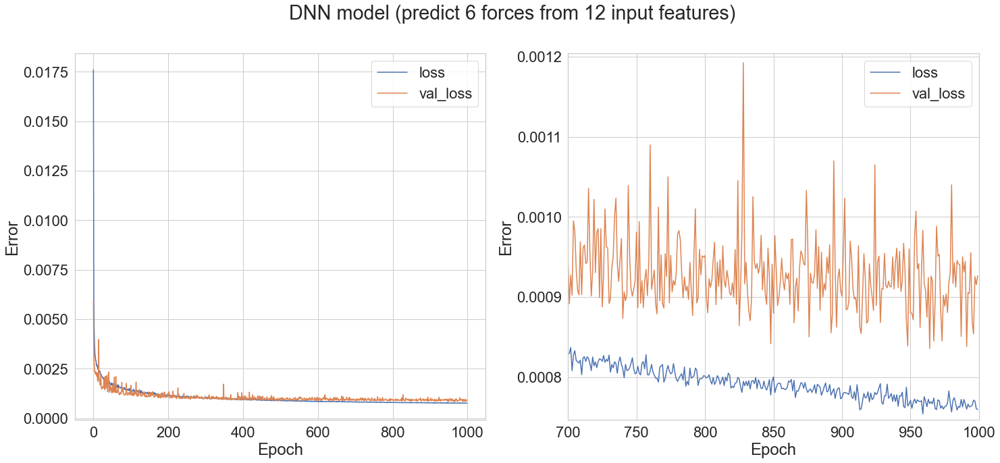

In [168]:
plot_loss(history_dnn_12, 'loss_{}.pdf'.format(dnn_model_12_tag), 'DNN model (predict 6 forces from 12 input features)')

In [49]:
# save model loss on test set for evaluation section below
test_results['dnn_12'] = dnn_model_12.evaluate(X_test_12, Y_test, verbose=0)

#### Compare prediction vs. true values for the test set

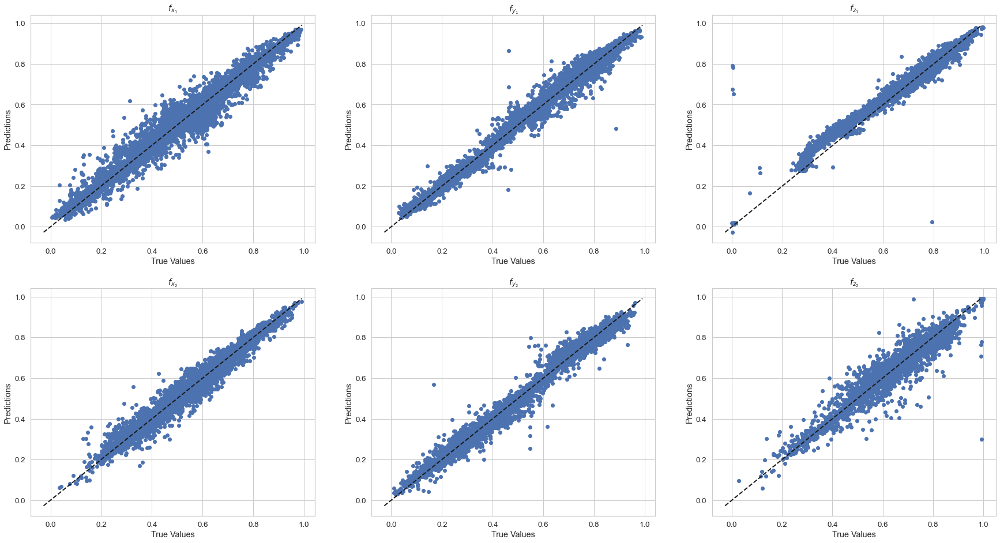

In [50]:
Y_test_pred_dnn_12 = dnn_model_12.predict(X_test_12)
plot_pred_vs_true(Y_test_pred_dnn_12, Y_test, 'pred_vs_true_{}'.format(dnn_model_12_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

## Predict all 6 forces from 36 input features (12+2x12)

Up to 2nd order derivatives for 12 input features.

In [51]:
dnn_model_36 = setup_dnn_model(Y_train.shape[-1])
dnn_model_36_tag = "{}_36features".format(dnn_tag)

In [52]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'dnn_36_tmp.h5', monitor='val_loss', save_freq='epoch')

history_dnn_36 = dnn_model_36.fit(
    X_train_36, Y_train,
    validation_data=(X_val_36, Y_val),
    batch_size = dnn_batch_size,
    epochs=dnn_epochs,
    callbacks=[save_every_epoch]
    #callbacks=[early_stop, save_every_epoch]
    #verbose=0, 
    )
dnn_model_36.summary()
with open(output_dir/'history_dnn_36.pickle', 'wb') as f:
    pickle.dump(history_dnn_36.history, f)

Epoch 1/1000
1074/1074 [==============================] - 3s 2ms/step - loss: 0.0194 - val_loss: 0.0080
Epoch 2/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0074 - val_loss: 0.0086
Epoch 3/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0052 - val_loss: 0.0029
Epoch 4/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0041 - val_loss: 0.0025
Epoch 5/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0035 - val_loss: 0.0028
Epoch 6/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0030 - val_loss: 0.0030
Epoch 7/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0028 - val_loss: 0.0017
Epoch 8/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0026 - val_loss: 0.0025
Epoch 9/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0025 - val_loss: 0.0016
Epoch 10/1000
1074/1074 [==============================] - 2s 2m

1074/1074 [==============================] - 2s 2ms/step - loss: 0.0011 - val_loss: 8.2489e-04
Epoch 78/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 6.7421e-04
Epoch 79/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.2467e-04 - val_loss: 6.3645e-04
Epoch 80/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 8.6188e-04
Epoch 81/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.2931e-04 - val_loss: 0.0014
Epoch 82/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 6.0532e-04
Epoch 83/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.6026e-04 - val_loss: 7.0217e-04
Epoch 84/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.7967e-04 - val_loss: 6.1708e-04
Epoch 85/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.4030e-04 - val_loss: 7.2395e-04
Epoch 86/1000
107

1074/1074 [==============================] - 2s 2ms/step - loss: 7.7234e-04 - val_loss: 5.7318e-04
Epoch 150/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.9164e-04 - val_loss: 5.1061e-04
Epoch 151/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.5896e-04 - val_loss: 6.8358e-04
Epoch 152/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.3250e-04 - val_loss: 4.7411e-04
Epoch 153/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.8070e-04 - val_loss: 7.0373e-04
Epoch 154/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.6910e-04 - val_loss: 4.9133e-04
Epoch 155/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3084e-04 - val_loss: 5.0086e-04
Epoch 156/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.9809e-04 - val_loss: 5.1139e-04
Epoch 157/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.4323e-04 - val_loss: 

Epoch 221/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.1504e-04 - val_loss: 4.5641e-04
Epoch 222/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.4215e-04 - val_loss: 5.1903e-04
Epoch 223/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.1454e-04 - val_loss: 4.5625e-04
Epoch 224/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.2565e-04 - val_loss: 4.6130e-04
Epoch 225/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.1515e-04 - val_loss: 4.7104e-04
Epoch 226/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.0276e-04 - val_loss: 4.3434e-04
Epoch 227/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.9577e-04 - val_loss: 4.6112e-04
Epoch 228/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.1390e-04 - val_loss: 4.7052e-04
Epoch 229/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.1580e-

Epoch 293/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.5036e-04 - val_loss: 5.0266e-04
Epoch 294/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.4956e-04 - val_loss: 4.4754e-04
Epoch 295/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.4766e-04 - val_loss: 4.2698e-04
Epoch 296/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.7783e-04 - val_loss: 5.3037e-04
Epoch 297/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.2146e-04 - val_loss: 5.4622e-04
Epoch 298/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.5164e-04 - val_loss: 4.7851e-04
Epoch 299/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.4602e-04 - val_loss: 4.7031e-04
Epoch 300/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.2684e-04 - val_loss: 4.8022e-04
Epoch 301/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.5334e-

Epoch 365/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8885e-04 - val_loss: 4.1506e-04
Epoch 366/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.0702e-04 - val_loss: 4.0699e-04
Epoch 367/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8948e-04 - val_loss: 4.3185e-04
Epoch 368/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.0089e-04 - val_loss: 4.2977e-04
Epoch 369/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8139e-04 - val_loss: 4.5624e-04
Epoch 370/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8711e-04 - val_loss: 4.8550e-04
Epoch 371/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8365e-04 - val_loss: 4.5061e-04
Epoch 372/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.9873e-04 - val_loss: 4.7621e-04
Epoch 373/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.7650e-

Epoch 437/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.5293e-04 - val_loss: 5.0037e-04
Epoch 438/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6733e-04 - val_loss: 3.8580e-04
Epoch 439/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.5143e-04 - val_loss: 3.7743e-04
Epoch 440/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.5155e-04 - val_loss: 4.1403e-04
Epoch 441/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.5751e-04 - val_loss: 4.0854e-04
Epoch 442/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.5893e-04 - val_loss: 3.9533e-04
Epoch 443/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.4759e-04 - val_loss: 3.9825e-04
Epoch 444/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6057e-04 - val_loss: 3.9567e-04
Epoch 445/1000
1074/1074 [==============================] - 3s 2ms/step - loss: 4.6581e-

Epoch 509/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.2866e-04 - val_loss: 4.4415e-04
Epoch 510/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.2657e-04 - val_loss: 4.0723e-04
Epoch 511/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.2559e-04 - val_loss: 3.7320e-04
Epoch 512/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.2385e-04 - val_loss: 4.5389e-04
Epoch 513/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3615e-04 - val_loss: 4.1649e-04
Epoch 514/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3143e-04 - val_loss: 3.8475e-04
Epoch 515/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.2096e-04 - val_loss: 3.9684e-04
Epoch 516/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.1809e-04 - val_loss: 3.8824e-04
Epoch 517/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.2626e-

Epoch 581/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.0647e-04 - val_loss: 4.5744e-04
Epoch 582/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.9778e-04 - val_loss: 3.8620e-04
Epoch 583/1000
1074/1074 [==============================] - 3s 2ms/step - loss: 4.1561e-04 - val_loss: 3.8805e-04
Epoch 584/1000
1074/1074 [==============================] - 3s 3ms/step - loss: 4.0914e-04 - val_loss: 3.9773e-04
Epoch 585/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.0187e-04 - val_loss: 3.6091e-04
Epoch 586/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.0609e-04 - val_loss: 4.1562e-04
Epoch 587/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.0952e-04 - val_loss: 3.6207e-04
Epoch 588/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.9793e-04 - val_loss: 3.7862e-04
Epoch 589/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.9297e-

Epoch 653/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.8149e-04 - val_loss: 3.7285e-04
Epoch 654/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.8816e-04 - val_loss: 3.4657e-04
Epoch 655/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.0580e-04 - val_loss: 3.7874e-04
Epoch 656/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7776e-04 - val_loss: 4.2368e-04
Epoch 657/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.8366e-04 - val_loss: 3.3580e-04
Epoch 658/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.9387e-04 - val_loss: 3.4978e-04
Epoch 659/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.8619e-04 - val_loss: 3.5499e-04
Epoch 660/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.8297e-04 - val_loss: 3.9568e-04
Epoch 661/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.9032e-

Epoch 725/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.8283e-04 - val_loss: 3.6602e-04
Epoch 726/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7506e-04 - val_loss: 3.6954e-04
Epoch 727/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7947e-04 - val_loss: 3.5749e-04
Epoch 728/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7418e-04 - val_loss: 3.6543e-04
Epoch 729/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7368e-04 - val_loss: 3.7004e-04
Epoch 730/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7503e-04 - val_loss: 3.6021e-04
Epoch 731/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7913e-04 - val_loss: 3.4490e-04
Epoch 732/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7661e-04 - val_loss: 3.6527e-04
Epoch 733/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.7777e-

Epoch 797/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.6712e-04 - val_loss: 3.5325e-04
Epoch 798/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.6912e-04 - val_loss: 3.4028e-04
Epoch 799/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.5833e-04 - val_loss: 3.5689e-04
Epoch 800/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.6562e-04 - val_loss: 3.4975e-04
Epoch 801/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.5399e-04 - val_loss: 3.5586e-04
Epoch 802/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.5573e-04 - val_loss: 3.8094e-04
Epoch 803/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.6981e-04 - val_loss: 3.5082e-04
Epoch 804/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.6129e-04 - val_loss: 3.6948e-04
Epoch 805/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.5614e-

Epoch 869/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.5335e-04 - val_loss: 3.2442e-04
Epoch 870/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.5665e-04 - val_loss: 3.3188e-04
Epoch 871/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4437e-04 - val_loss: 3.8456e-04
Epoch 872/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4932e-04 - val_loss: 3.5361e-04
Epoch 873/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4799e-04 - val_loss: 3.3428e-04
Epoch 874/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.5269e-04 - val_loss: 3.4635e-04
Epoch 875/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.6541e-04 - val_loss: 3.7214e-04
Epoch 876/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4474e-04 - val_loss: 3.5022e-04
Epoch 877/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.5471e-

Epoch 941/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.3792e-04 - val_loss: 3.3243e-04
Epoch 942/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4044e-04 - val_loss: 3.4837e-04
Epoch 943/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4211e-04 - val_loss: 3.4913e-04
Epoch 944/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4535e-04 - val_loss: 3.3565e-04
Epoch 945/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4283e-04 - val_loss: 3.4556e-04
Epoch 946/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.3702e-04 - val_loss: 3.4410e-04
Epoch 947/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.3888e-04 - val_loss: 3.3736e-04
Epoch 948/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.4469e-04 - val_loss: 3.4208e-04
Epoch 949/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 3.3609e-

#### Save DNN model

In [53]:
dnn_model_36.save(output_dir/"{}_{}.h5".format(dnn_model_36_tag, timestamp))

#### Plot loss vs. epoch

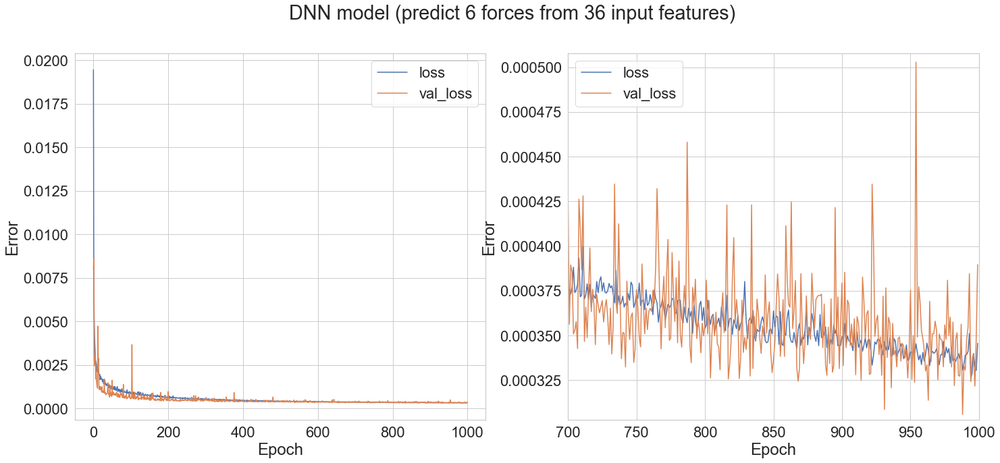

In [169]:
plot_loss(history_dnn_36, 'loss_{}.pdf'.format(dnn_model_36_tag), 'DNN model (predict 6 forces from 36 input features)')

In [55]:
# save model loss on test set for evaluation section below
test_results['dnn_36'] = dnn_model_36.evaluate(X_test_36, Y_test, verbose=0)

#### Compare prediction vs. true values for the test set

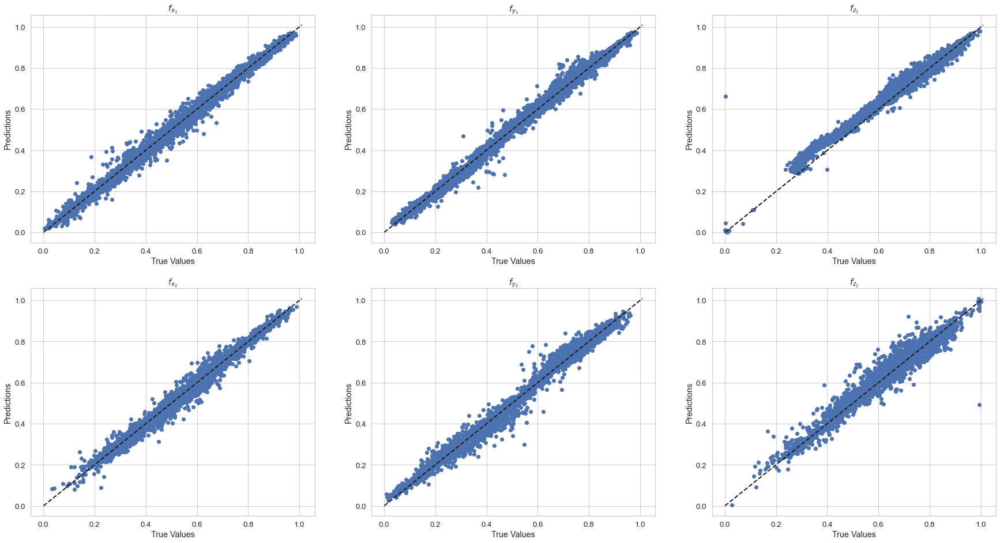

In [56]:
Y_test_pred_dnn_36 = dnn_model_36.predict(X_test_36)
plot_pred_vs_true(Y_test_pred_dnn_36, Y_test, 'pred_vs_true_{}'.format(dnn_model_36_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

## Predict all 6 forces from 84 input features (12+6x12)
Up to 6th order derivatives for 12 input features.

In [57]:
dnn_model_84 = setup_dnn_model(Y_train.shape[-1])
dnn_model_84_tag = "{}_84features".format(dnn_tag)

In [58]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'dnn_84_tmp.h5', monitor='val_loss', save_freq='epoch')

history_dnn_84 = dnn_model_84.fit(
    X_train, Y_train,
    validation_data=(X_val, Y_val),
    batch_size = dnn_batch_size,
    epochs=dnn_epochs,
    callbacks=[save_every_epoch]
    #callbacks=[early_stop, save_every_epoch]
    #verbose=0, 
    )
dnn_model_84.summary()
with open(output_dir/'history_dnn_84.pickle', 'wb') as f:
    pickle.dump(history_dnn_84.history, f)

Epoch 1/1000
1074/1074 [==============================] - 3s 2ms/step - loss: 0.0219 - val_loss: 0.0087
Epoch 2/1000
1074/1074 [==============================] - 3s 2ms/step - loss: 0.0099 - val_loss: 0.0075
Epoch 3/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0081 - val_loss: 0.0067
Epoch 4/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0066 - val_loss: 0.0052
Epoch 5/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0058 - val_loss: 0.0042
Epoch 6/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0051 - val_loss: 0.0040
Epoch 7/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0044 - val_loss: 0.0043
Epoch 8/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0045 - val_loss: 0.0025
Epoch 9/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0039 - val_loss: 0.0048
Epoch 10/1000
1074/1074 [==============================] - 2s 2m

Epoch 79/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0013 - val_loss: 9.0884e-04
Epoch 80/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0013 - val_loss: 8.3081e-04
Epoch 81/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0015 - val_loss: 0.0010
Epoch 82/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0014 - val_loss: 9.2659e-04
Epoch 83/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0014 - val_loss: 0.0018
Epoch 84/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0014 - val_loss: 8.5173e-04
Epoch 85/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0014 - val_loss: 9.0842e-04
Epoch 86/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 87/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0014 - val_loss: 8.7407e-04
Epoch 88/1000
1074/1074 [======

Epoch 154/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 6.8510e-04
Epoch 155/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.9180e-04 - val_loss: 6.5048e-04
Epoch 156/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.8918e-04 - val_loss: 8.4828e-04
Epoch 157/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.3375e-04 - val_loss: 7.1854e-04
Epoch 158/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.6392e-04 - val_loss: 9.1165e-04
Epoch 159/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.5569e-04 - val_loss: 8.2345e-04
Epoch 160/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.3226e-04 - val_loss: 6.4322e-04
Epoch 161/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 0.0010 - val_loss: 7.7015e-04
Epoch 162/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 9.5203e-04 - val

1074/1074 [==============================] - 2s 2ms/step - loss: 9.3065e-04 - val_loss: 8.3424e-04
Epoch 227/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3737e-04 - val_loss: 5.4603e-04
Epoch 228/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.5121e-04 - val_loss: 6.5523e-04
Epoch 229/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.3177e-04 - val_loss: 5.6449e-04
Epoch 230/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.1166e-04 - val_loss: 7.4712e-04
Epoch 231/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 8.1612e-04 - val_loss: 6.2941e-04
Epoch 232/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.7484e-04 - val_loss: 5.5642e-04
Epoch 233/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.7662e-04 - val_loss: 7.6652e-04
Epoch 234/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.7687e-04 - val_loss: 

1074/1074 [==============================] - 2s 2ms/step - loss: 7.5591e-04 - val_loss: 5.3483e-04
Epoch 299/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.4636e-04 - val_loss: 6.2464e-04
Epoch 300/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.0479e-04 - val_loss: 6.3029e-04
Epoch 301/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.9884e-04 - val_loss: 4.9955e-04
Epoch 302/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.0281e-04 - val_loss: 5.7195e-04
Epoch 303/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.8662e-04 - val_loss: 5.5825e-04
Epoch 304/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 7.3148e-04 - val_loss: 5.4538e-04
Epoch 305/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.7899e-04 - val_loss: 5.7394e-04
Epoch 306/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.7189e-04 - val_loss: 

Epoch 370/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.8167e-04 - val_loss: 5.9073e-04
Epoch 371/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.7622e-04 - val_loss: 5.4072e-04
Epoch 372/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.0213e-04 - val_loss: 6.0968e-04
Epoch 373/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.3986e-04 - val_loss: 4.7207e-04
Epoch 374/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.4388e-04 - val_loss: 4.6776e-04
Epoch 375/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.6837e-04 - val_loss: 5.3816e-04
Epoch 376/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.4401e-04 - val_loss: 5.1303e-04
Epoch 377/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.4100e-04 - val_loss: 5.3718e-04
Epoch 378/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.2289e-

Epoch 442/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.8877e-04 - val_loss: 5.5556e-04
Epoch 443/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.6615e-04 - val_loss: 5.3489e-04
Epoch 444/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.0640e-04 - val_loss: 5.6722e-04
Epoch 445/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.8023e-04 - val_loss: 5.0716e-04
Epoch 446/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.8122e-04 - val_loss: 5.8448e-04
Epoch 447/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.9113e-04 - val_loss: 5.6632e-04
Epoch 448/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.7553e-04 - val_loss: 5.3427e-04
Epoch 449/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.9464e-04 - val_loss: 4.7712e-04
Epoch 450/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 6.2922e-

Epoch 514/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.6022e-04 - val_loss: 5.5382e-04
Epoch 515/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.4065e-04 - val_loss: 4.7353e-04
Epoch 516/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.8162e-04 - val_loss: 4.9877e-04
Epoch 517/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.3403e-04 - val_loss: 5.0913e-04
Epoch 518/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.3551e-04 - val_loss: 4.8007e-04
Epoch 519/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.5551e-04 - val_loss: 4.9933e-04
Epoch 520/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.3698e-04 - val_loss: 6.1786e-04
Epoch 521/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.4255e-04 - val_loss: 5.0493e-04
Epoch 522/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.8383e-

Epoch 586/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.1443e-04 - val_loss: 4.7684e-04
Epoch 587/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.2410e-04 - val_loss: 4.9687e-04
Epoch 588/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.2231e-04 - val_loss: 5.5360e-04
Epoch 589/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.2070e-04 - val_loss: 4.9043e-04
Epoch 590/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.0677e-04 - val_loss: 4.6669e-04
Epoch 591/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.2819e-04 - val_loss: 5.0946e-04
Epoch 592/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.4739e-04 - val_loss: 4.9428e-04
Epoch 593/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.1259e-04 - val_loss: 4.5647e-04
Epoch 594/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.2977e-

Epoch 658/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.7887e-04 - val_loss: 4.5385e-04
Epoch 659/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.0247e-04 - val_loss: 4.8572e-04
Epoch 660/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8360e-04 - val_loss: 4.7840e-04
Epoch 661/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.0478e-04 - val_loss: 4.9653e-04
Epoch 662/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8445e-04 - val_loss: 4.5551e-04
Epoch 663/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.1851e-04 - val_loss: 5.4013e-04
Epoch 664/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.0778e-04 - val_loss: 4.7503e-04
Epoch 665/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.9127e-04 - val_loss: 5.0302e-04
Epoch 666/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.9316e-

Epoch 730/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6772e-04 - val_loss: 5.0833e-04
Epoch 731/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6159e-04 - val_loss: 4.7052e-04
Epoch 732/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6545e-04 - val_loss: 4.5688e-04
Epoch 733/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.0972e-04 - val_loss: 4.7738e-04
Epoch 734/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 5.0466e-04 - val_loss: 4.5477e-04
Epoch 735/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8471e-04 - val_loss: 4.5977e-04
Epoch 736/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6365e-04 - val_loss: 4.8572e-04
Epoch 737/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8264e-04 - val_loss: 5.1208e-04
Epoch 738/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6408e-

Epoch 802/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.4893e-04 - val_loss: 5.1978e-04
Epoch 803/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6785e-04 - val_loss: 5.3758e-04
Epoch 804/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.5905e-04 - val_loss: 4.7752e-04
Epoch 805/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.5895e-04 - val_loss: 4.6675e-04
Epoch 806/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6906e-04 - val_loss: 5.1346e-04
Epoch 807/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6594e-04 - val_loss: 4.3044e-04
Epoch 808/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.4894e-04 - val_loss: 4.4313e-04
Epoch 809/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6450e-04 - val_loss: 4.9192e-04
Epoch 810/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6584e-

1074/1074 [==============================] - 2s 2ms/step - loss: 4.6326e-04 - val_loss: 5.0995e-04
Epoch 874/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.9179e-04 - val_loss: 4.8949e-04
Epoch 875/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.4562e-04 - val_loss: 4.8289e-04
Epoch 876/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3685e-04 - val_loss: 4.7636e-04
Epoch 877/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3188e-04 - val_loss: 4.5653e-04
Epoch 878/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.8997e-04 - val_loss: 4.3325e-04
Epoch 879/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.4305e-04 - val_loss: 4.8532e-04
Epoch 880/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.5344e-04 - val_loss: 6.1190e-04
Epoch 881/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3375e-04 - val_loss: 

Epoch 945/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.2730e-04 - val_loss: 4.3390e-04
Epoch 946/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3186e-04 - val_loss: 4.6922e-04
Epoch 947/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3148e-04 - val_loss: 4.8631e-04
Epoch 948/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.4268e-04 - val_loss: 4.7228e-04
Epoch 949/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3135e-04 - val_loss: 4.3428e-04
Epoch 950/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3763e-04 - val_loss: 4.4012e-04
Epoch 951/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3140e-04 - val_loss: 4.5671e-04
Epoch 952/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.3998e-04 - val_loss: 4.5773e-04
Epoch 953/1000
1074/1074 [==============================] - 2s 2ms/step - loss: 4.6630e-

#### Save DNN model

In [59]:
dnn_model_84.save(output_dir/"{}_{}.h5".format(dnn_model_84_tag, timestamp))

#### Plot loss vs. epoch

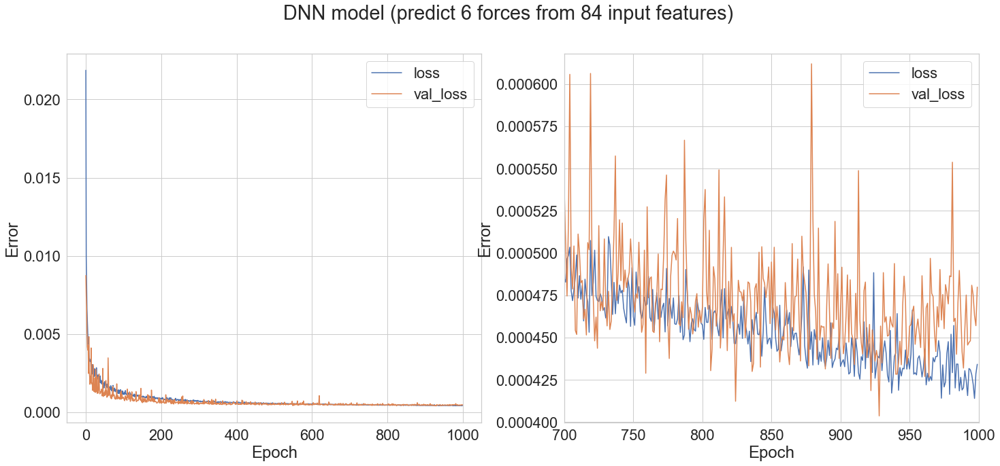

In [170]:
plot_loss(history_dnn_84, 'loss_{}.pdf'.format(dnn_model_84_tag), 'DNN model (predict 6 forces from 84 input features)')

In [61]:
# save model loss on test set for evaluation section below
test_results['dnn_84'] = dnn_model_84.evaluate(X_test, Y_test, verbose=0)

#### Compare prediction vs. true values for the test set

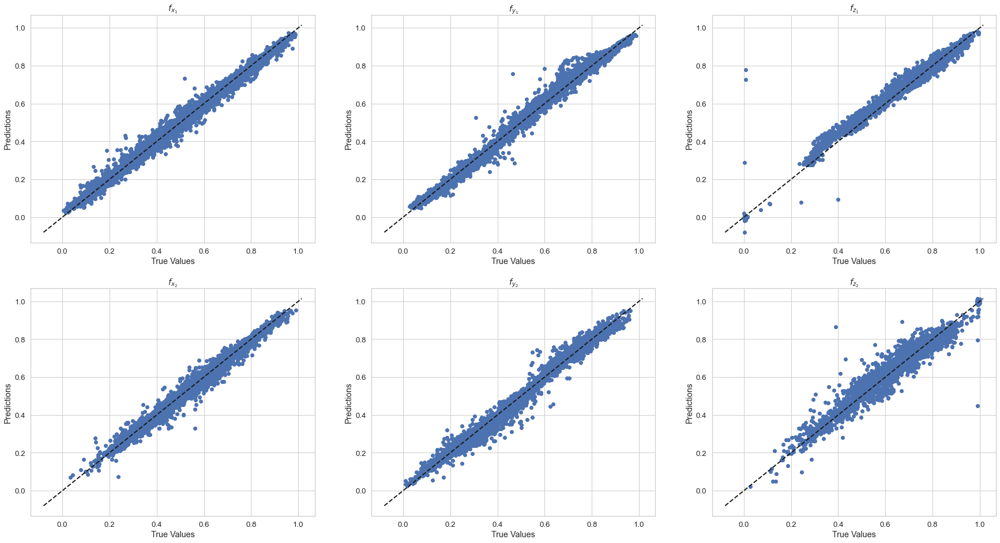

In [62]:
Y_test_pred_dnn_84 = dnn_model_84.predict(X_test)
plot_pred_vs_true(Y_test_pred_dnn_84, Y_test, 'pred_vs_true_{}'.format(dnn_model_84_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

## 4.3 RNN regression

I experimented with LSTM, GRU, and SimpleRNN layers. Performance was relatively similar, but the LSTM seemed to do slightly better. 

As is shown in section 5, an RNN did a significantly better job predicted unseen data than a DNN, especially for the dataset not seen during training.

In [63]:
def setup_rnn_model(n_outputs):
  model = keras.Sequential([
      #layers.BatchNormalization(),
      layers.LSTM(100, activation='relu', return_sequences=True),
      #layers.SimpleRNN(100, activation='relu', return_sequences=True),
      #layers.GRU(100, activation='relu', return_sequences=True),
      layers.Dropout(0.05),
      layers.LSTM(100, activation='relu', return_sequences=False),
      #layers.SimpleRNN(100, activation='relu', return_sequences=False),
      #layers.GRU(100, activation='relu', return_sequences=False),
      layers.Dropout(0.05),
      layers.Dense(100, activation='relu'),
      layers.Dense(n_outputs)
  ])

  model.compile(loss='mean_squared_error',
                optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3, decay=5e-6))
  return model

In [64]:
# rnn config
rnn_tag = "rnn_lstm200x2_dense100x1_0p5drop" 
rnn_epochs = 300
rnn_batch_size = 32

In [65]:
rnn_model_12 = setup_rnn_model(Y_seq_train.shape[-1])
rnn_model_12_tag = "{}_12features".format(rnn_tag)

In [66]:
rnn_model_36 = setup_rnn_model(Y_seq_train.shape[-1])
rnn_model_36_tag = "{}_36features".format(rnn_tag)

In [67]:
rnn_model_84 = setup_rnn_model(Y_seq_train.shape[-1])
rnn_model_84_tag = "{}_84features".format(rnn_tag)

In [68]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'rnn_12_tmp.h5', monitor='val_loss', save_freq='epoch')

history_rnn_12 = rnn_model_12.fit(
    X_seq_train_12, Y_seq_train,
    validation_data=(X_seq_val_12, Y_seq_val),
    batch_size = rnn_batch_size,
    epochs=rnn_epochs,
    callbacks=[save_every_epoch]
    #callbacks=[early_stop, save_every_epoch]
    #verbose=0, 
    )
rnn_model_12.summary()
with open(output_dir/'history_rnn_12.pickle', 'wb') as f:
    pickle.dump(history_rnn_12.history, f)

Epoch 1/300
1074/1074 [==============================] - 21s 18ms/step - loss: 0.0202 - val_loss: 0.0076
Epoch 2/300
1074/1074 [==============================] - 19s 18ms/step - loss: 0.0069 - val_loss: 0.0050
Epoch 3/300
1074/1074 [==============================] - 18s 16ms/step - loss: 0.0048 - val_loss: 0.0044
Epoch 4/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0039 - val_loss: 0.0035
Epoch 5/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0035 - val_loss: 0.0029
Epoch 6/300
1074/1074 [==============================] - 18s 16ms/step - loss: 0.0031 - val_loss: 0.0027
Epoch 7/300
1074/1074 [==============================] - 19s 18ms/step - loss: 0.0028 - val_loss: 0.0027
Epoch 8/300
1074/1074 [==============================] - 19s 18ms/step - loss: 0.0027 - val_loss: 0.0025
Epoch 9/300
1074/1074 [==============================] - 17s 16ms/step - loss: 0.0025 - val_loss: 0.0020
Epoch 10/300
1074/1074 [==============================]

1074/1074 [==============================] - 17s 16ms/step - loss: 7.6013e-04 - val_loss: 8.0014e-04
Epoch 76/300
1074/1074 [==============================] - 17s 16ms/step - loss: 7.1654e-04 - val_loss: 7.7888e-04
Epoch 77/300
1074/1074 [==============================] - 17s 15ms/step - loss: 7.6911e-04 - val_loss: 8.2755e-04
Epoch 78/300
1074/1074 [==============================] - 17s 16ms/step - loss: 7.1343e-04 - val_loss: 6.4415e-04
Epoch 79/300
1074/1074 [==============================] - 17s 16ms/step - loss: 7.1607e-04 - val_loss: 6.5078e-04
Epoch 80/300
1074/1074 [==============================] - 17s 15ms/step - loss: 7.1533e-04 - val_loss: 6.1989e-04
Epoch 81/300
1074/1074 [==============================] - 16s 15ms/step - loss: 7.2518e-04 - val_loss: 6.5011e-04
Epoch 82/300
1074/1074 [==============================] - 17s 16ms/step - loss: 7.1422e-04 - val_loss: 7.9746e-04
Epoch 83/300
1074/1074 [==============================] - 17s 15ms/step - loss: 6.9424e-04 - val_loss

1074/1074 [==============================] - 18s 17ms/step - loss: 5.4280e-04 - val_loss: 7.9784e-04
Epoch 147/300
1074/1074 [==============================] - 18s 17ms/step - loss: 5.2697e-04 - val_loss: 5.3795e-04
Epoch 148/300
1074/1074 [==============================] - 18s 17ms/step - loss: 5.3205e-04 - val_loss: 5.3278e-04
Epoch 149/300
1074/1074 [==============================] - 18s 16ms/step - loss: 5.1163e-04 - val_loss: 5.9996e-04
Epoch 150/300
1074/1074 [==============================] - 18s 17ms/step - loss: 5.2591e-04 - val_loss: 6.1352e-04
Epoch 151/300
1074/1074 [==============================] - 18s 17ms/step - loss: 5.2992e-04 - val_loss: 5.0720e-04
Epoch 152/300
1074/1074 [==============================] - 18s 16ms/step - loss: 5.3525e-04 - val_loss: 4.9406e-04
Epoch 153/300
1074/1074 [==============================] - 18s 17ms/step - loss: 5.0806e-04 - val_loss: 4.9322e-04
Epoch 154/300
1074/1074 [==============================] - 18s 17ms/step - loss: 5.2629e-04 - 

1074/1074 [==============================] - 18s 17ms/step - loss: 4.3823e-04 - val_loss: 4.9282e-04
Epoch 218/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.4912e-04 - val_loss: 4.7412e-04
Epoch 219/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.3737e-04 - val_loss: 5.2138e-04
Epoch 220/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.4052e-04 - val_loss: 4.6754e-04
Epoch 221/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.3998e-04 - val_loss: 4.6920e-04
Epoch 222/300
1074/1074 [==============================] - 18s 16ms/step - loss: 4.2757e-04 - val_loss: 4.5936e-04
Epoch 223/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.4676e-04 - val_loss: 4.6970e-04
Epoch 224/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.3534e-04 - val_loss: 5.7388e-04
Epoch 225/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.3112e-04 - 

1074/1074 [==============================] - 18s 17ms/step - loss: 3.9180e-04 - val_loss: 4.1898e-04
Epoch 289/300
1074/1074 [==============================] - 18s 16ms/step - loss: 3.8169e-04 - val_loss: 4.2963e-04
Epoch 290/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.9448e-04 - val_loss: 4.7071e-04
Epoch 291/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.8239e-04 - val_loss: 4.3133e-04
Epoch 292/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.8521e-04 - val_loss: 4.3249e-04
Epoch 293/300
1074/1074 [==============================] - 18s 16ms/step - loss: 3.8257e-04 - val_loss: 4.4053e-04
Epoch 294/300
1074/1074 [==============================] - 18s 16ms/step - loss: 3.7424e-04 - val_loss: 4.2335e-04
Epoch 295/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.8982e-04 - val_loss: 4.6866e-04
Epoch 296/300
1074/1074 [==============================] - 18s 16ms/step - loss: 3.8401e-04 - 

In [69]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'rnn_36_tmp.h5', monitor='val_loss', save_freq='epoch')

history_rnn_36 = rnn_model_36.fit(
    X_seq_train_36, Y_seq_train,
    validation_data=(X_seq_val_36, Y_seq_val),
    batch_size = rnn_batch_size,
    epochs=rnn_epochs,
    callbacks=[save_every_epoch]
    #callbacks=[early_stop, save_every_epoch]
    #verbose=0, 
    )
rnn_model_36.summary()
with open(output_dir/'history_rnn_36.pickle', 'wb') as f:
    pickle.dump(history_rnn_36.history, f)

Epoch 1/300
1074/1074 [==============================] - 20s 17ms/step - loss: 0.0171 - val_loss: 0.0094
Epoch 2/300
1074/1074 [==============================] - 18s 16ms/step - loss: 0.0068 - val_loss: 0.0046
Epoch 3/300
1074/1074 [==============================] - 17s 16ms/step - loss: 0.0044 - val_loss: 0.0038
Epoch 4/300
1074/1074 [==============================] - 18s 16ms/step - loss: 0.0033 - val_loss: 0.0033
Epoch 5/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0028 - val_loss: 0.0030
Epoch 6/300
1074/1074 [==============================] - 18s 16ms/step - loss: 0.0026 - val_loss: 0.0026
Epoch 7/300
1074/1074 [==============================] - 18s 16ms/step - loss: 0.0024 - val_loss: 0.0027
Epoch 8/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0022 - val_loss: 0.0047
Epoch 9/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0021 - val_loss: 0.0016
Epoch 10/300
1074/1074 [==============================]

Epoch 75/300
1074/1074 [==============================] - 17s 16ms/step - loss: 5.5902e-04 - val_loss: 6.8044e-04
Epoch 76/300
1074/1074 [==============================] - 17s 16ms/step - loss: 5.2194e-04 - val_loss: 4.3259e-04
Epoch 77/300
1074/1074 [==============================] - 17s 16ms/step - loss: 5.1758e-04 - val_loss: 4.7240e-04
Epoch 78/300
1074/1074 [==============================] - 17s 16ms/step - loss: 5.3657e-04 - val_loss: 7.4981e-04
Epoch 79/300
1074/1074 [==============================] - 18s 16ms/step - loss: 5.2792e-04 - val_loss: 4.3214e-04
Epoch 80/300
1074/1074 [==============================] - 17s 16ms/step - loss: 5.6859e-04 - val_loss: 4.3085e-04
Epoch 81/300
1074/1074 [==============================] - 17s 16ms/step - loss: 4.9580e-04 - val_loss: 4.7299e-04
Epoch 82/300
1074/1074 [==============================] - 17s 16ms/step - loss: 4.9543e-04 - val_loss: 4.0326e-04
Epoch 83/300
1074/1074 [==============================] - 17s 16ms/step - loss: 5.0920e-

1074/1074 [==============================] - 17s 16ms/step - loss: 3.9518e-04 - val_loss: 3.9958e-04
Epoch 147/300
1074/1074 [==============================] - 18s 16ms/step - loss: 3.6526e-04 - val_loss: 3.3589e-04
Epoch 148/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.5465e-04 - val_loss: 3.7143e-04
Epoch 149/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.6282e-04 - val_loss: 5.2815e-04
Epoch 150/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.6862e-04 - val_loss: 4.5892e-04
Epoch 151/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.6215e-04 - val_loss: 4.6983e-04
Epoch 152/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.6386e-04 - val_loss: 3.1409e-04
Epoch 153/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.6263e-04 - val_loss: 4.4883e-04
Epoch 154/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.6625e-04 - 

1074/1074 [==============================] - 18s 16ms/step - loss: 3.1104e-04 - val_loss: 3.1056e-04
Epoch 218/300
1074/1074 [==============================] - 18s 16ms/step - loss: 3.0251e-04 - val_loss: 3.5447e-04
Epoch 219/300
1074/1074 [==============================] - 18s 16ms/step - loss: 2.9886e-04 - val_loss: 3.1898e-04
Epoch 220/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.0442e-04 - val_loss: 2.9624e-04
Epoch 221/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.0562e-04 - val_loss: 3.0139e-04
Epoch 222/300
1074/1074 [==============================] - 18s 16ms/step - loss: 2.9998e-04 - val_loss: 4.2856e-04
Epoch 223/300
1074/1074 [==============================] - 18s 16ms/step - loss: 2.9473e-04 - val_loss: 3.2009e-04
Epoch 224/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.0307e-04 - val_loss: 4.0242e-04
Epoch 225/300
1074/1074 [==============================] - 17s 16ms/step - loss: 3.0973e-04 - 

1074/1074 [==============================] - 18s 17ms/step - loss: 2.6766e-04 - val_loss: 2.9571e-04
Epoch 289/300
1074/1074 [==============================] - 18s 17ms/step - loss: 2.6343e-04 - val_loss: 3.5964e-04
Epoch 290/300
1074/1074 [==============================] - 19s 17ms/step - loss: 2.6951e-04 - val_loss: 3.0937e-04
Epoch 291/300
1074/1074 [==============================] - 18s 17ms/step - loss: 2.6419e-04 - val_loss: 2.9235e-04
Epoch 292/300
1074/1074 [==============================] - 18s 17ms/step - loss: 2.6069e-04 - val_loss: 3.0082e-04
Epoch 293/300
1074/1074 [==============================] - 18s 17ms/step - loss: 2.6264e-04 - val_loss: 3.3003e-04
Epoch 294/300
1074/1074 [==============================] - 18s 17ms/step - loss: 2.6386e-04 - val_loss: 3.1733e-04
Epoch 295/300
1074/1074 [==============================] - 18s 16ms/step - loss: 2.5697e-04 - val_loss: 3.3751e-04
Epoch 296/300
1074/1074 [==============================] - 17s 16ms/step - loss: 2.7905e-04 - 

In [70]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'rnn_84_tmp.h5', monitor='val_loss', save_freq='epoch')

history_rnn_84 = rnn_model_84.fit(
    X_seq_train, Y_seq_train,
    validation_data=(X_seq_val, Y_seq_val),
    batch_size = rnn_batch_size,
    epochs=rnn_epochs,
    callbacks=[save_every_epoch]
    #callbacks=[early_stop, save_every_epoch]
    #verbose=0, 
    )
rnn_model_84.summary()
with open(output_dir/'history_rnn_84.pickle', 'wb') as f:
    pickle.dump(history_rnn_84.history, f)

Epoch 1/300
1074/1074 [==============================] - 20s 17ms/step - loss: 0.0185 - val_loss: 0.0110
Epoch 2/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0083 - val_loss: 0.0058
Epoch 3/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0054 - val_loss: 0.0082
Epoch 4/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0047 - val_loss: 0.0033
Epoch 5/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0038 - val_loss: 0.0030
Epoch 6/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0034 - val_loss: 0.0042
Epoch 7/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0031 - val_loss: 0.0085
Epoch 8/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0027 - val_loss: 0.0021
Epoch 9/300
1074/1074 [==============================] - 18s 17ms/step - loss: 0.0025 - val_loss: 0.0035
Epoch 10/300
1074/1074 [==============================]

Epoch 76/300
1074/1074 [==============================] - 18s 17ms/step - loss: 6.6918e-04 - val_loss: 7.9918e-04
Epoch 77/300
1074/1074 [==============================] - 18s 17ms/step - loss: 6.9393e-04 - val_loss: 5.2042e-04
Epoch 78/300
1074/1074 [==============================] - 18s 17ms/step - loss: 7.0354e-04 - val_loss: 5.1253e-04
Epoch 79/300
1074/1074 [==============================] - 18s 17ms/step - loss: 6.7468e-04 - val_loss: 9.5659e-04
Epoch 80/300
1074/1074 [==============================] - 18s 17ms/step - loss: 6.6551e-04 - val_loss: 5.0816e-04
Epoch 81/300
1074/1074 [==============================] - 19s 17ms/step - loss: 6.9431e-04 - val_loss: 7.5679e-04
Epoch 82/300
1074/1074 [==============================] - 19s 18ms/step - loss: 6.7167e-04 - val_loss: 5.4897e-04
Epoch 83/300
1074/1074 [==============================] - 19s 18ms/step - loss: 6.5725e-04 - val_loss: 5.8101e-04
Epoch 84/300
1074/1074 [==============================] - 19s 18ms/step - loss: 6.5200e-

1074/1074 [==============================] - 18s 17ms/step - loss: 4.8597e-04 - val_loss: 3.9366e-04
Epoch 148/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.7430e-04 - val_loss: 8.3642e-04
Epoch 149/300
1074/1074 [==============================] - 18s 17ms/step - loss: 5.0219e-04 - val_loss: 4.1293e-04
Epoch 150/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.7034e-04 - val_loss: 4.5023e-04
Epoch 151/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.4843e-04 - val_loss: 4.8017e-04
Epoch 152/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.8476e-04 - val_loss: 3.7373e-04
Epoch 153/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.9080e-04 - val_loss: 4.1534e-04
Epoch 154/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.7344e-04 - val_loss: 4.2208e-04
Epoch 155/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.9261e-04 - 

1074/1074 [==============================] - 18s 17ms/step - loss: 3.9644e-04 - val_loss: 3.4883e-04
Epoch 219/300
1074/1074 [==============================] - 18s 17ms/step - loss: 4.0278e-04 - val_loss: 3.2957e-04
Epoch 220/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.9341e-04 - val_loss: 4.2799e-04
Epoch 221/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.8764e-04 - val_loss: 4.4054e-04
Epoch 222/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.9818e-04 - val_loss: 3.2500e-04
Epoch 223/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.8357e-04 - val_loss: 3.3161e-04
Epoch 224/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.8726e-04 - val_loss: 4.8841e-04
Epoch 225/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.9223e-04 - val_loss: 4.6660e-04
Epoch 226/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.7012e-04 - 

1074/1074 [==============================] - 18s 17ms/step - loss: 3.3655e-04 - val_loss: 3.1125e-04
Epoch 290/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.4295e-04 - val_loss: 3.2457e-04
Epoch 291/300
1074/1074 [==============================] - 19s 17ms/step - loss: 3.3137e-04 - val_loss: 3.0604e-04
Epoch 292/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.6438e-04 - val_loss: 3.8535e-04
Epoch 293/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.4629e-04 - val_loss: 3.1418e-04
Epoch 294/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.3425e-04 - val_loss: 3.0500e-04
Epoch 295/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.4192e-04 - val_loss: 3.6850e-04
Epoch 296/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.3095e-04 - val_loss: 3.4243e-04
Epoch 297/300
1074/1074 [==============================] - 18s 17ms/step - loss: 3.3362e-04 - 

#### Save RNN model

In [71]:
rnn_model_12.save(output_dir/"{}_{}.h5".format(rnn_model_12_tag, timestamp), save_traces=False)

In [72]:
rnn_model_36.save(output_dir/"{}_{}.h5".format(rnn_model_36_tag, timestamp), save_traces=False)

In [73]:
rnn_model_84.save(output_dir/"{}_{}.h5".format(rnn_model_84_tag, timestamp), save_traces=False)

#### Plot loss vs. epoch

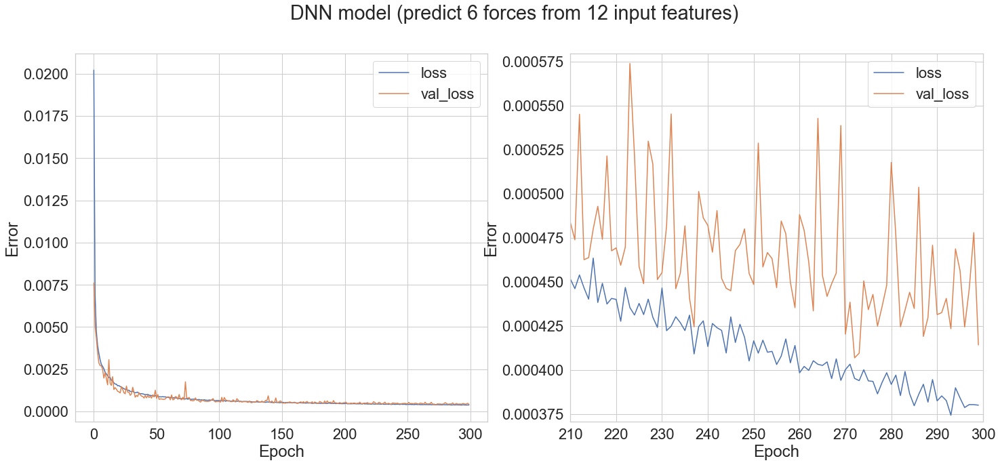

In [171]:
plot_loss(history_rnn_12, 'error_vs_epoch_{}.pdf'.format(rnn_model_12_tag), 'DNN model (predict 6 forces from 12 input features)')

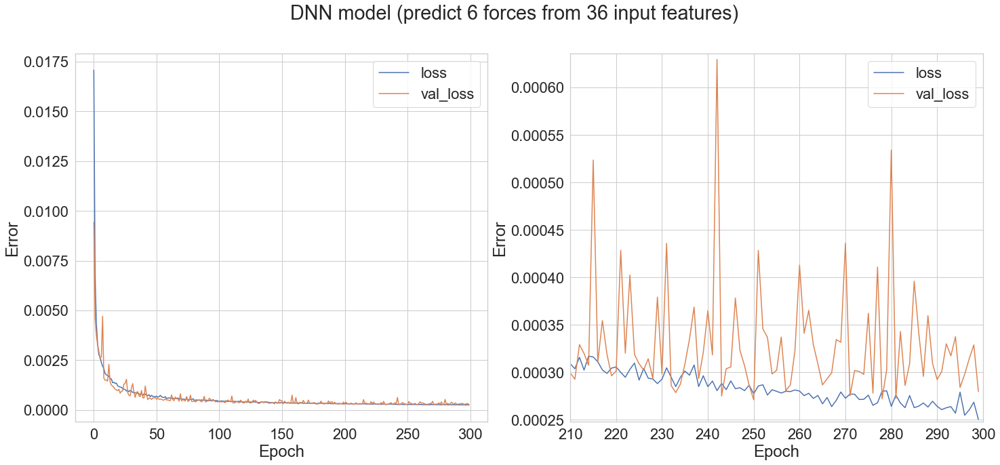

In [172]:
plot_loss(history_rnn_36, 'error_vs_epoch_{}.pdf'.format(rnn_model_36_tag), 'DNN model (predict 6 forces from 36 input features)')

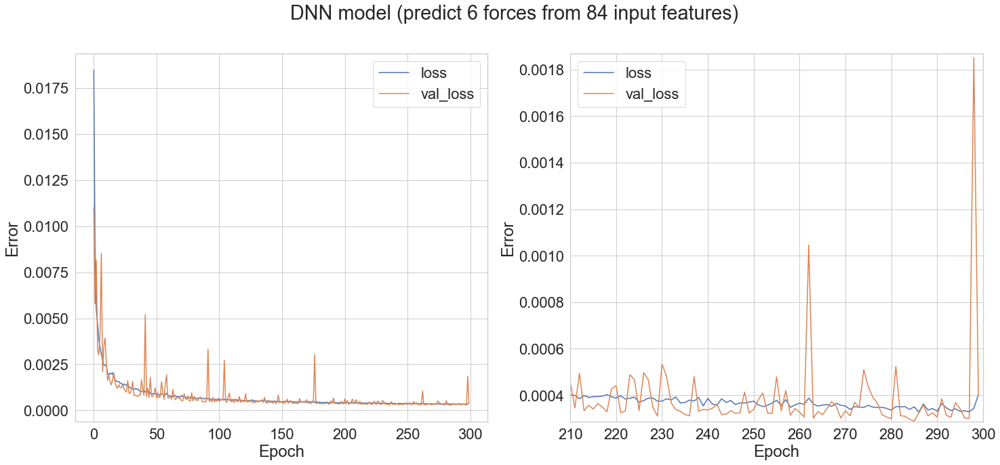

In [173]:
plot_loss(history_rnn_84, 'error_vs_epoch_{}.pdf'.format(rnn_model_84_tag), 'DNN model (predict 6 forces from 84 input features)')

In [174]:
# save model loss on test set for evaluation section below
test_results['rnn_12'] = rnn_model_12.evaluate(X_seq_test_12, Y_seq_test, verbose=0)

In [175]:
# save model loss on test set for evaluation section below
test_results['rnn_36'] = rnn_model_36.evaluate(X_seq_test_36, Y_seq_test, verbose=0)

In [176]:
# save model loss on test set for evaluation section below
test_results['rnn_84'] = rnn_model_84.evaluate(X_seq_test, Y_seq_test, verbose=0)

#### Compare prediction vs. true values for the test set

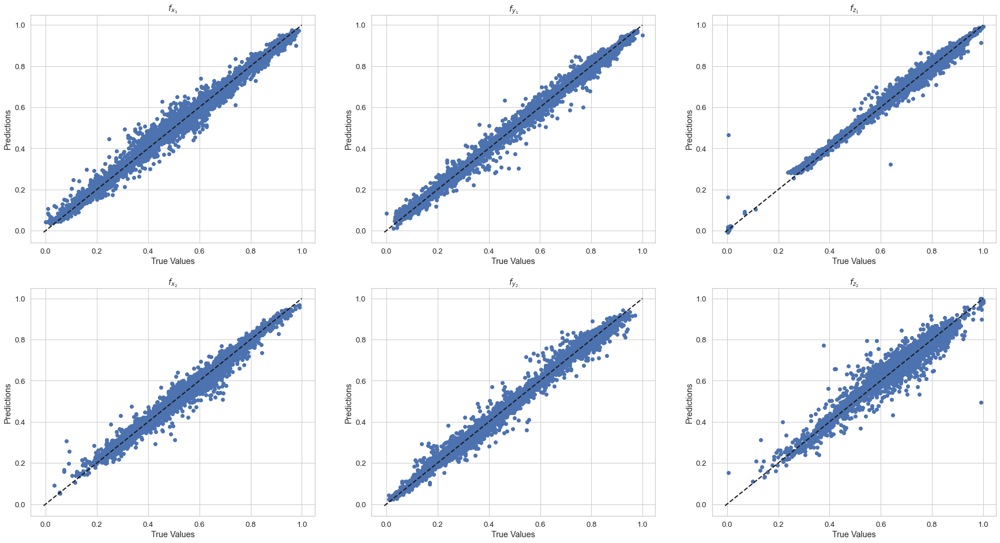

In [80]:
Y_seq_test_pred_12 = rnn_model_12.predict(X_seq_test_12)
plot_pred_vs_true(Y_seq_test_pred_12, Y_seq_test, 'pred_vs_true_{}'.format(rnn_model_12_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

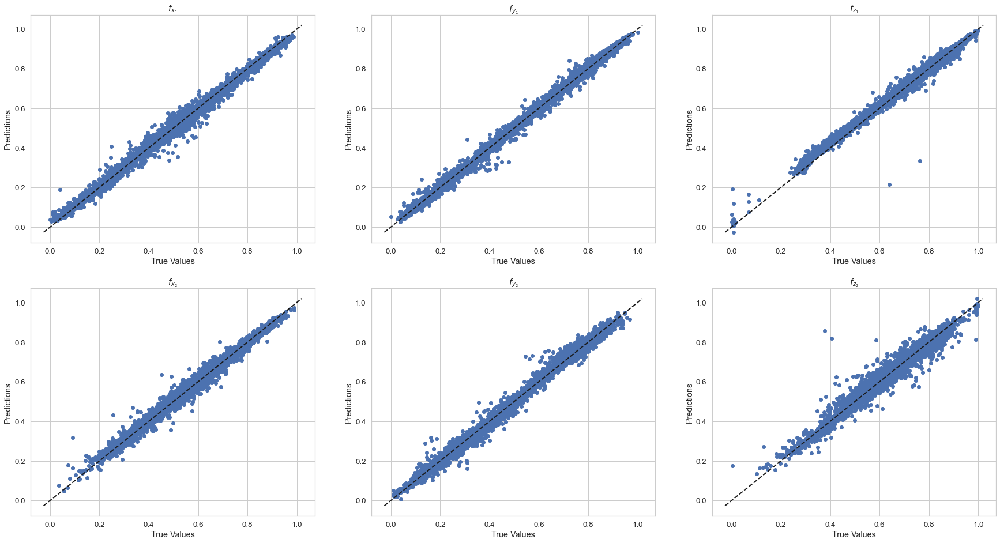

In [82]:
Y_seq_test_pred_36 = rnn_model_36.predict(X_seq_test_36)
plot_pred_vs_true(Y_seq_test_pred_36, Y_seq_test, 'pred_vs_true_{}'.format(rnn_model_36_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

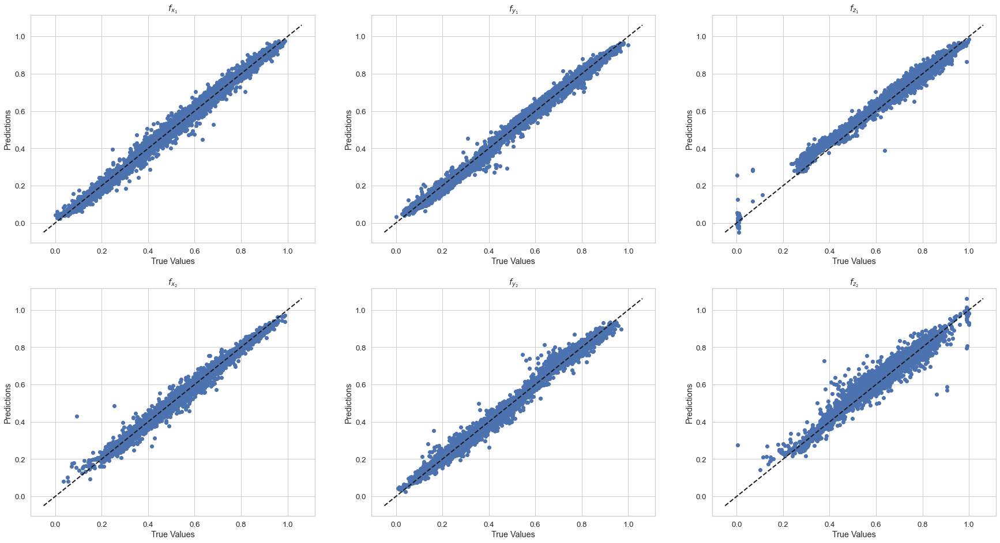

In [83]:
Y_seq_test_pred = rnn_model_84.predict(X_seq_test)
plot_pred_vs_true(Y_seq_test_pred, Y_seq_test, 'pred_vs_true_{}'.format(rnn_model_84_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

# 5. Evaluation

## 5.1 Loss on test sets

In [84]:
print("loss on test sets:")
for key,val in test_results.items():
    print("- {}: {:.2e}".format(key,val))

loss on test sets:
- linear_x1: 1.47e-02
- linear_12: 2.69e-02
- dnn_12: 8.80e-04
- dnn_36: 3.78e-04
- dnn_84: 4.47e-04
- rnn_12: 3.96e-04
- rnn_36: 2.87e-04
- rnn_84: 3.88e-04


Loss after 1000 and 300 epochs for DNN and RNN respectively:
- linear_x1: 1.47e-02
- linear_12: 2.69e-02
- dnn_12: 8.80e-04
- dnn_36: 3.78e-04
- dnn_84: 4.47e-04
- rnn_12: 3.96e-04
- rnn_36: 2.87e-04
- rnn_84: 3.88e-04

### Loss on Test1, Test2, Test4 (no data from Test2 was included in the training)

In [85]:
def create_separate_test_sets(df, features, outputs, n_steps=20, feature_idx=None, dnn_model = None, rnn_model = None):

    # select relevant features and outputs
    X = df[features].to_numpy()
    Y = df[outputs].to_numpy()
    
    # apply scaling
    X_normed = scaler_x.transform(X)
    Y_normed = scaler_y.transform(Y)
    
    # handle sequences
    X_seq, Y_seq = split_sequences(X_normed, Y_normed, n_steps)
    

    # select indices corresponding to desired feature
    if feature_idx:
        X = X[:,feature_idx]
        X_normed = X_normed[:,feature_idx] 
        X_seq = X_seq[:,:,feature_idx]

    outputs = {
        'X': X, 'Y': Y, 
        'X_normed': X_normed, 'Y_normed': Y_normed,
        'X_seq_normed': X_seq, 'Y_seq_normed': Y_seq,
        'Y_seq': scaler_y.inverse_transform(Y_seq)
        }
    
    # calculate model predictions
    if dnn_model:
        Y_pred_normed = dnn_model.predict(X_normed)
        Y_pred = scaler_y.inverse_transform(Y_pred_normed)
        outputs['Y_pred_normed'] = Y_pred_normed
        outputs['Y_pred'] = Y_pred
    if rnn_model:
        Y_seq_pred_normed = rnn_model.predict(X_seq)
        outputs['Y_seq_pred_normed'] = Y_seq_pred_normed
        Y_seq_pred = scaler_y.inverse_transform(Y_seq_pred_normed)
        outputs['Y_seq_pred'] = Y_seq_pred
    
    return outputs


In [86]:
tests_12 = dict()
for i,df in enumerate(datasets):
    tests_12[dataset_filenames[i]] = create_separate_test_sets(
        df, features_nth, outputs, n_steps, feature_idx=feature_idx,
        dnn_model=dnn_model_12, rnn_model=rnn_model_12)


In [87]:
tests_36 = dict()
for i,df in enumerate(datasets):
    tests_36[dataset_filenames[i]] = create_separate_test_sets(
        df, features_nth, outputs, n_steps, feature_idx=feature_idx_2nd, 
        dnn_model=dnn_model_36, rnn_model=rnn_model_36)


In [88]:
tests_84 = dict()
for i,df in enumerate(datasets):
    tests_84[dataset_filenames[i]] = create_separate_test_sets(
        df, features_nth, outputs, n_steps, feature_idx=None,
        dnn_model=dnn_model_84, rnn_model=rnn_model_84)


In [89]:
print("Loss on full Test1, Test2, Test4 datasets:")
for filename in dataset_filenames:
    loss_dnn12 = dnn_model_12.evaluate(
        tests_12[filename]['X_normed'], tests_12[filename]['Y_normed'], verbose=0)
    loss_dnn36 = dnn_model_36.evaluate(
        tests_36[filename]['X_normed'], tests_36[filename]['Y_normed'], verbose=0)
    loss_dnn84 = dnn_model_84.evaluate(
        tests_84[filename]['X_normed'], tests_84[filename]['Y_normed'], verbose=0)
    loss_rnn12 = rnn_model_12.evaluate(
        tests_12[filename]['X_seq_normed'], tests_12[filename]['Y_seq_normed'], verbose=0)
    loss_rnn36 = rnn_model_36.evaluate(
        tests_36[filename]['X_seq_normed'], tests_36[filename]['Y_seq_normed'], verbose=0)
    loss_rnn84 = rnn_model_84.evaluate(
        tests_84[filename]['X_seq_normed'], tests_84[filename]['Y_seq_normed'], verbose=0)
    print("- {}:\n DNN-12: {:.2e}\n DNN-36: {:.2e}\n DNN-84: {:.2e}\n RNN-12: {:.2e}\n RNN-36: {:.2e}\n RNN-84: {:.2e}".format(
        filename, loss_dnn12, loss_dnn36, loss_dnn84, loss_rnn12, loss_rnn36, loss_rnn84))

Loss on full Test1, Test2, Test4 datasets:
- Test1:
 DNN-12: 5.62e-04
 DNN-36: 2.34e-04
 DNN-84: 3.00e-04
 RNN-12: 1.76e-04
 RNN-36: 1.53e-04
 RNN-84: 2.54e-04
- Test2:
 DNN-12: 7.01e-02
 DNN-36: 3.22e-02
 DNN-84: 3.06e-02
 RNN-12: 3.60e-02
 RNN-36: 4.03e-03
 RNN-84: 4.52e-03
- Test4:
 DNN-12: 8.17e-04
 DNN-36: 3.62e-04
 DNN-84: 4.27e-04
 RNN-12: 3.73e-04
 RNN-36: 2.46e-04
 RNN-84: 3.68e-04


### >> Note that no part of Test2 was included during training <<

**Observations:**
- The RNN does significantly better than any of the DNNs for all datasets. It has about an order of magnitude lower loss on Test2. 
- DNN/RNN-84 does a bit worse than DNN/RNN-36, indicating that adding higher-order derivatives beyond acceleration makes learning harder. It may also not be worth it adding the additional derivatives. Perhaps training for more epochs could help. 
- Comparing the loss on Test1 and Test4 (70 percent of Test1+Test4 was seen during training) w.r.t. loss on Test2, it is clear that all models struggled to generalize well to Test2. **There is room for improvement here.**

## 5.2. Prediction error


### Model predictions on the different test sets

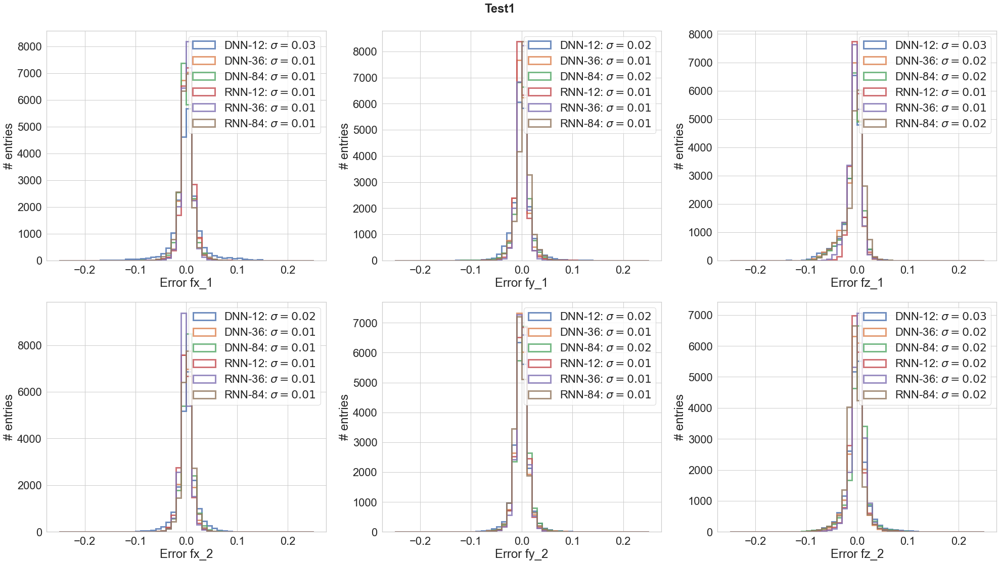

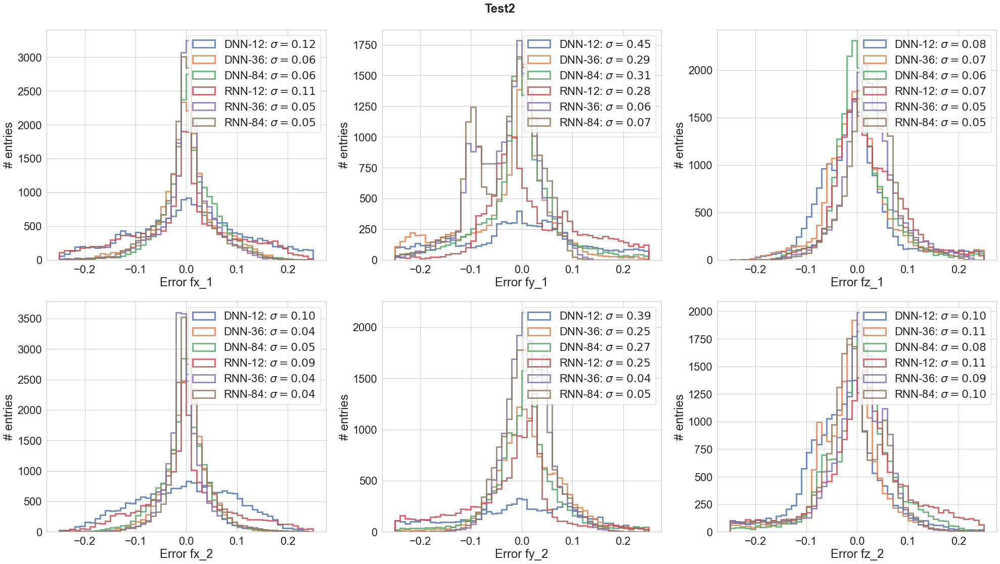

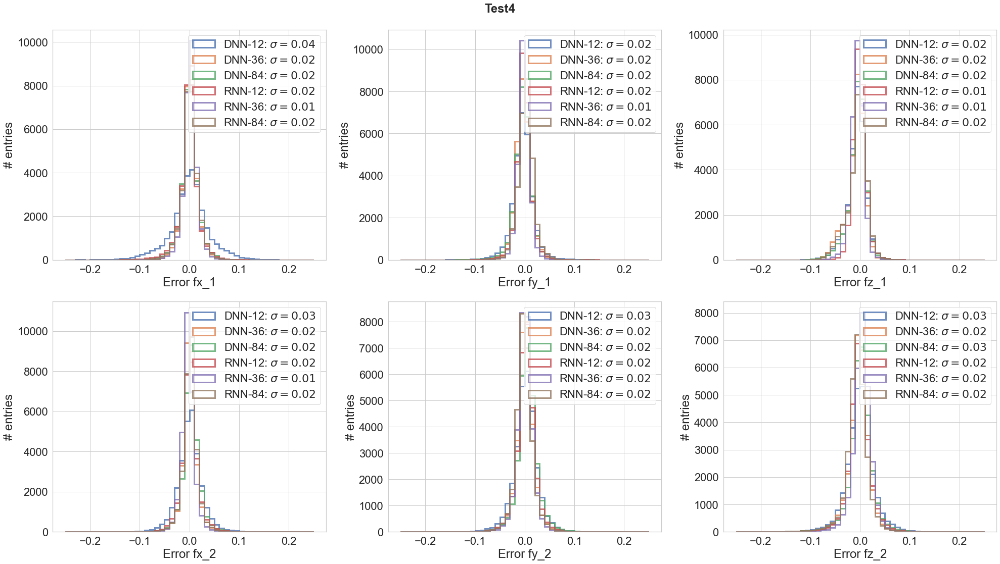

In [90]:
tmin = 0
tmax = -1
bins=50
linewidth=3

sns.set(font_scale = 2)
sns.color_palette()
sns.set_style("whitegrid")
for filename in dataset_filenames:

    Y_err_12 = tests_12[filename]['Y_normed'] - tests_12[filename]['Y_pred_normed']
    Y_err_36 = tests_36[filename]['Y_normed'] - tests_36[filename]['Y_pred_normed']
    Y_err_84 = tests_84[filename]['Y_normed'] - tests_84[filename]['Y_pred_normed']
    Y_seq_err_12 = tests_12[filename]['Y_seq_normed'] - tests_12[filename]['Y_seq_pred_normed']
    Y_seq_err_36 = tests_36[filename]['Y_seq_normed'] - tests_36[filename]['Y_seq_pred_normed']
    Y_seq_err_84 = tests_84[filename]['Y_seq_normed'] - tests_84[filename]['Y_seq_pred_normed']

    fig = plt.figure(figsize=(28,16))
    fig.suptitle(filename, weight='bold').set_fontsize('24')
    for i in range(len(outputs)):

        label_dnn12 = "DNN-12: $\sigma={:.2f}$".format(np.std(Y_err_12[:,i]))
        label_dnn36 = "DNN-36: $\sigma={:.2f}$".format(np.std(Y_err_36[:,i]))
        label_dnn84 = "DNN-84: $\sigma={:.2f}$".format(np.std(Y_err_84[:,i]))
        label_rnn12 = "RNN-12: $\sigma={:.2f}$".format(np.std(Y_seq_err_12[:,i]))
        label_rnn36 = "RNN-36: $\sigma={:.2f}$".format(np.std(Y_seq_err_36[:,i]))
        label_rnn84 = "RNN-84: $\sigma={:.2f}$".format(np.std(Y_seq_err_84[:,i]))

        ax = fig.add_subplot(2,3,i+1)
        ax.hist(Y_err_12[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_dnn12)
        ax.hist(Y_err_36[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_dnn36)
        ax.hist(Y_err_84[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_dnn84)
        ax.hist(Y_seq_err_12[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_rnn12)
        ax.hist(Y_seq_err_36[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_rnn36)
        ax.hist(Y_seq_err_84[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_rnn84)
        ax.set_xlabel('Error {}'.format(outputs[i]))
        ax.set_ylabel('# entries')
        ax.legend()
    plt.tight_layout()
    plt.savefig(output_dir/'{}_error.pdf'.format(filename))

**Observations:**
- The RNN models outperforms the DNN models. 
- The error is low (1-2% for RNN-36/84) on Test1 and Test4 (70% of Test1+Test4 was seen during training). 
- The error is significantly higher (4-10%) for RNN-36/84 on Test2 (not seen during training).

### R2 score

In [91]:
from sklearn.metrics import r2_score

print("R2 score on Test1, Test2, Test4 datasets:")
print("(" + " ".join(outputs) + ")")
for filename in dataset_filenames:
 
    r2_dnn12 = ['DNN-12:']
    r2_dnn36 = ['DNN-36:']
    r2_dnn84 = ['DNN-84:']
    r2_rnn12 = ['RNN-12:']
    r2_rnn36 = ['RNN-36:']
    r2_rnn84 = ['RNN-84:']
    for i in range(len(outputs)):
        r2_dnn12.append("{:.2f}".format(r2_score(tests_12[filename]['Y_normed'][:,i], tests_12[filename]['Y_pred_normed'][:,i])))
        r2_dnn36.append("{:.2f}".format(r2_score(tests_36[filename]['Y_normed'][:,i], tests_36[filename]['Y_pred_normed'][:,i])))
        r2_dnn84.append("{:.2f}".format(r2_score(tests_84[filename]['Y_normed'][:,i], tests_84[filename]['Y_pred_normed'][:,i])))
        r2_rnn12.append("{:.2f}".format(r2_score(tests_12[filename]['Y_seq_normed'][:,i], tests_12[filename]['Y_seq_pred_normed'][:,i])))
        r2_rnn36.append("{:.2f}".format(r2_score(tests_36[filename]['Y_seq_normed'][:,i], tests_36[filename]['Y_seq_pred_normed'][:,i])))
        r2_rnn84.append("{:.2f}".format(r2_score(tests_84[filename]['Y_seq_normed'][:,i], tests_84[filename]['Y_seq_pred_normed'][:,i])))

    print("- {}:".format(filename))
    print("\t"+"\t".join(r2_dnn12))
    print("\t"+"\t".join(r2_dnn36))
    print("\t"+"\t".join(r2_dnn84))
    print("\t"+"\t".join(r2_rnn12))
    print("\t"+"\t".join(r2_rnn36))
    print("\t"+"\t".join(r2_rnn84))

R2 score on Test1, Test2, Test4 datasets:
(fx_1 fy_1 fz_1 fx_2 fy_2 fz_2)
- Test1:
	DNN-12:	0.97	0.99	0.97	0.98	0.99	0.96
	DNN-36:	1.00	1.00	0.98	0.99	1.00	0.98
	DNN-84:	0.99	1.00	0.98	0.99	1.00	0.97
	RNN-12:	0.99	1.00	0.99	0.99	1.00	0.98
	RNN-36:	1.00	1.00	0.99	1.00	1.00	0.98
	RNN-84:	0.99	1.00	0.99	0.99	1.00	0.98
- Test2:
	DNN-12:	0.50	-1.78	0.68	0.54	-1.85	0.07
	DNN-36:	0.88	-0.26	0.76	0.91	-0.26	0.04
	DNN-84:	0.89	-0.22	0.82	0.88	-0.30	0.57
	RNN-12:	0.62	-0.27	0.76	0.61	-0.42	0.09
	RNN-36:	0.90	0.94	0.83	0.92	0.96	0.34
	RNN-84:	0.90	0.93	0.85	0.91	0.96	0.18
- Test4:
	DNN-12:	0.95	0.99	0.98	0.97	0.99	0.90
	DNN-36:	0.99	1.00	0.98	0.99	0.99	0.94
	DNN-84:	0.99	0.99	0.98	0.98	0.99	0.92
	RNN-12:	0.99	1.00	0.99	0.98	0.99	0.93
	RNN-36:	0.99	1.00	0.99	0.99	0.99	0.95
	RNN-84:	0.99	1.00	0.98	0.99	0.99	0.93


The coefficient of determination (R2) is the proportion of the variation in the dependent variable (e.g., predicted forces) that is predictable from the independent variables (e.g., measured forces). The range is from negative infinity to +1. 
- An R2 score of +1 indicates that the predictions match the observations perfectly. 
- An R2 score of 0 indicates that the predictions are as good as random guesses around the mean of the observations.
- Negative R2 indicates that the predictions are worse than random. 

**Observations:**
- All models do pretty well on Test1 and Test4, of which a significant fraction (70%) was seen during training.
- The RNN models does significantly better on Test2, which was not seen during training.
- Although it did better than the DNN models, even the RNN struggled to predict forces in the $z$-direction on the Test2 dataset (especially for R2). 

### Pearson corrrelation coefficient

In [92]:
def pearson(x, y):
   corr = np.corrcoef(x, y)
   return corr[0,1]

In [93]:
print("Pearson correlations for Test1, Test2, Test4 datasets:")
print("(" + " ".join(outputs) + ")")
for filename in dataset_filenames:
 
    pearson_dnn12 = ['DNN-12:']
    pearson_dnn36 = ['DNN-36:']
    pearson_dnn84 = ['DNN-84:']
    pearson_rnn12 = ['RNN-12:']
    pearson_rnn36 = ['RNN-36:']
    pearson_rnn84 = ['RNN-84:']
    for i in range(len(outputs)):
        pearson_dnn12.append("{:.2f}".format(pearson(tests_12[filename]['Y_normed'][:,i], tests_12[filename]['Y_pred_normed'][:,i])))
        pearson_dnn36.append("{:.2f}".format(pearson(tests_36[filename]['Y_normed'][:,i], tests_36[filename]['Y_pred_normed'][:,i])))
        pearson_dnn84.append("{:.2f}".format(pearson(tests_84[filename]['Y_normed'][:,i], tests_84[filename]['Y_pred_normed'][:,i])))
        pearson_rnn12.append("{:.2f}".format(pearson(tests_12[filename]['Y_seq_normed'][:,i], tests_12[filename]['Y_seq_pred_normed'][:,i])))
        pearson_rnn36.append("{:.2f}".format(pearson(tests_36[filename]['Y_seq_normed'][:,i], tests_36[filename]['Y_seq_pred_normed'][:,i])))
        pearson_rnn84.append("{:.2f}".format(pearson(tests_84[filename]['Y_seq_normed'][:,i], tests_84[filename]['Y_seq_pred_normed'][:,i])))

    print("- {}:".format(filename))
    print("\t"+"\t".join(pearson_dnn12))
    print("\t"+"\t".join(pearson_dnn36))
    print("\t"+"\t".join(pearson_dnn84))
    print("\t"+"\t".join(pearson_rnn12))
    print("\t"+"\t".join(pearson_rnn36))
    print("\t"+"\t".join(pearson_rnn84))

Pearson correlations for Test1, Test2, Test4 datasets:
(fx_1 fy_1 fz_1 fx_2 fy_2 fz_2)
- Test1:
	DNN-12:	0.99	1.00	0.99	0.99	1.00	0.98
	DNN-36:	1.00	1.00	1.00	1.00	1.00	0.99
	DNN-84:	1.00	1.00	0.99	1.00	1.00	0.99
	RNN-12:	1.00	1.00	1.00	1.00	1.00	0.99
	RNN-36:	1.00	1.00	1.00	1.00	1.00	0.99
	RNN-84:	1.00	1.00	0.99	1.00	1.00	0.99
- Test2:
	DNN-12:	0.75	-0.43	0.84	0.75	-0.51	0.49
	DNN-36:	0.94	0.40	0.88	0.95	0.38	0.44
	DNN-84:	0.95	0.31	0.91	0.95	0.29	0.76
	RNN-12:	0.79	0.36	0.89	0.78	0.31	0.42
	RNN-36:	0.95	0.97	0.93	0.96	0.98	0.60
	RNN-84:	0.95	0.97	0.94	0.96	0.98	0.52
- Test4:
	DNN-12:	0.98	1.00	0.99	0.98	0.99	0.95
	DNN-36:	1.00	1.00	0.99	0.99	1.00	0.97
	DNN-84:	0.99	1.00	0.99	0.99	1.00	0.96
	RNN-12:	0.99	1.00	1.00	0.99	1.00	0.96
	RNN-36:	1.00	1.00	1.00	1.00	1.00	0.98
	RNN-84:	1.00	1.00	0.99	0.99	1.00	0.97


The Pearson correlation coefficient ($r$) can range from -1 to +1. 
- An $r$ of -1 indicates a perfect negative linear correlation.
- An $r$ of 0 indicates no correlation.
- An $r$ of +1 indicates a perfect positive linear correlation.

**Observations:**
- Similar to the observations for the R2 score. 

## 5.3. Time series plots of prediction vs. ground truth

In [114]:
def plot_timeseries(tmin = 12000, tmax = 12500, linewidth=4):
    
    t = np.linspace(tmin, tmax, tmax-tmin)
    sns.set(font_scale = 2)
    sns.color_palette()
    sns.set_style("whitegrid")
    for filename in dataset_filenames:

        fig = plt.figure(figsize=(30,30))
        fig.suptitle(filename, weight='bold').set_fontsize('24')
        for i in range(6):
            ax = fig.add_subplot(6, 1, i+1)
            ax.plot(t, tests_12[filename]['Y'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='Data', linestyle='dashed', linewidth=linewidth, color='k')
            ax.plot(t, tests_12[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-12 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.plot(t, tests_36[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-36 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.plot(t, tests_84[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-84 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.plot(t, tests_12[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-12 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.plot(t, tests_36[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-36 pred.', linestyle='dashed', linewidth=linewidth, color='red')
            ax.plot(t, tests_84[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-84 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.set_xlabel('t')
            ax.set_ylabel(outputs[i])
            ax.legend(loc=2)
        plt.tight_layout()
        plt.savefig(output_dir/'{}_timeseries_t{}to{}.pdf'.format(filename, tmin, tmax))

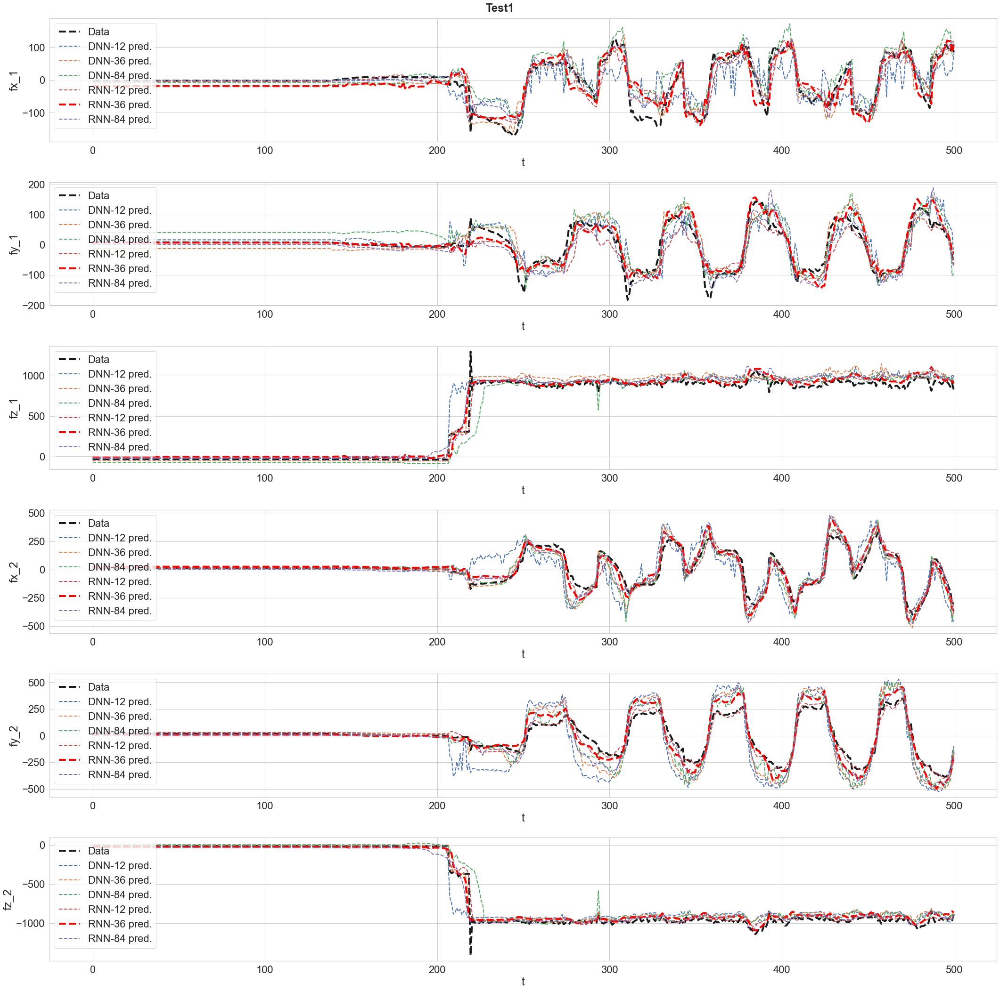

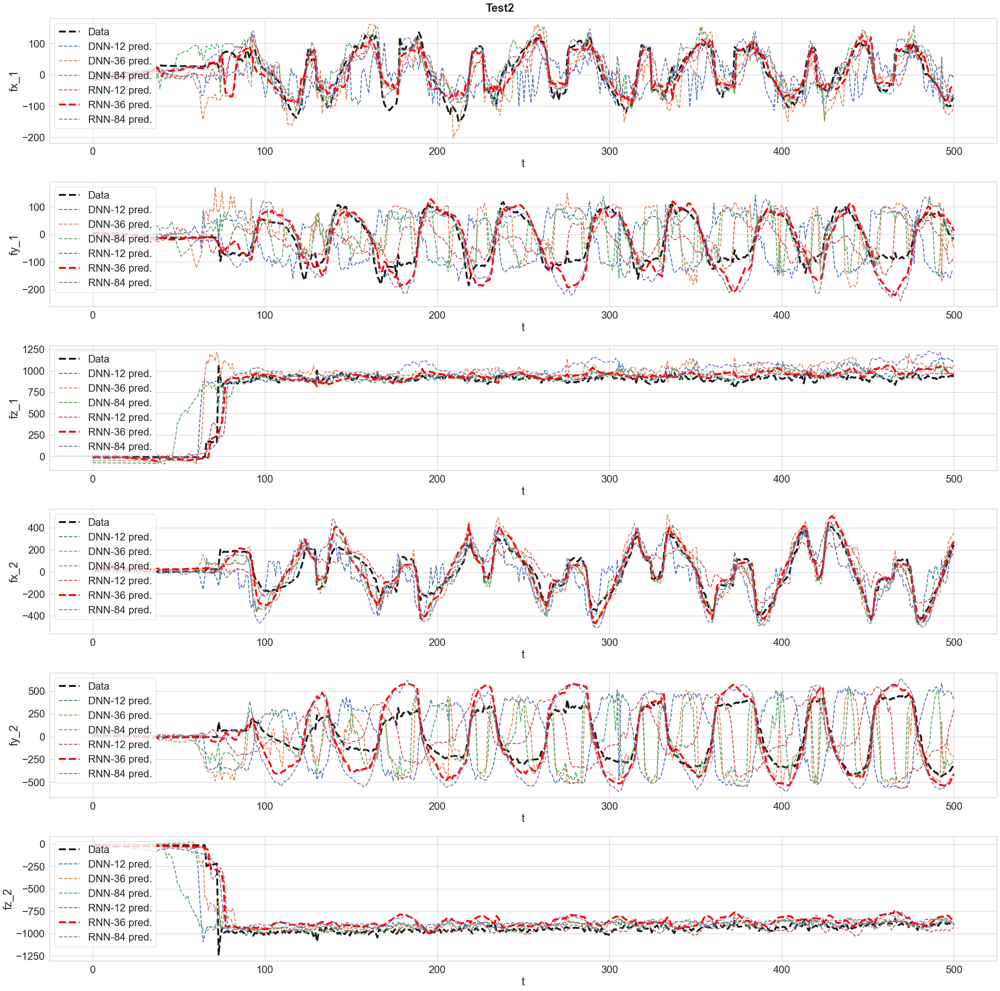

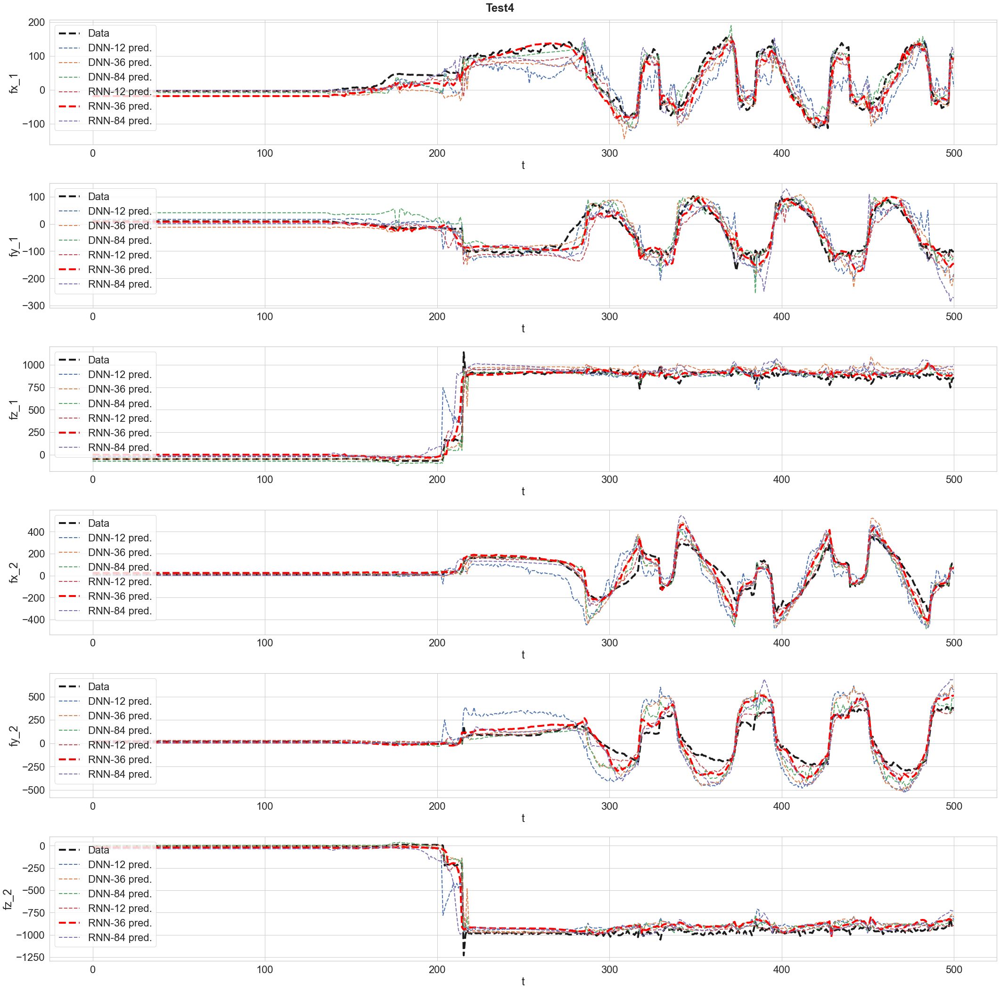

In [115]:
plot_timeseries(tmin=0, tmax=500)

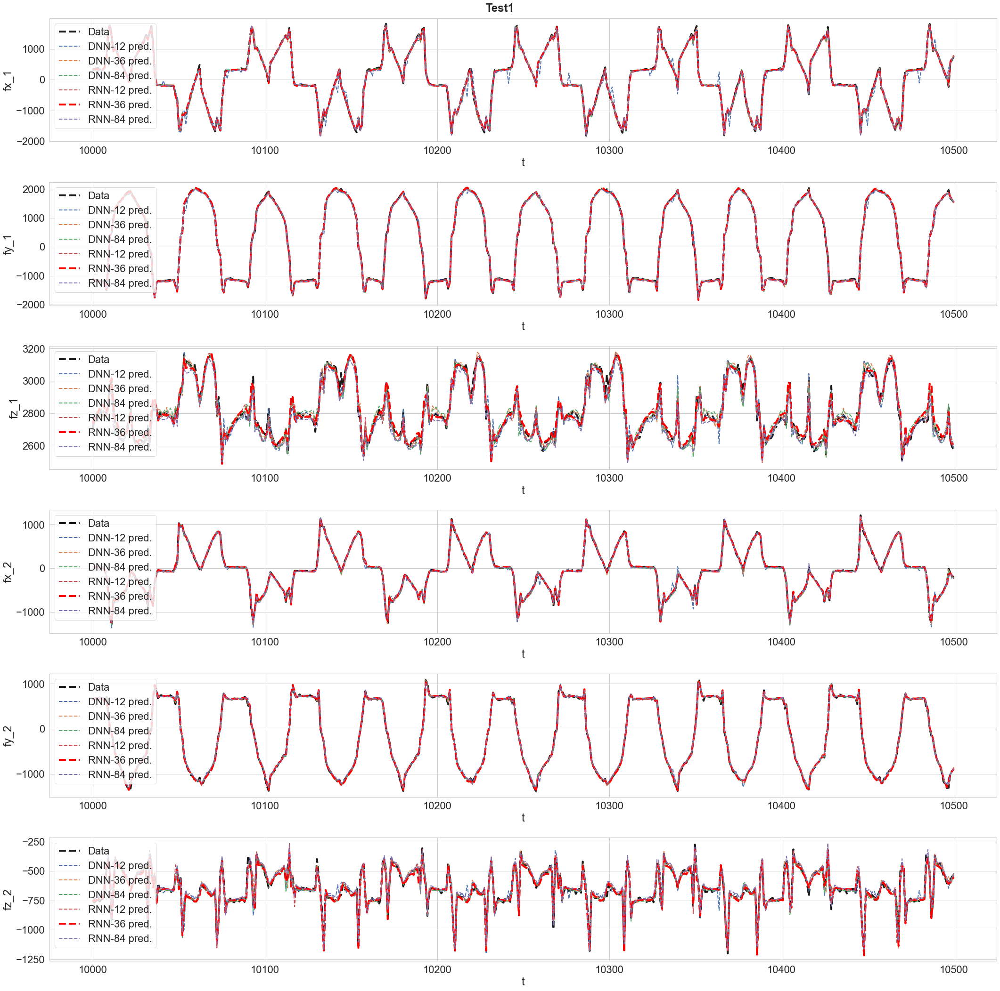

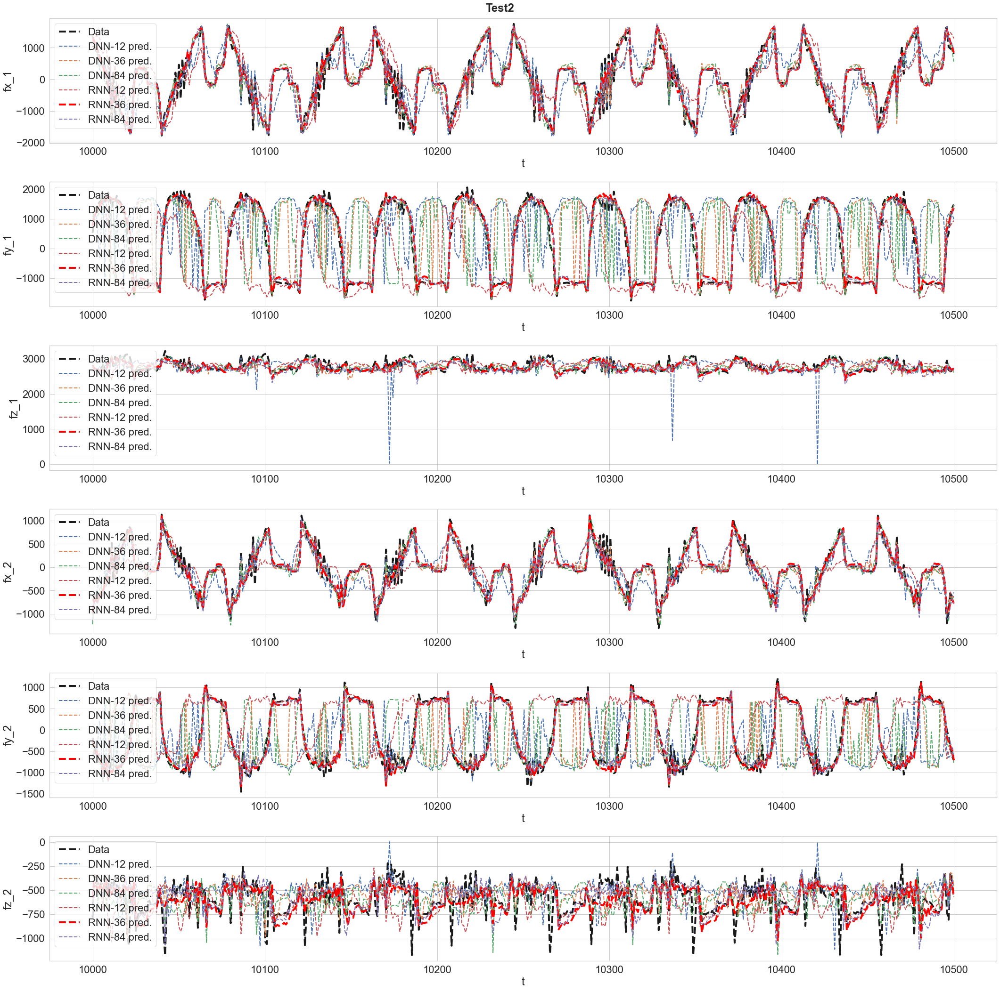

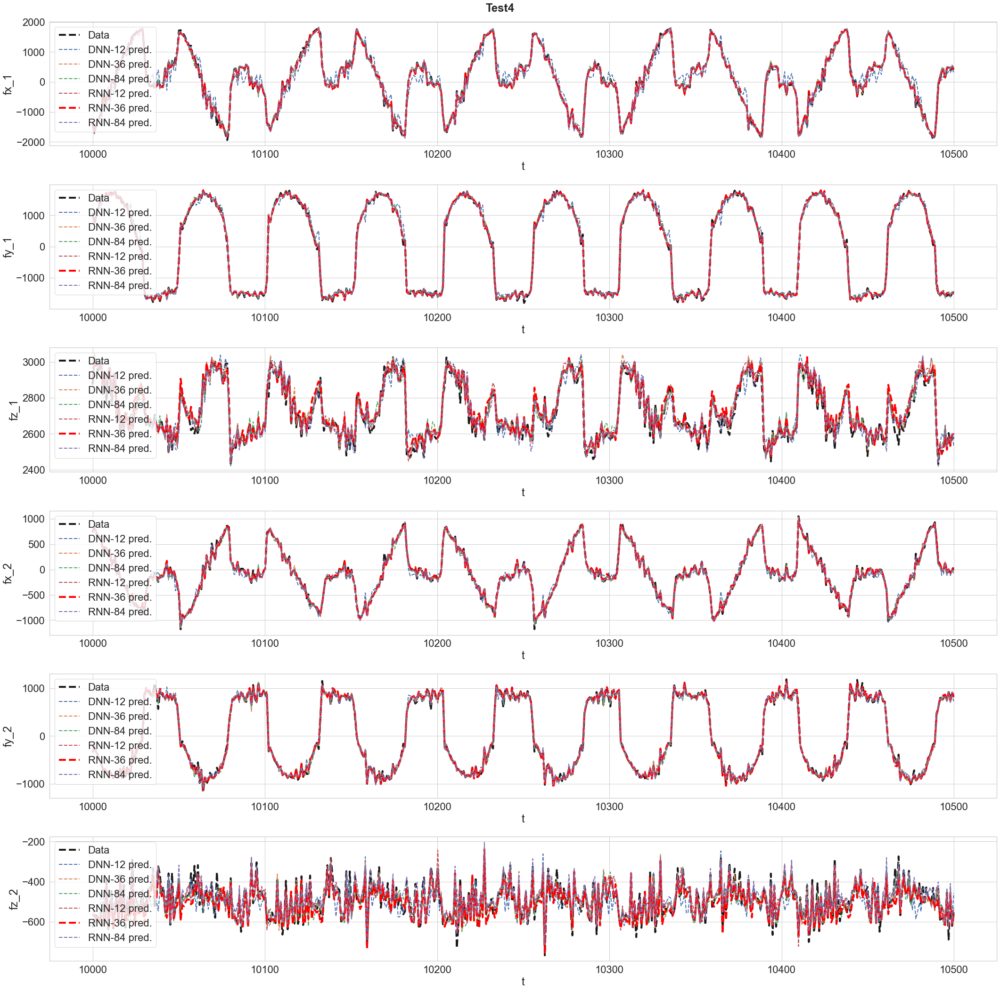

In [116]:
plot_timeseries(tmin=10000, tmax=10500)

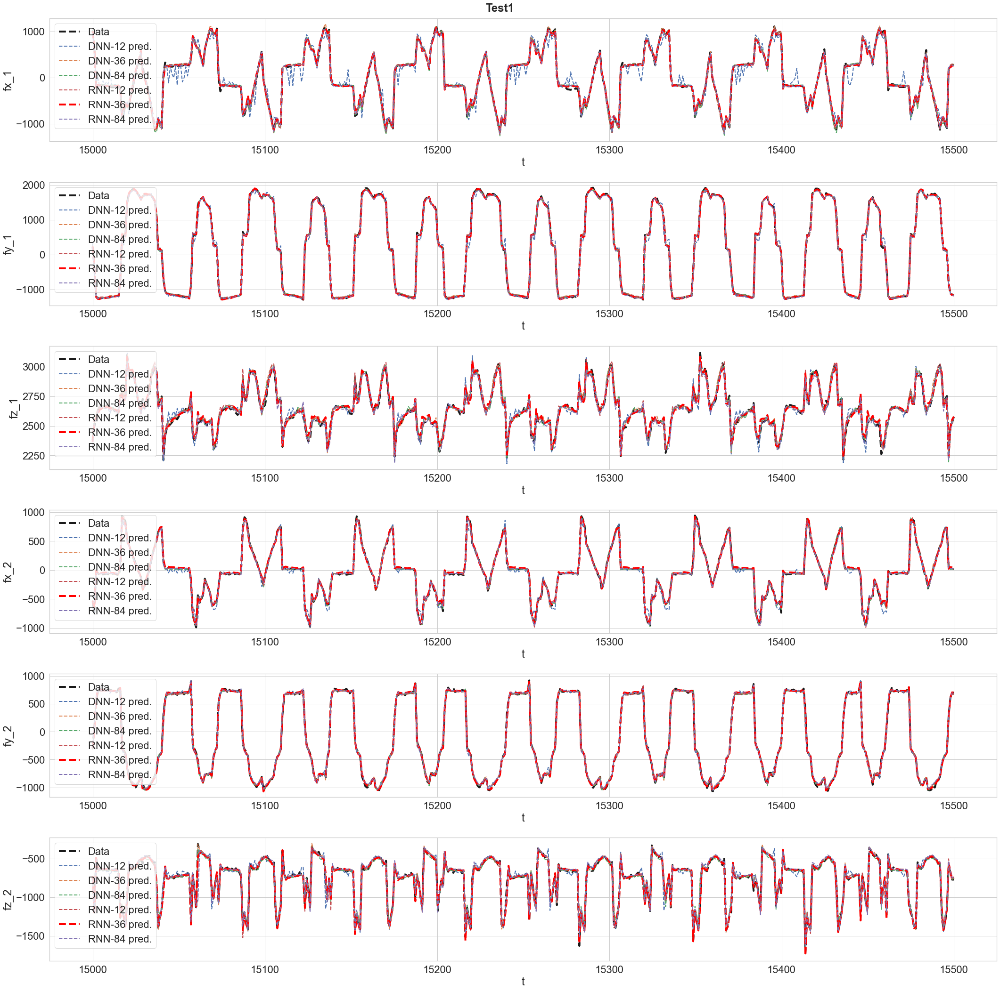

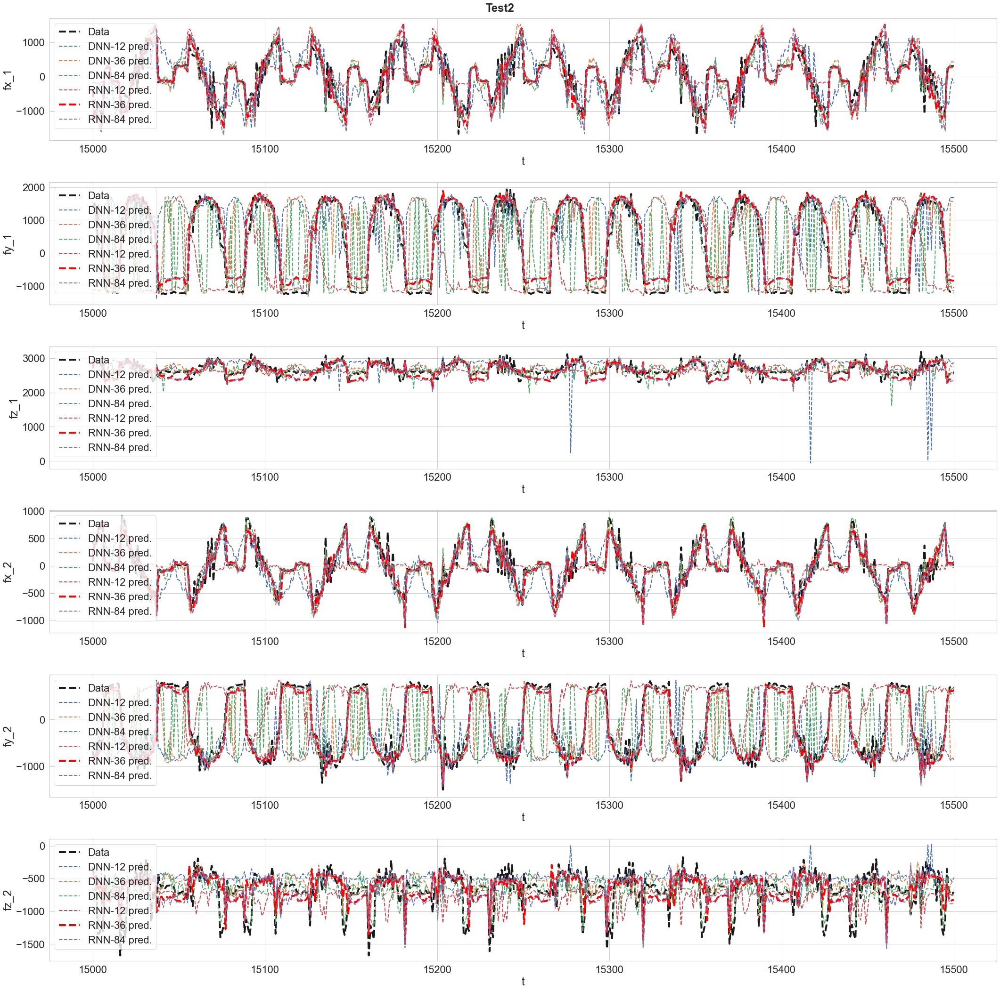

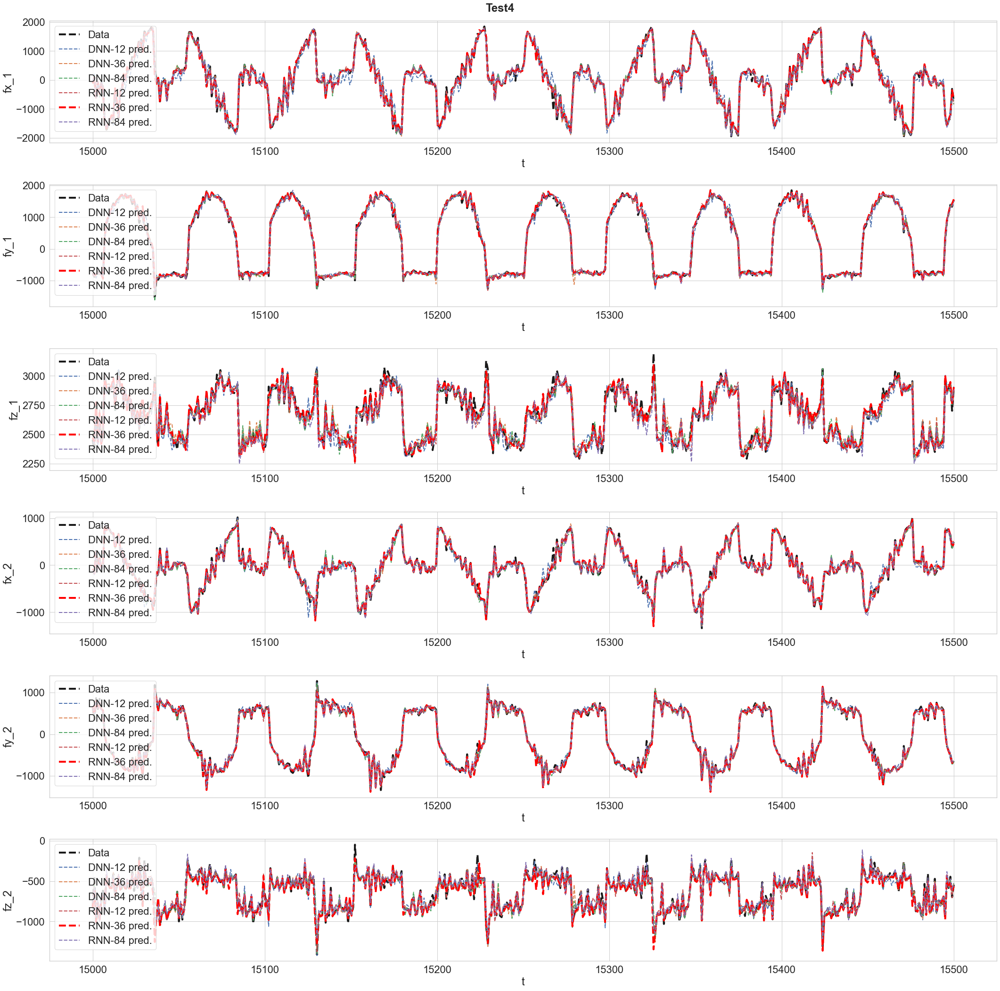

In [117]:
plot_timeseries(tmin=15000, tmax=15500)

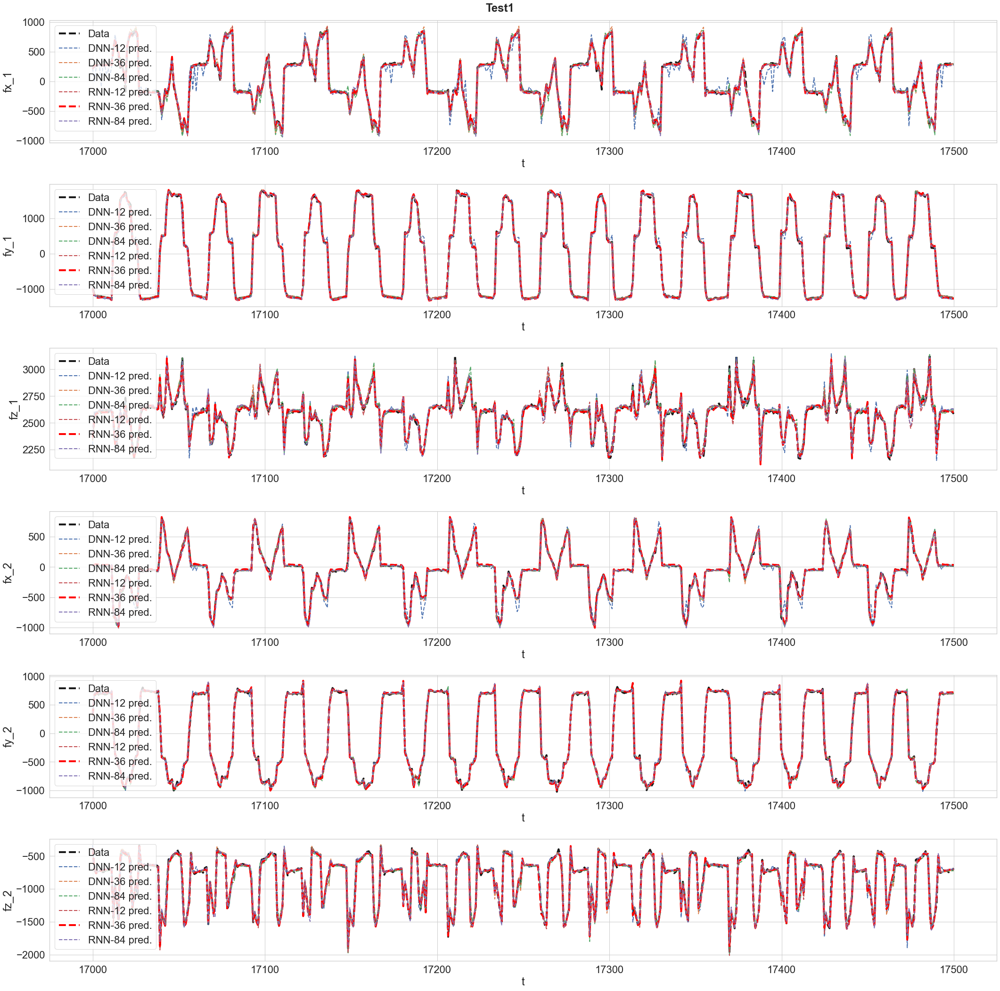

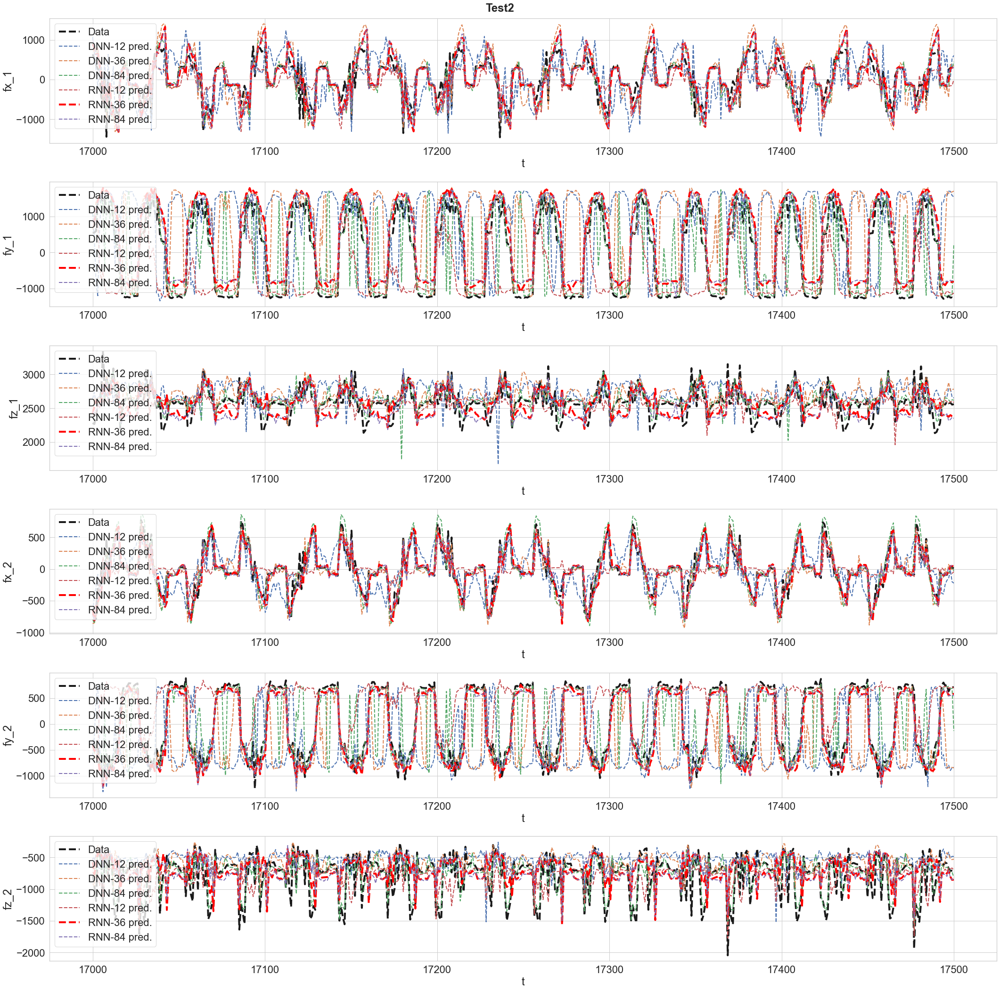

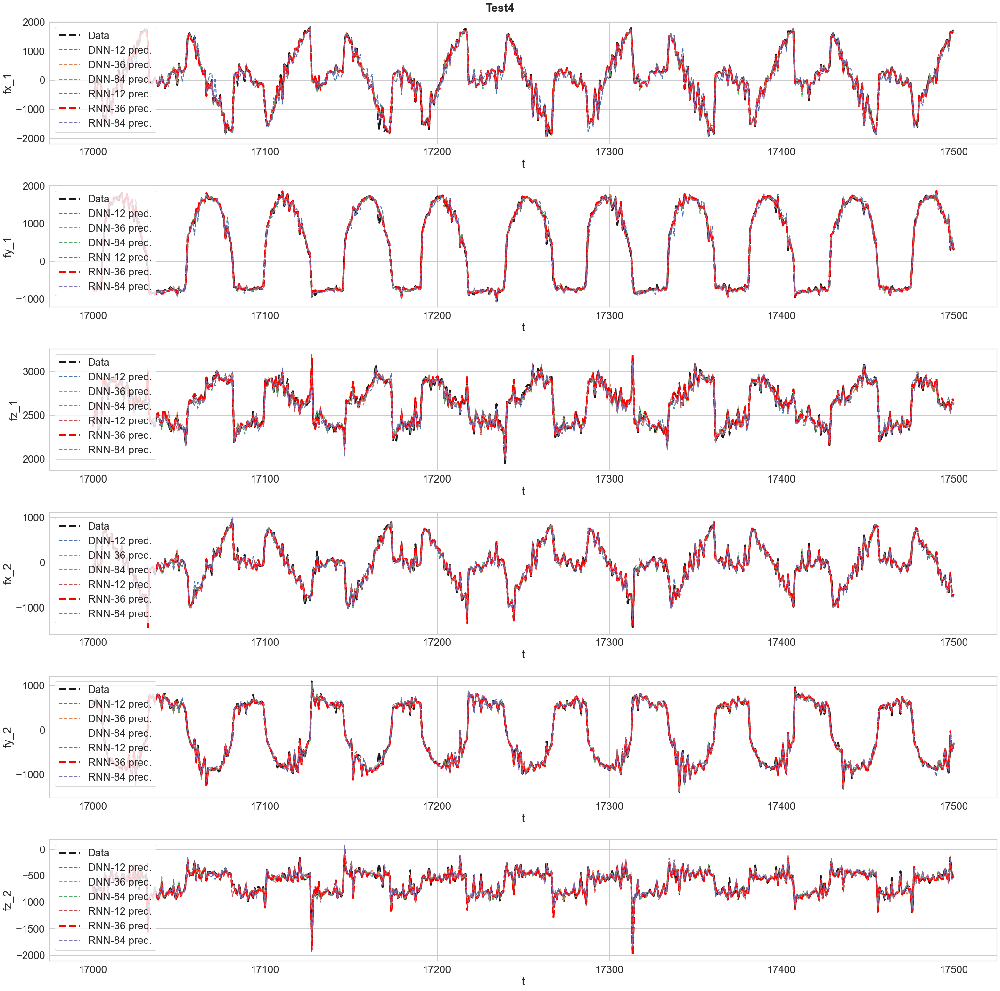

In [118]:
plot_timeseries(tmin=17000, tmax=17500)

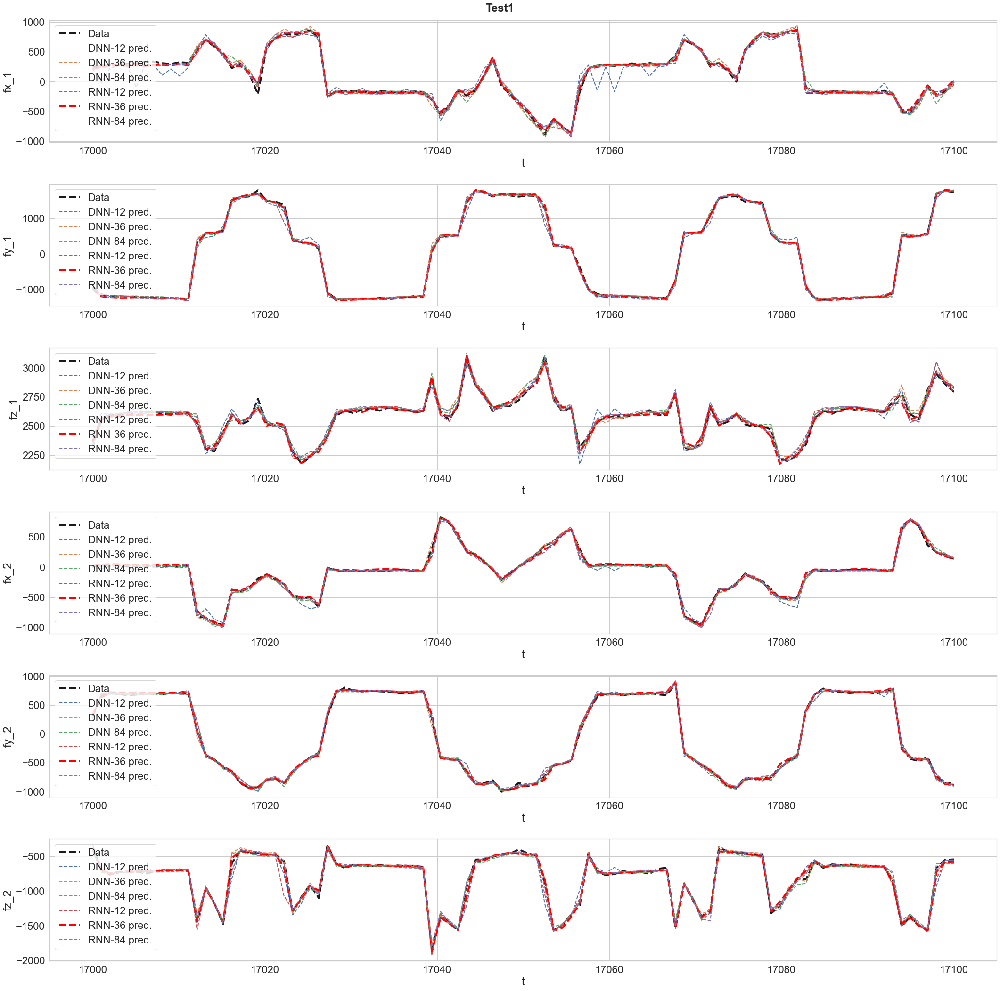

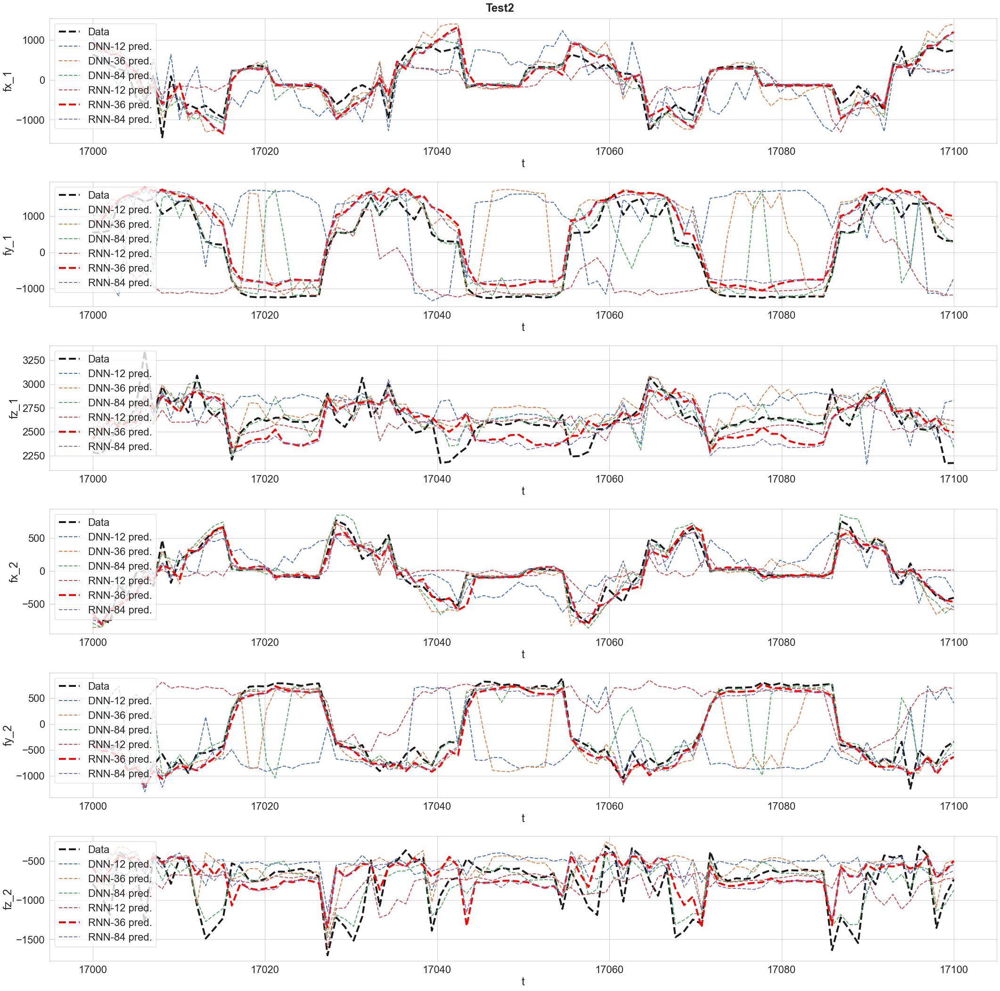

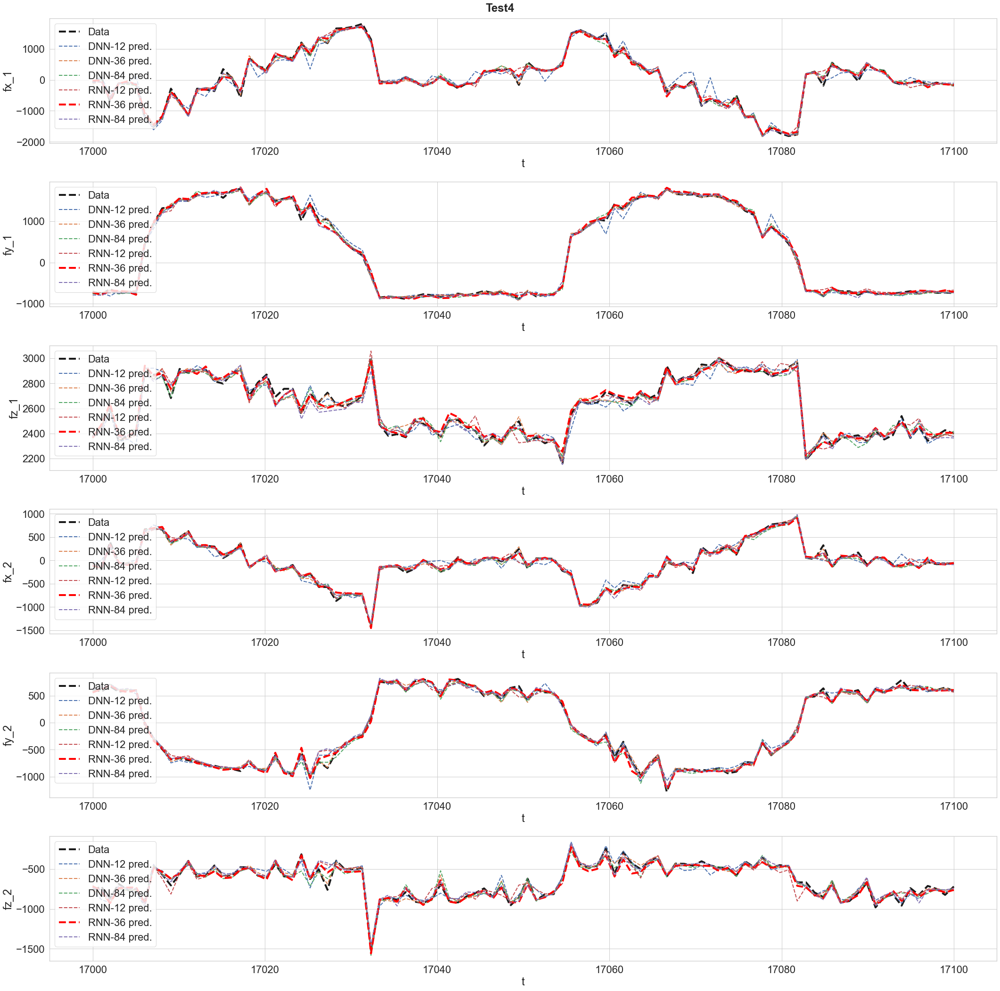

In [123]:
plot_timeseries(tmin=17000, tmax=17100)

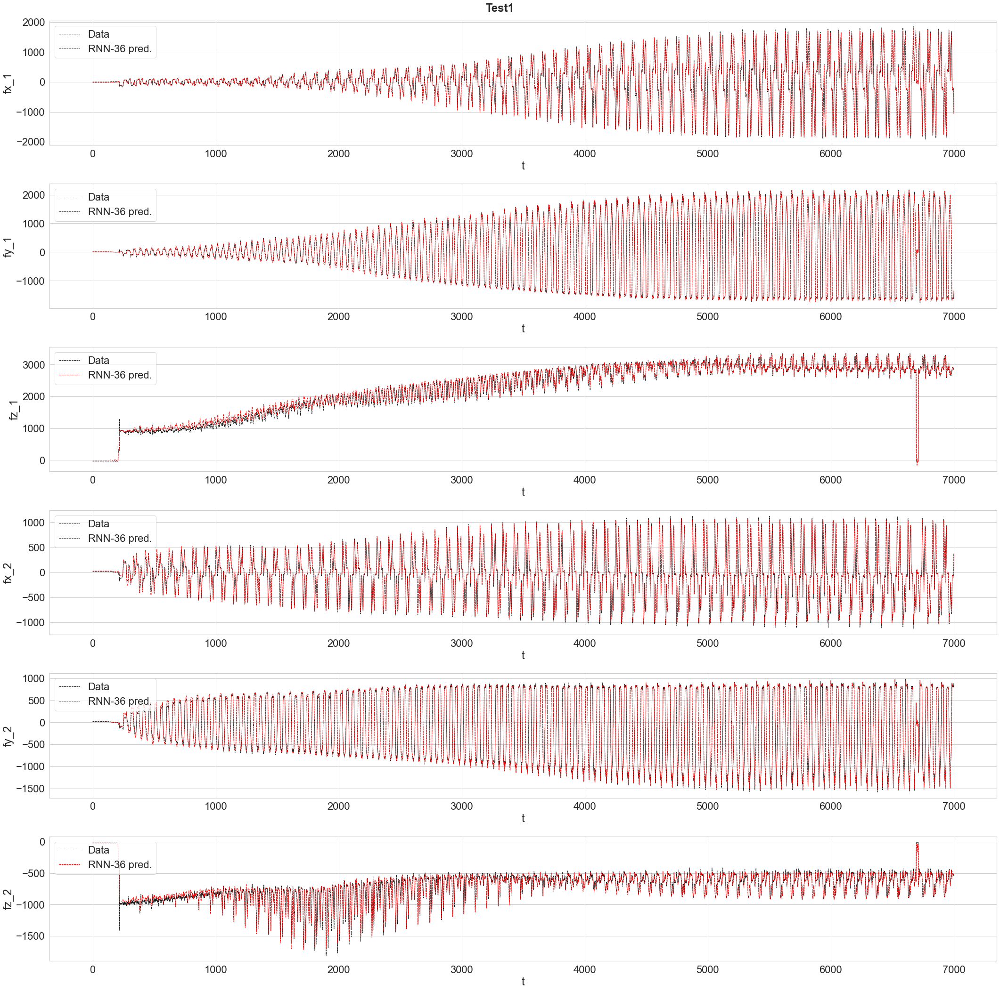

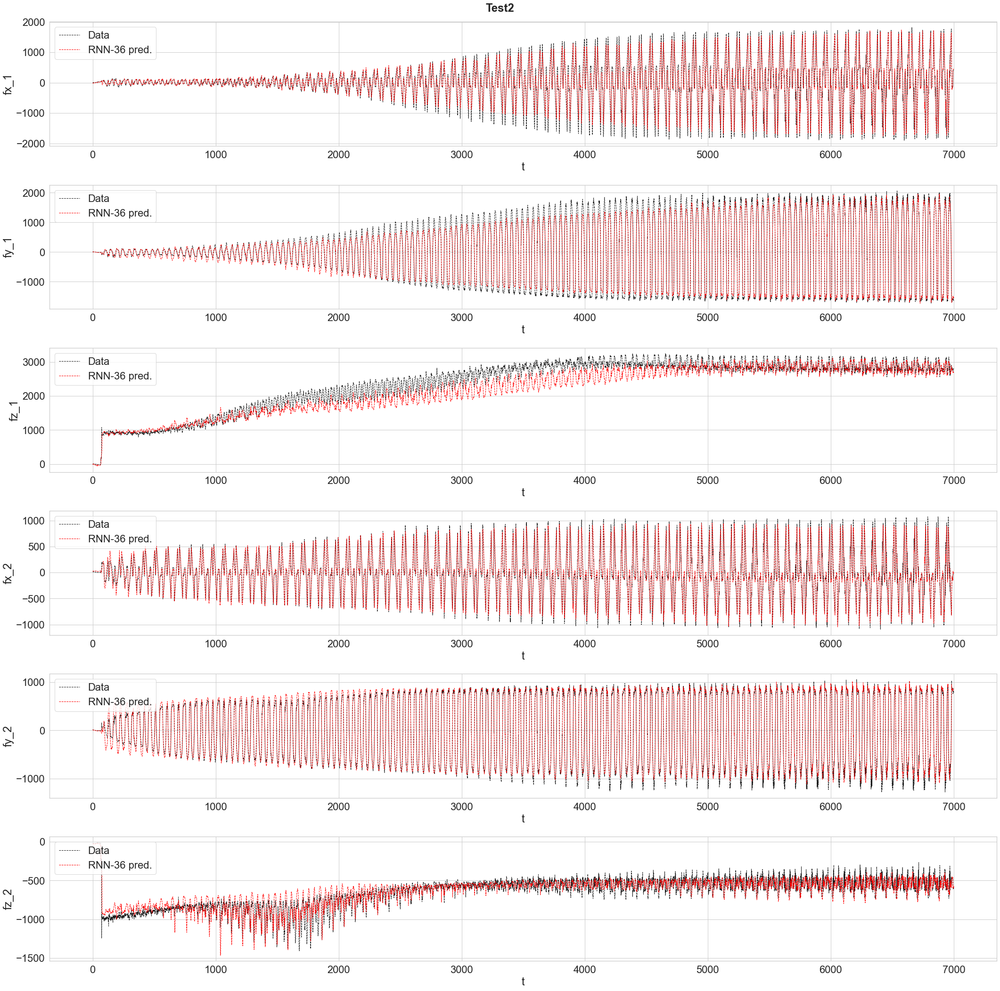

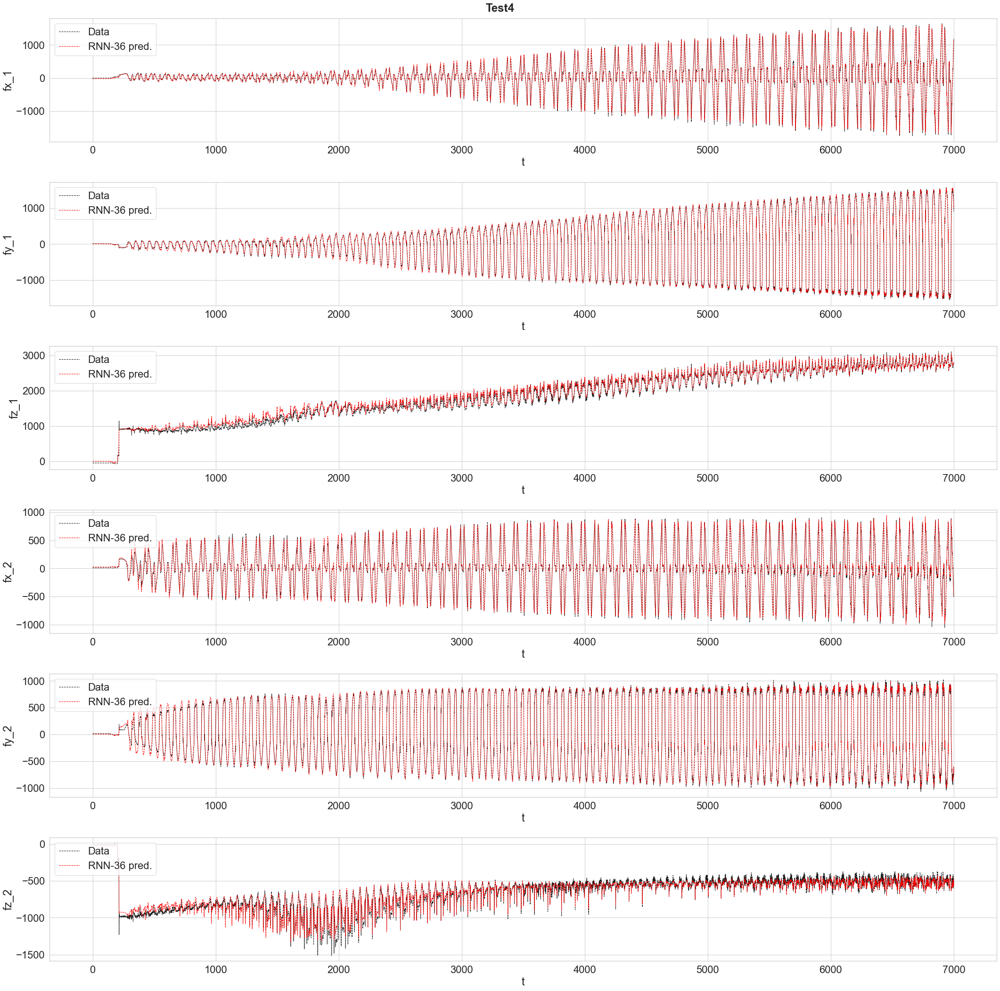

In [177]:
# plot large range for best model
tmin = 0
tmax = 7000
t = np.linspace(tmin, tmax, tmax-tmin)
sns.set(font_scale = 2)
sns.color_palette()
sns.set_style("whitegrid")
linewidth=1
for filename in dataset_filenames:

    fig = plt.figure(figsize=(30,30))
    fig.suptitle(filename, weight='bold').set_fontsize('24')
    for i in range(6):
        ax = fig.add_subplot(6, 1, i+1)
        ax.plot(t, tests_12[filename]['Y'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='Data', linestyle='dashed', linewidth=linewidth, color='k')
        #ax.plot(t, tests_12[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-12 pred.', linestyle='dashed', linewidth=linewidth)
        #ax.plot(t, tests_36[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-36 pred.', linestyle='dashed', linewidth=linewidth)
        #ax.plot(t, tests_84[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-84 pred.', linestyle='dashed', linewidth=linewidth)
        #ax.plot(t, tests_12[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-12 pred.', linestyle='dashed', linewidth=linewidth)
        ax.plot(t, tests_36[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-36 pred.', linestyle='dashed', linewidth=linewidth, color='red')
        #ax.plot(t, tests_84[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-84 pred.', linestyle='dashed', linewidth=linewidth)
        ax.set_xlabel('t')
        ax.set_ylabel(outputs[i])
        ax.legend(loc=2)
    plt.tight_layout()
    plt.savefig(output_dir/'{}_timeseries_t{}to{}.pdf'.format(filename, tmin, tmax))

# 6. Summary and prospects

Six neural networks (three DNNs and three RNNs) were trained to predict tool-tip forces from input positions and angles (and their higher-order derivatives). The models were trained on 70% of the combined Test1 and Test4 datasets. Test2 was left out of the training entirely to evaluate the performance of the models on unseen runs of the robots. 

The RNN models clearly outperformed the DNN models. This is especially clear from looking at the predicted tool-tip forces as a function of time for the Test2 dataset (unseen during training) above.

Adding the first-order (velocity) and second-order (acceleration) derivatives of the positions and angles as additional input features reduced the loss and significantly improved performance. Adding up to 6th order derivatives seemed helpful in some earlier DNN models (with fewer layers) that I trained (not shown in this notebook). However, the performance comparisons between DNN-84 and DNN-36 in this notebook indicate that the impact is marginal.

Although the RNN did a decent job, all models struggled in generalizing to Test2. A more comprehensive hyperparameter optimization could be done to improve the performance. Adding training data from more runs with robots would probably help a lot. 

You would probably want to further optimize and tailor the model to the application. A deeper (and recurrent) model will likely perform better if the goal is to achieve optimal accuracy. However, if the goal is to run fast inference on resource-constrained hardware, you'd want to optimize a smaller model that is *good enough* for the job. 